In [1]:
import numpy as np
import pickle
import h5py
import matplotlib.pyplot as plt
import os
import seaborn as sns
import matplotlib as mpl
from matplotlib.lines import Line2D
import matplotlib.patches as patches
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib.animation import FuncAnimation
import matplotlib.patheffects as pe
import matplotlib
import scipy as sci
from IPython.display import HTML
from sklearn.metrics import mean_squared_error
from matplotlib.gridspec import GridSpec
import cmasher as cmr
from numpy.polynomial import polynomial as P
import matplotlib.ticker as tck
mpl.rcParams['figure.dpi'] = 100
sns.set_theme()
plt.rcParams.update({'figure.max_open_warning': 0})

# COLOR STUFF

In [2]:
vmx_a=.7
vmn_a=.1

In [3]:
iva_colors_HEX = ["#410d00","#831901","#983e00","#b56601","#ab8437",
              "#b29f74","#7f816b","#587571","#596c72","#454f51"]
#Transform the HEX colors to RGB.
from PIL import ImageColor
iva_colors_RGB = np.zeros((np.size(iva_colors_HEX),3),dtype='int')
for i in range(0,np.size(iva_colors_HEX)):
    iva_colors_RGB[i,:] = ImageColor.getcolor(iva_colors_HEX[i], "RGB")
iva_colors_RGB = iva_colors_RGB[:,:]/(256)
colors = iva_colors_RGB.tolist()
#----------------------------------------------------
from matplotlib.colors import LinearSegmentedColormap,ListedColormap
inbetween_color_amount = 10
newcolvals = np.zeros(shape=(10 * (inbetween_color_amount) - (inbetween_color_amount - 1), 3))
newcolvals[0] = colors[0]
for i, (rgba1, rgba2) in enumerate(zip(colors[:-1], np.roll(colors, -1, axis=0)[:-1])):
    for j, (p1, p2) in enumerate(zip(rgba1, rgba2)):
        flow = np.linspace(p1, p2, (inbetween_color_amount + 1))
        # discard first 1 since we already have it from previous iteration
        flow = flow[1:]
        newcolvals[ i * (inbetween_color_amount) + 1 : (i + 1) * (inbetween_color_amount) + 1, j] = flow
newcolvals
cmap_ani = ListedColormap(newcolvals, name='from_list', N=None)

In [4]:
def cani_norm(x):
    try:
        x_=x.copy()
        x_[x_<vmn_a]=vmn_a
        x_[x_>vmx_a]=vmx_a
    except:
        x_=x.copy()
        if x_>vmx_a:
            x_=vmx_a
        elif x_<vmn_a:
            x_=vmn_a
    
    x_=(x_-vmn_a)/(vmx_a-vmn_a)
    return cmap_ani(x_)
        

In [5]:
indir='/home/tsw35/soteria/neon_advanced/qaqc_data/'
#NEON_TW_S_CO2.h5
#NEON_TW_S_H2O.h5
#NEON_TW_S_UVWT.h5
#NEON_TW_U_CO2.h5
#NEON_TW_U_H2O.h5
#NEON_TW_U_UVWT.h5

In [248]:
fp=h5py.File(indir+'NEON_TW_U_UVWT.h5','r')
len(fp['TIME'][:])

1310454

In [ ]:
fp['LE']

In [252]:
def binplot1d(xx,yy,ani,xbins,anibins=np.array([-.05,.05,.15,.25,.35,.45,.55,.65,.75,.85]),mincnt=10):
    xplot=(xbins[0:-1]+xbins[1:])/2
    yplot=np.zeros((len(anibins)-1,len(xplot)))
    aniplot=(anibins[0:-1]+anibins[1:])/2
    for i in range(len(anibins)-1):
        for j in range(len(xbins)-1):
            pnts=yy[(ani>=anibins[i])&(ani<anibins[i+1])&(xx>=xbins[j])&(xx<xbins[j+1])]
            if len(pnts)<mincnt:
                yplot[i,j]=float('nan')
            else:
                yplot[i,j]=np.nanmedian(pnts)
    return xplot,yplot,aniplot

In [249]:
sigu=np.sqrt(fp['UU'][:])
sigv=np.sqrt(fp['VV'][:])
sigw=np.sqrt(fp['WW'][:])
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]

Text(0.5, 1.0, '')

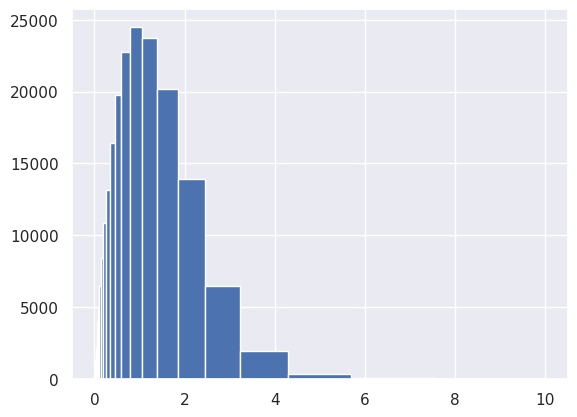

In [21]:
plt.hist(np.log(-zzd/lmost),bins=np.logspace(-5,1))
plt.title('')

In [253]:
xplt,yplt,aplt=binplot1d(zzd/lmost,sigu/ustar,ani,-(np.logspace(-4,2,21)[-1:0:-1]),np.linspace(vmn_a,vmx_a,11),mincnt=50)

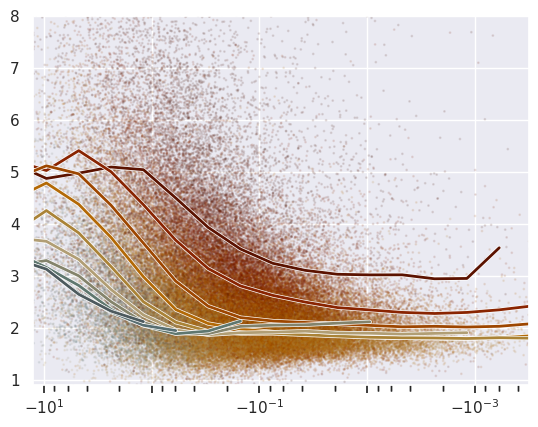

In [258]:
xplt,yplt,aplt=binplot1d(zzd/lmost,sigu/ustar,ani,-(np.logspace(-4,2,21)[-1:0:-1]),np.linspace(vmn_a,vmx_a,11),mincnt=50)
xx=-(zzd/lmost)
yy=(sigu/ustar)
cc=cani_norm(ani)
m=np.zeros((len(cc),))
m[0:100000]=1
np.random.shuffle(m)
m=m.astype(bool)
plt.scatter(xx[m],yy[m],color=cc[m],s=1,alpha=.1)

for i in range(yplt.shape[0]):
    plt.semilogx(-xplt,yplt[i,:],color=cani_norm(aplt[i]),linewidth=2,path_effects=[pe.Stroke(linewidth=3, foreground='w'), pe.Normal()])

ax=plt.gca()
ax.tick_params(which="both", bottom=True)
locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
ax.xaxis.set_minor_locator(locmin)
ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
ax.set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
ax.set_xlim(10**(-3.5),10**(1.1))
plt.ylim(0.9,8)
plt.gca().invert_xaxis()
#plt.legend(aplt)

In [58]:
fp.close()

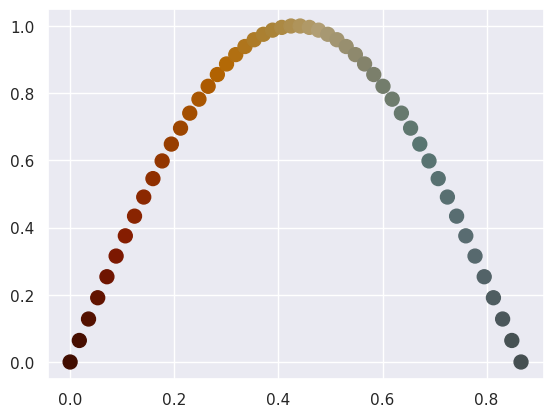

In [72]:
x=np.linspace(0,np.sqrt(3)/2,50)
y=np.sin(x*np.pi/np.sqrt(3)*2)
plt.scatter(x,y,c=x,cmap=cmap,norm=mpl.colors.Normalize(vmin=0,vmax=np.sqrt(3)/2),s=100)

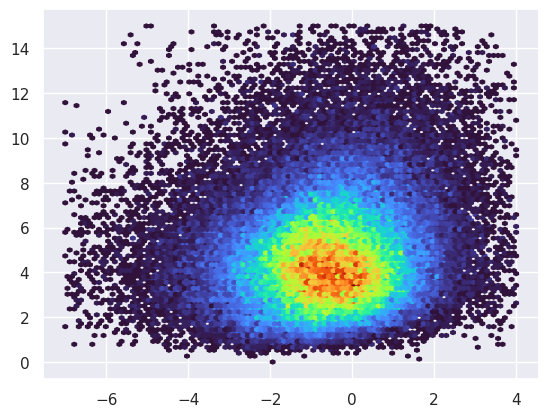

In [147]:
m=(ani<.1)&(ani>0)
xx=np.log(-(zzd/lmost)[m])
yy=(sigu/ustar)[m]
plt.hexbin(xx,yy,cmap='turbo',bins=400,mincnt=1,extent=(-7,4,0,15))

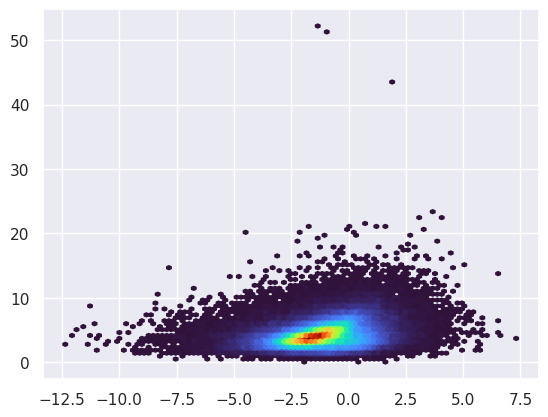

In [128]:
m=(ani<.15)&(ani>.05)
xx=np.log(-(zzd/lmost)[m])
yy=(sigu/ustar)[m]
plt.hexbin(xx,yy,cmap='turbo',bins=400,mincnt=1)#,extent=(-7,4,0,10))

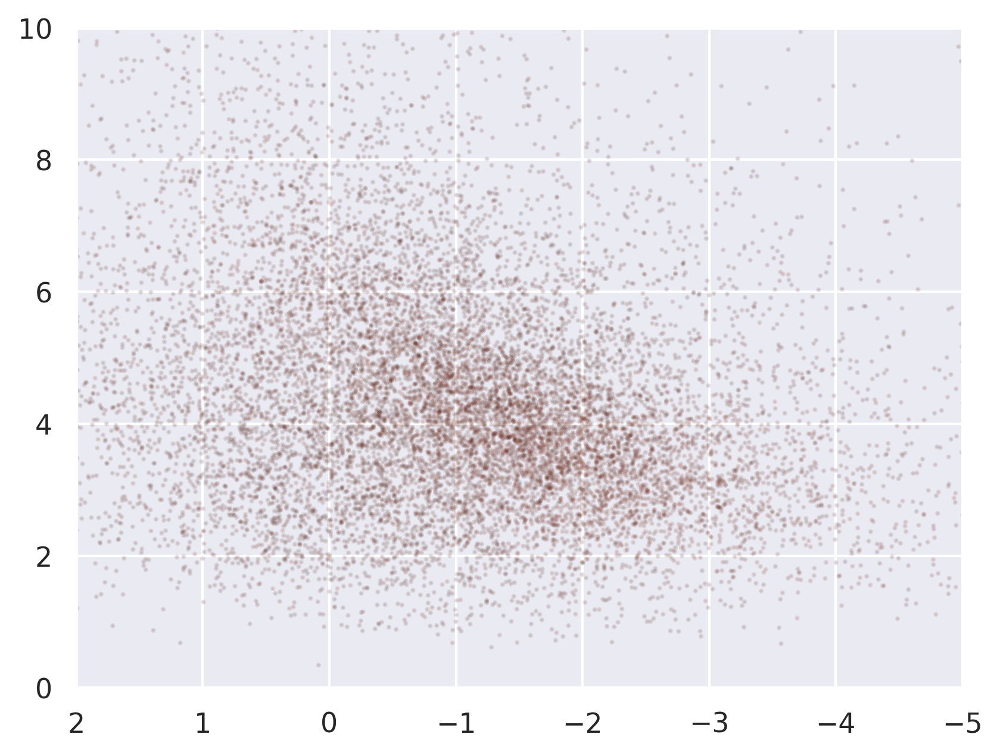

In [35]:
plt.figure(dpi=300)
xx=np.log(-(zzd/lmost))
yy=(sigu/ustar)
cc=cani_norm(ani)
m=np.zeros((len(cc),))
m[0:100000]=1
np.random.shuffle(m)
m=m.astype(bool)
m=m&(ani<.15)
plt.scatter(xx[m],yy[m],color=cc[m],s=1,alpha=.1)
plt.ylim(0,10)
plt.xlim(-5,2)
plt.gca().invert_xaxis()

(array([ 3657.,  4629.,  5555.,  7031.,  8440., 10304., 12166., 14999.,
        17849., 21299., 25241., 29857., 34459., 40236., 44919., 50393.,
        54643., 57890., 59249., 61087., 61745., 61301., 60962., 59528.,
        58969., 56529., 53645., 49150., 44450., 39816., 34636., 29480.,
        25217., 20997., 17134., 13919., 11032.,  8554.,  6681.,  5331.,
         3793.,  2800.,  2087.,  1454.,  1056.,   756.,   519.,   394.,
          266.]),
 array([-6.        , -5.79591837, -5.59183673, -5.3877551 , -5.18367347,
        -4.97959184, -4.7755102 , -4.57142857, -4.36734694, -4.16326531,
        -3.95918367, -3.75510204, -3.55102041, -3.34693878, -3.14285714,
        -2.93877551, -2.73469388, -2.53061224, -2.32653061, -2.12244898,
        -1.91836735, -1.71428571, -1.51020408, -1.30612245, -1.10204082,
        -0.89795918, -0.69387755, -0.48979592, -0.28571429, -0.08163265,
         0.12244898,  0.32653061,  0.53061224,  0.73469388,  0.93877551,
         1.14285714,  1.34693878,  1.55

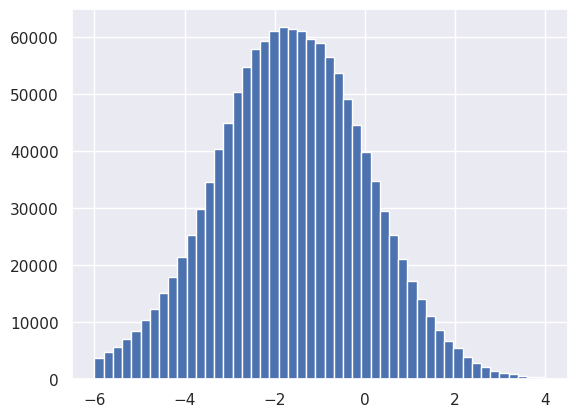

In [43]:
plt.hist(np.log(-(zzd/lmost)),bins=np.linspace(-6,4))

In [138]:
fpu=h5py.File(indir+'NEON_TW_U_UVWT.h5','r')
fps=h5py.File(indir+'NEON_TW_S_UVWT.h5','r')
ani_s=fps['ANI_YB'][:]
ani_u=fpu['ANI_YB'][:]

Text(0.5, 1.0, '')

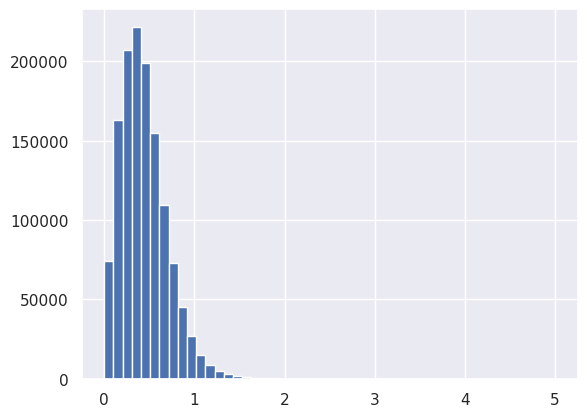

In [143]:
plt.hist(fpu['USTAR'][:],bins=np.linspace(0,5))
plt.title('')

Text(0.5, 1.0, '')

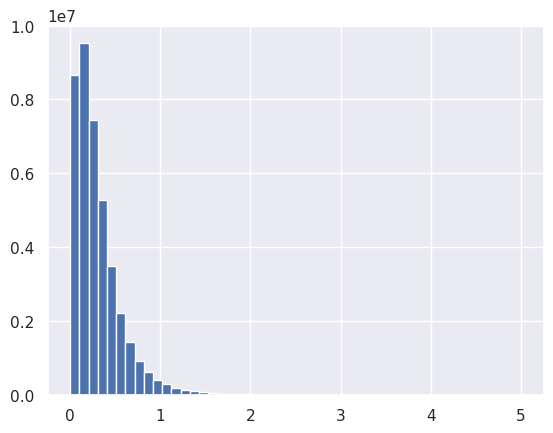

In [144]:
plt.hist(fps['USTAR'][:],bins=np.linspace(0,5))
plt.title('')

In [6]:
np.sum((ani_s<0)|(ani_s>(np.sqrt(3)/2)))

0

Text(0.5, 1.0, '')

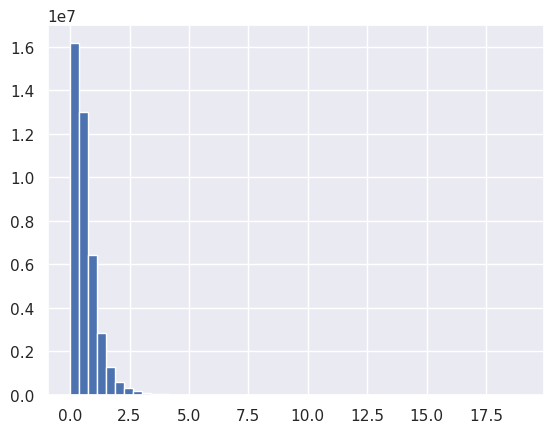

In [75]:
plt.hist(fps['VV'][:],bins=50)
plt.title('')

In [77]:
np.log10(10)

1.0

In [89]:
m=(('ABBY'.encode('UTF-8'))==fpu['SITE'][:])

In [90]:
np.sum(m)

27931

In [145]:
(3/2)**2

2.25

# First Figure

In [14]:
d_unst=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_unst_v2.p','rb'))
d_stbl=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_stbl_v2.p','rb'))
d_ani_ust=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_ani_ust_v2.p','rb'))
d_ani_stb=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_ani_stb_v2.p','rb'))

In [10]:
d_unst.keys()

dict_keys(['U', 'V', 'W', 'T', 'H2O', 'CO2'])

In [13]:
d_stbl['U'].keys()

dict_keys(['phi', 'zL', 'ani', 'p_phi', 'p_zL', 'p_cnt', 'SS', 'SSlo', 'SShi', 'SS_s', 'SSlo_s', 'SShi_s'])

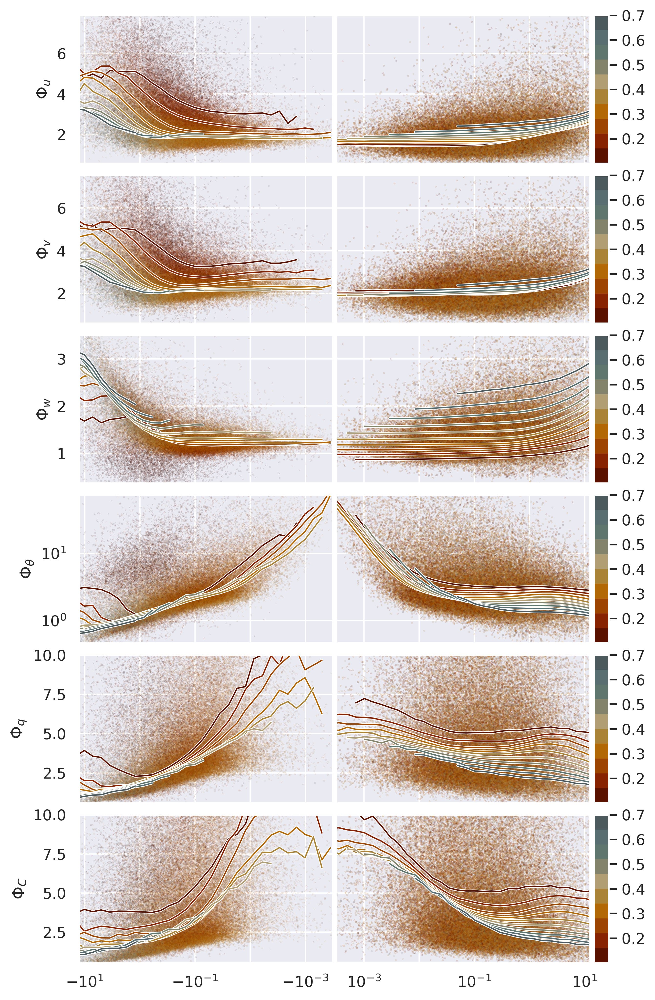

In [595]:
sz=1.4
fig,axs=plt.subplots(6,3,figsize=(5*sz,9*sz),gridspec_kw={'width_ratios': [1,1,.06]},dpi=400)
ss=.1
alph=.2
minpct=1e-04

anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

j=0
for v in d_unst.keys():
    # SETUP
    cc=cani_norm(d_unst[v]['ani'][:])
    cc_s=cani_norm(d_stbl[v]['ani'][:])
    phi=d_unst[v]['phi']
    phi_s=d_stbl[v]['phi']
    
    ymin=min(np.nanpercentile(phi,.1),np.nanpercentile(phi_s,.1))
    ymax=max(np.nanpercentile(phi,99),np.nanpercentile(phi_s,99))
    if v in ['H2O','CO2']:
        ymax=10
    
    ##### UNSTABLE #####
    # SCATTER UNSTABLE
    axs[j,0].scatter(-d_unst[v]['zL'][:],phi,color=cc,s=ss,alpha=alph,marker=".")
    
    # LINES UNSTABLE
    xplt=d_unst[v]['p_zL']
    yplt=d_unst[v]['p_phi']
    cnt=d_unst[v]['p_cnt']
    tot=np.sum(cnt)
    yplt[cnt/tot<minpct]=float('nan')
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,0].semilogx(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,0].loglog(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    
    # LABELING
    locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
    axs[j,0].xaxis.set_minor_locator(locmin)
    axs[j,0].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if j==5:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    else:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    #axs[j,0].xaxis.set_minor_locator(tck.AutoMinorLocator())
    axs[j,0].set_ylabel(ylabels[j])
    axs[j,0].set_ylim(ymin,ymax)
    axs[j,0].invert_xaxis()
    
    ##### STABLE #####
    # SCATTER STABLE
    axs[j,1].scatter(d_stbl[v]['zL'][:],phi_s,color=cc,s=ss,alpha=alph,marker=".")
    
    # LINES STABLE
    xplt=d_stbl[v]['p_zL']
    yplt=d_stbl[v]['p_phi']
    cnt=d_stbl[v]['p_cnt']
    tot=np.sum(cnt)
    yplt[cnt/tot<minpct]=float('nan')
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,1].semilogx(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,1].loglog(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    
    # LABELING
    if j==5:
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$10^{-3}$','',r'$10^{-1}$','',r'$10^{1}$'])
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    else:
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    axs[j,1].tick_params(labelleft=False)
    #axs[j,1].grid(False)
    #axs[j,1].xaxis.grid(True, which='minor')
    axs[j,1].set_ylim(ymin,ymax)
    
    
    #### COLORBAR ####
    axs[j,2].imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
    axs[j,2].set_xticks([],[])
    inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
    inta.extend(anilvl)
    inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
    xtc=np.interp([.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
    axs[j,2].set_yticks(xtc,[.2,.3,.4,.5,.6,.7])
    axs[j,2].grid(False)
    #plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
    axs[j,2].yaxis.tick_right()
    
    j=j+1

plt.subplots_adjust(hspace=.08,wspace=.02)

(0.0, 10.0)

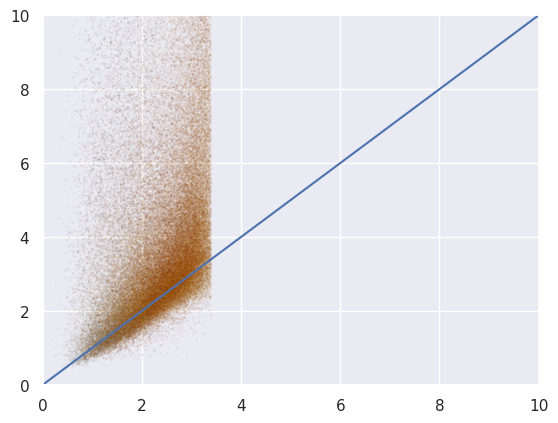

In [67]:
sz=1.4
ss=.1
alph=.2
minpct=1e-04
v='H2O'
cc=cani_norm(d_unst[v]['ani'][:])
phi=d_unst[v]['phi']
plt.scatter(3.4*(1-9.5*d_unst[v]['zL'][:])**(-1/3),phi,color=cc,s=ss,alpha=alph,marker=".")
plt.plot([-1,11],[-1,11])
plt.ylim(0,10)
plt.xlim(0,10)

(0.0, 10.0)

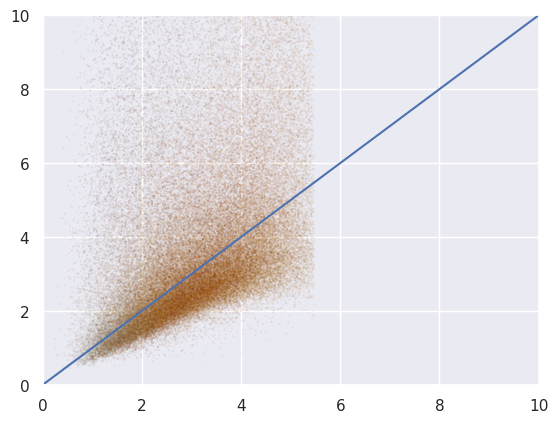

In [68]:
sz=1.4
ss=.1
alph=.2
minpct=1e-04
v='H2O'
cc=cani_norm(d_unst[v]['ani'][:])
phi=d_unst[v]['phi']
plt.scatter(np.sqrt(30)*(1-25*d_unst[v]['zL'][:])**(-1/3),phi,color=cc,s=ss,alpha=alph,marker=".")
plt.plot([-1,11],[-1,11])
plt.ylim(0,10)
plt.xlim(0,10)

In [28]:
a=np.array([1,2,2,1,2,3,1,5,2,10,6,5,9,3,6,2,3,4,3,2,3,5,3,2,4,6,3,4,5,3,2,6,2,7,2,1])

In [29]:
print(np.std(a))
print(np.std(a*3))
print(np.std(a)*3)

2.163815788238938
6.491447364716815
6.491447364716814


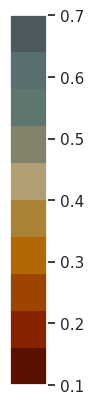

In [103]:
plt.imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
plt.xticks([],[])
inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
inta.extend(anilvl)
inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
xtc=np.interp([.1,.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
plt.yticks(xtc,[.1,.2,.3,.4,.5,.6,.7])
plt.grid(False)
#plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
plt.gca().yaxis.tick_right()

In [100]:
xtc

array([0.        , 1.16666667, 2.83333333, 4.5       , 6.16666667,
       7.83333333, 9.        ])

Text(0.5, 1.0, '')

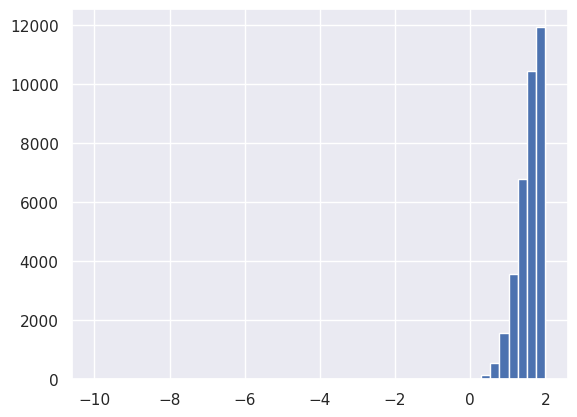

In [150]:
plt.hist(d_stbl['T']['phi'][:],bins=np.linspace(-10,2))
plt.title('')

Text(0.5, 1.0, '')

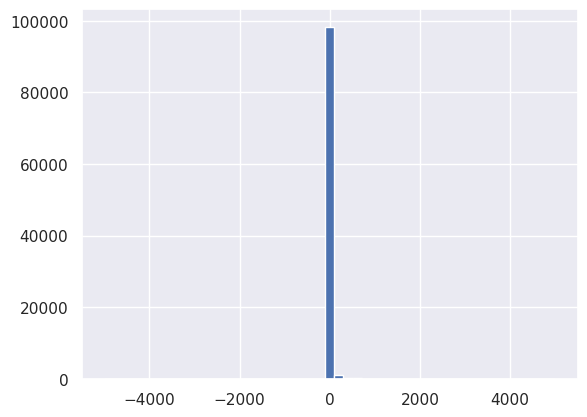

In [151]:
plt.hist(d_stbl['H2O']['phi'][:],bins=np.linspace(-5000,5000))
plt.title('')

Text(0.5, 1.0, '')

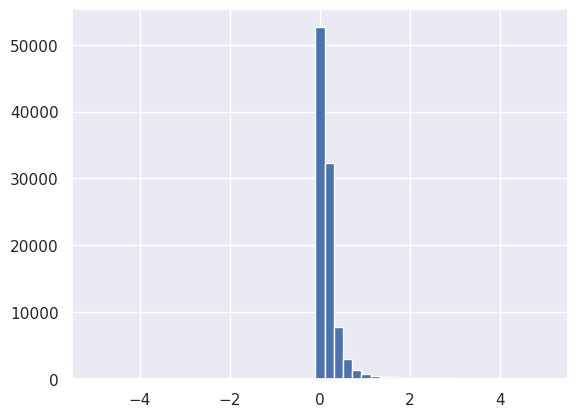

In [152]:
plt.hist(d_unst['CO2']['phi'][:],bins=np.linspace(-5,5))
plt.title('')

In [126]:
np.nanmedian(np.abs(d_unst['CO2']['phi'][:]))

0.09479664277159641

In [64]:
np.logspace(-5,-4,5)

array([1.00000000e-05, 1.77827941e-05, 3.16227766e-05, 5.62341325e-05,
       1.00000000e-04])

In [80]:
np.sum(d_stbl['CO2']['phi']<0)/len(d_stbl['CO2']['phi'])

0.14458

# Stiperski Curves/MOST

In [410]:
zL_u=-np.logspace(-4,2,40)
zL=zL_u.copy()
zL=zL.reshape(1,40).repeat(10,0)

ani=anilvl.copy()
ani=ani.reshape(10,1).repeat(40,1)

# U Unstable
a=.784-2.582*np.log10(ani)
u_u_stp=a*(1-3*zL)**(1/3)
u_u_old=2.55*(1-3*zL)**(1/3)

# V Unstable
a=.725-2.702*np.log10(ani)
v_u_stp=a*(1-3*zL)**(1/3)
v_u_old=2.05*(1-3*zL)**(1/3)

# W Unstable 
a=1.119-0.019*ani-.065*ani**2+0.028*ani**3
w_u_stp=a*(1-3*zL)**(1/3)
w_u_old=1.35*(1-3*zL)**(1/3)

# T Unstable
a=0.017+0.217*ani
t_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
t_u_old=.99*(.067-zL)**(-1/3)
t_u_old[zL>-0.05]=.015*(-zL[zL>-0.05])**(-1)+1.76

# H2O Unstable 
a=0.017+0.217*ani
h_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
h_u_old=.99*(.067-zL)**(-1/3)
h_u_old[zL>-0.05]=.15*(-zL[zL>-0.05])**(-1)+1.76

# CO2 Unstable
a=0.017+0.217*ani
c_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
c_u_old=.99*(.067-zL)**(-1/3)
c_u_old[zL>-0.05]=.15*(-zL[zL>-0.05])**(-1)+1.76

############### STABLE ##################
zL_s=np.logspace(-4,2,40)
zL=zL_s.copy()
zL=zL.reshape(1,40).repeat(10,0)

# U Stable
a_=np.array([2.332,-2.047,2.672])
c_=np.array([.255,-1.76,5.6,-6.8,2.65])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
u_s_stp=a*(1+3*zL)**(c)
u_s_old=2.06*np.ones(zL.shape)
print('Ustb')
print(np.mean(a))
print(np.mean(c))

# V Stable
a_=np.array([2.385,-2.781,3.771])
c_=np.array([.654,-6.282,21.975,-31.634,16.251])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
v_s_stp=a*(1+3*zL)**(c)
v_s_old=2.06*np.ones(zL.shape)
print('Vstb')
print(np.mean(a))
print(np.mean(c))


# W Stable
a_=np.array([.953,.188,2.243])
c_=np.array([.208,-1.935,6.183,-7.485,3.077])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
w_s_stp=a*(1+3*zL)**(c)
w_s_old=1.6*np.ones(zL.shape)
print('Wstb')
print(np.mean(a))
print(np.mean(c))


# T Stable
a_=[.607,-.754]
b_=[-.353,3.374,-8.544,6.297]
c_=[0.195,-1.857,5.042,-3.874]
d_=[.0763,-1.004,2.836,-2.53]
#d_=[.0763,-.1004,-2.836,-2.53]
a=0
b=0
c=0
d=0
for i in range(2):
    a=a+a_[i]*ani**i
for i in range(4):
    b=b+b_[i]*ani**i
    c=c+c_[i]*ani**i
    d=d+d_[i]*ani**i
    
logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
#logphi=a+b*np.log10(zL)+c*np.log10(zL**2)+d*np.log10(zL**3)
t_s_stp=10**(logphi)
#t_s_stp=np.sqrt(10**(logphi))
t_s_old=0.00087*(zL)**(-1.4)+2.03

h_s_stp=t_s_stp
c_s_stp=t_s_stp
h_s_old=t_s_old
c_s_old=t_s_old

ust_stp=[u_u_stp,v_u_stp,w_u_stp,t_u_stp,h_u_stp,c_u_stp]
stb_stp=[u_s_stp,v_s_stp,w_s_stp,t_s_stp,h_s_stp,c_s_stp]
ust_old=[u_u_old,v_u_old,w_u_old,t_u_old,h_u_old,c_u_old]
stb_old=[u_s_old,v_s_old,w_s_old,t_s_old,h_s_old,c_s_old]

Ustb
2.0200783999999996
0.08331570169999993
Vstb
1.9879586999999999
0.06267506087800054
Wstb
1.4536971
0.03243206910599993


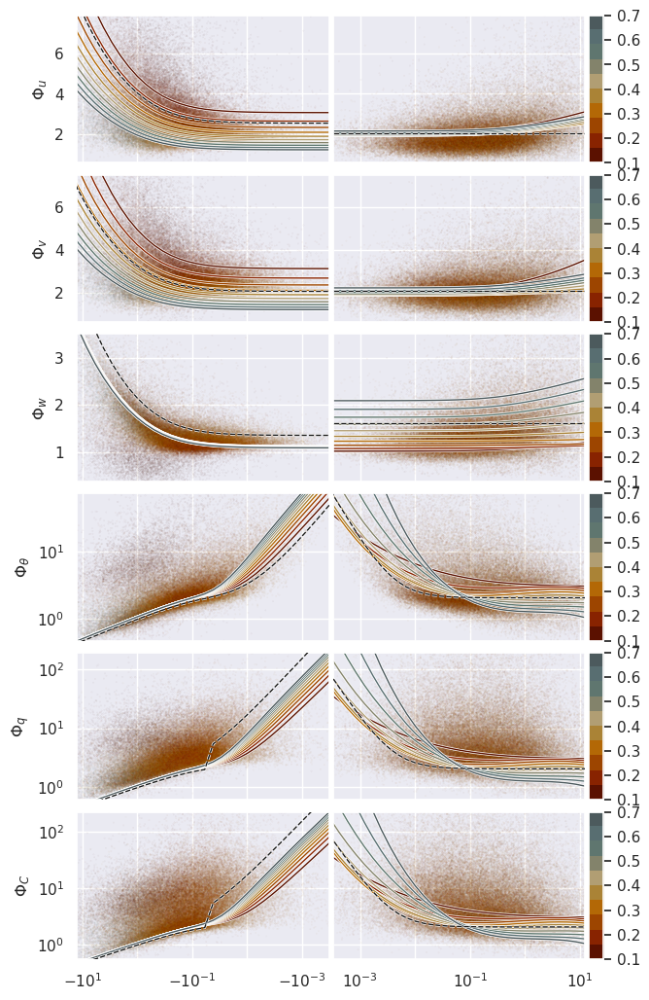

In [137]:
sz=1.4
fig,axs=plt.subplots(6,3,figsize=(5*sz,9*sz),gridspec_kw={'width_ratios': [1,1,.06]})
ss=.03
alph=.1
minpct=1e-05

anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

j=0
for v in d_unst.keys():
    # SETUP
    cc=cani_norm(d_unst[v]['ani'][:])
    cc_s=cani_norm(d_stbl[v]['ani'][:])
    phi=d_unst[v]['phi']
    phi_s=d_stbl[v]['phi']
    
    ymin=min(np.nanpercentile(phi,.1),np.nanpercentile(phi_s,.1))
    ymax=max(np.nanpercentile(phi,99),np.nanpercentile(phi_s,99))
    
    ##### UNSTABLE #####
    # SCATTER UNSTABLE
    axs[j,0].scatter(-d_unst[v]['zL'][:],phi,color=cc,s=ss,alpha=alph)
    
    # LINES UNSTABLE
    xplt=zL_u
    yplt=ust_stp[j]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W']:
            axs[j,0].semilogx(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,0].loglog(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=ust_old[j][0]
    if v in ['U','V','W']:
        axs[j,0].semilogx(-xplt,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,0].loglog(-xplt,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
    axs[j,0].xaxis.set_minor_locator(locmin)
    axs[j,0].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if j==5:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    else:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    #axs[j,0].xaxis.set_minor_locator(tck.AutoMinorLocator())
    axs[j,0].set_ylabel(ylabels[j])
    axs[j,0].set_ylim(ymin,ymax)
    axs[j,0].invert_xaxis()
    
    ##### STABLE #####
    # SCATTER STABLE
    axs[j,1].scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
    
    # LINES STABLE
    xplt=zL_s
    yplt=stb_stp[j]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W']:
            axs[j,1].semilogx(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,1].loglog(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=stb_old[j][0]
    if v in ['U','V','W']:
        axs[j,1].semilogx(xplt,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,1].loglog(xplt,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    if j==5:
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$10^{-3}$','',r'$10^{-1}$','',r'$10^{1}$'])
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    else:
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    axs[j,1].tick_params(labelleft=False)
    #axs[j,1].grid(False)
    #axs[j,1].xaxis.grid(True, which='minor')
    axs[j,1].set_ylim(ymin,ymax)
    
    
    #### COLORBAR ####
    axs[j,2].imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
    axs[j,2].set_xticks([],[])
    inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
    inta.extend(anilvl)
    inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
    xtc=np.interp([.1,.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
    axs[j,2].set_yticks(xtc,[.1,.2,.3,.4,.5,.6,.7])
    axs[j,2].grid(False)
    #plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
    axs[j,2].yaxis.tick_right()
    
    j=j+1

plt.subplots_adjust(hspace=.08,wspace=.02)

In [170]:
zL.shape
zL.reshape(1,40).repeat(10,0).shape

(10, 40)

In [179]:
u_u_old.shape

(10, 40)

In [168]:
ani.reshape(10,1).repeat(40,1).shape

(10, 40)

In [175]:
stb_old[1].shape

(10, 40)

In [185]:
yplt=ust_old

In [263]:
10**(5*np.log10(2.4))

79.62623999999998

In [262]:
10**(5*np.log10(2.4))*10**(-1)

7.962623999999998

In [392]:
d_=[.0763,-.1004,-2.836,-2.53]
d=0
for i in range(4):
    d=d+d_[i]*ani**i
print(d)

0.03537000000000001


In [387]:
print(a)
print(b)
print(c)
print(d)

0.5316
-0.09474299999999997
0.05584600000000001
0.14581000000000002


In [113]:
zL=-np.logspace(-4,2,40)
t_u_old=.99*(.067-zL)**(-1/3)
t_u_old[zL>-0.05]=.15*(-zL[zL>-0.05])**(-1)+1.76

1.24

In [117]:
.15*(--0.05)**(-1)-1

2.0

In [116]:
.99*(.067--0.05)**(-1/3)

2.02413701752852

# Anisotropy Analysis

In [197]:
class_names={11:'Water',12:'Snow',21:'Open Dev',22:'Low Dev',23:'Med Dev',24:'High Dev',31:'Barren',\
             41:'Decid.',42:'Everg.',43:'Mix Forest',51:'Dwarf Scrub',52:'Shrub',\
             71:'Grass',72:'AK:Sedge',73:'AK:Lichen',74:'AK:Moss',81:'Pasture',82:'Crops',90:'Wetland',95:'Herb Wet',0:'NaN'}
class_colors={11:'royalblue',12:'whitesmoke',21:'pink',22:'lightcoral',23:'red',24:'maroon',31:'silver',\
              41:'limegreen',42:'darkgreen',43:'yellowgreen',51:'darkgoldenrod',52:'tan',\
              71:'wheat',72:'khaki',73:'darkkhaki',74:'darkseagreen',81:'gold',82:'sandybrown',90:'skyblue',95:'cadetblue',0:'white'}
nlcdd={}
nlcdd['BONA']=43
nlcdd['TOOL']=51
nlcdd['BARR']=72
nlcdd['HEAL']=52
nlcdd['DEJU']=42
nlcdd['LAJA']=81
nlcdd['GUAN']=42
nlcdd['PUUM']=42

In [198]:
def nlcd_plot(d_,zb,stab,bxplt=True,nowhis=True,meansort=False):
    # Make a list of sites (remove ALL)
    sites=[]
    for site in d_.keys():
        if len(site)==4:
            sites.append(site)

    # Get Ani, nlcd, and percentiles
    ani={}
    nlcd={}
    pct75={}
    pct25={}
    for site in sites:
        if meansort:
            ani[site]=d_[site][zb][stab]['mean']
        else:
            ani[site]=d_[site][zb][stab]['median']
        pct75[site]=d_[site][zb][stab]['pct75']
        pct25[site]=d_[site][zb][stab]['pct25']
        if site in nlcdd.keys():
            nlcd[site]=nlcdd[site]
        else:
            nlcd[site]=d_[site][zb][stab]['lc']
            
    # make a list sorted by anisotropies and a flipped dictionary linking ani to site
    ani_f={}
    for k in ani.keys():
        ani_f[ani[k]]=k
    ani_sorted=list(ani_f.keys())
    ani_sorted.sort()
   
    # make empty sorted lists
    pct75_sorted=[]
    pct25_sorted=[]
    nlcd_sorted=[]
    sites_sorted=[]
    means_sorted=[]
    
    # fill sorted lists
    for k in ani_sorted:
        site=ani_f[k]
        pct75_sorted.append(pct75[site])
        pct25_sorted.append(pct25[site])
        nlcd_sorted.append(nlcd[site])
        sites_sorted.append(site)
        means_sorted.append(d_[site][zb][stab]['mean'])
    
    if bxplt:
        stats=[]
        for i in range(len(sites_sorted)):
            site=sites_sorted[i]
            min_=d_[site][zb][stab]['min']
            max_=d_[site][zb][stab]['max']
            iqr=pct75_sorted[i]-pct25_sorted[i]
            
            whishi=min(pct75_sorted[i]+iqr*1.5,max_)
            whislo=max(pct25_sorted[i]-iqr*1.5,min_)
            
            if nowhis:
                sd={'med':ani_sorted[i], 'q1':pct25_sorted[i], 'q3':pct75_sorted[i],
                'whislo':pct25_sorted[i],'whishi':pct75_sorted[i]}
            else:
                sd={'med':ani_sorted[i], 'q1':pct25_sorted[i], 'q3':pct75_sorted[i],
                'whislo':whislo,'whishi':whishi}
            stats.append(sd)
        return stats, nlcd_sorted, sites_sorted
        
    else:
        return ani_sorted, pct25_sorted, pct75_sorted, nlcd_sorted, sites_sorted


In [280]:
stats,nlcd,sites_=nlcd_plot(d_ani_ust,'yb','full')

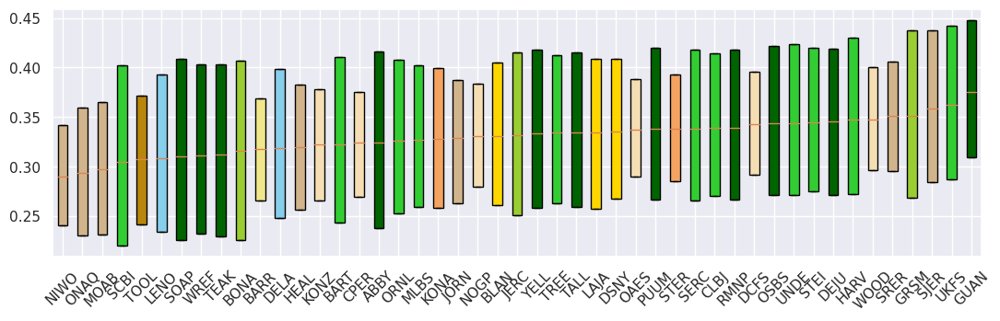

In [94]:
stats,nlcd,sites_=nlcd_plot(d_ani_ust,'yb','full')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

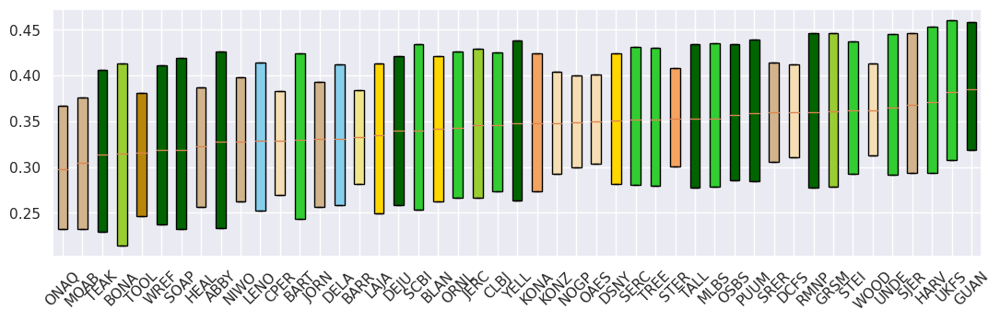

In [73]:
stats,nlcd,sites_=nlcd_plot(d_ani_ust,'yb','hi')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

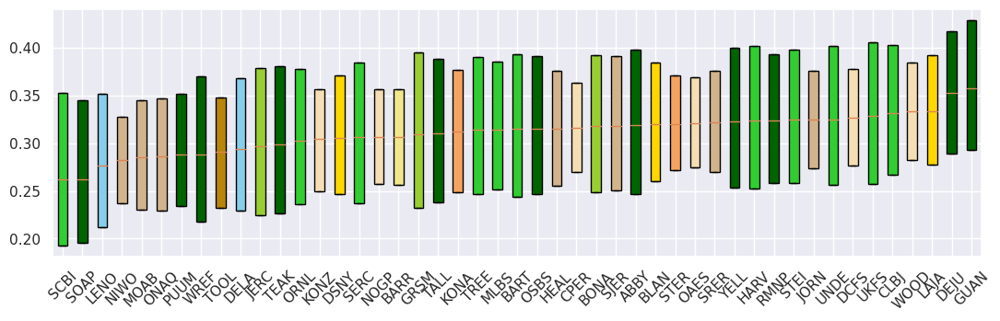

In [74]:
stats,nlcd,sites_=nlcd_plot(d_ani_ust,'yb','lo')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

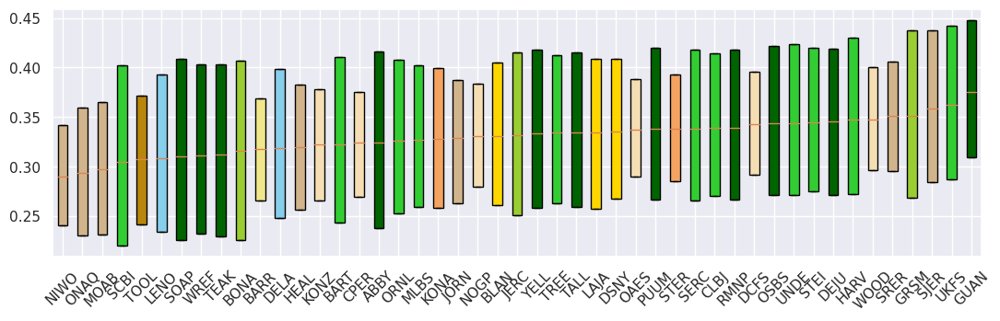

In [199]:
stats,nlcd,sites_=nlcd_plot(d_ani_stb,'yb','full')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

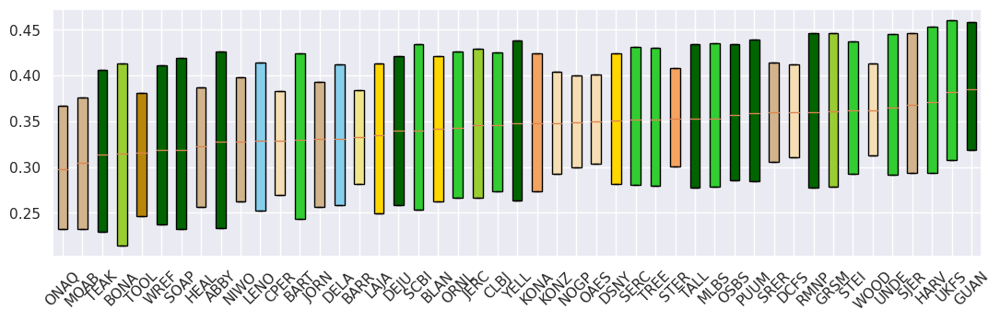

In [76]:
stats,nlcd,sites_=nlcd_plot(d_ani_stb,'yb','hi')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

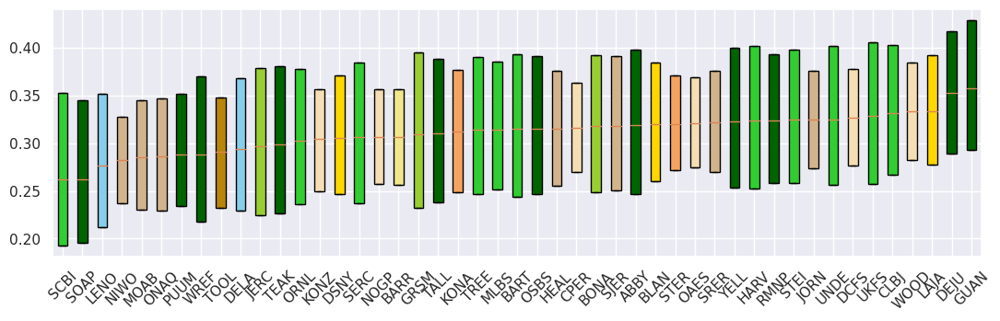

In [77]:
stats,nlcd,sites_=nlcd_plot(d_ani_stb,'yb','lo')
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a));
bplt=ax.bxp(stats, showfliers=False,patch_artist=True);
i=0
for patch in bplt['boxes']:
    patch.set_facecolor(class_colors[nlcd[i]])
    i=i+1
ax.set_xticks(np.linspace(1,47,47),sites_)
ax.tick_params(axis='x',labelrotation=45)
#plt.ylim(.2,.47)

In [ ]:
#return ani_sorted, means_sorted, pct25_sorted, pct75_sorted, nlcd_sorted, sites_sorted


# SS by Stability

In [132]:
d_unst['U']['SSlo_s'].keys()

dict_keys(['ABBY', 'BARR', 'BART', 'BLAN', 'BONA', 'CLBJ', 'CPER', 'DCFS', 'DEJU', 'DELA', 'DSNY', 'GRSM', 'GUAN', 'HARV', 'HEAL', 'JERC', 'JORN', 'KONA', 'KONZ', 'LAJA', 'LENO', 'MLBS', 'MOAB', 'NIWO', 'NOGP', 'OAES', 'ONAQ', 'ORNL', 'OSBS', 'PUUM', 'RMNP', 'SCBI', 'SERC', 'SJER', 'SOAP', 'SRER', 'STEI', 'STER', 'TALL', 'TEAK', 'TOOL', 'TREE', 'UKFS', 'UNDE', 'WOOD', 'WREF', 'YELL'])

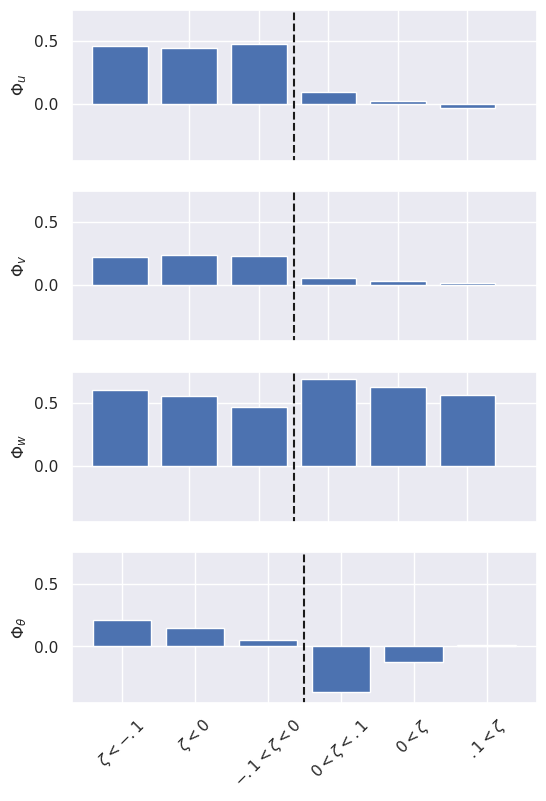

In [142]:
sz=1
j=0
fig,axs=plt.subplots(4,1,figsize=(6*sz,9*sz))
names=[]
names.append(r'$\zeta<-.1$')
names.append(r'$\zeta<0$')
names.append(r'$-.1<\zeta<0$')
names.append(r'$0<\zeta<.1$')
names.append(r'$0<\zeta$')
names.append(r'$.1<\zeta$')

for v in list(d_unst.keys())[0:4]:
    ss=[]
    ss.append(d_unst[v]['SShi'])
    ss.append(d_unst[v]['SS'])
    ss.append(d_unst[v]['SSlo'])
    
    ss.append(d_stbl[v]['SSlo'])
    ss.append(d_stbl[v]['SS'])
    ss.append(d_stbl[v]['SShi'])
    
    axs[j].bar(names,ss)
    axs[j].plot([2.5,2.5],[-1,1],'k--')
    if j<3:
        axs[j].set_xticks([1,2,3,4,5,6],[])
    axs[j].set_ylabel(ylabels[j])
    axs[j].set_ylim(-.45,.75)
    axs[j].tick_params(axis='x',labelrotation=45)
    j=j+1

# SS by Site and Stability

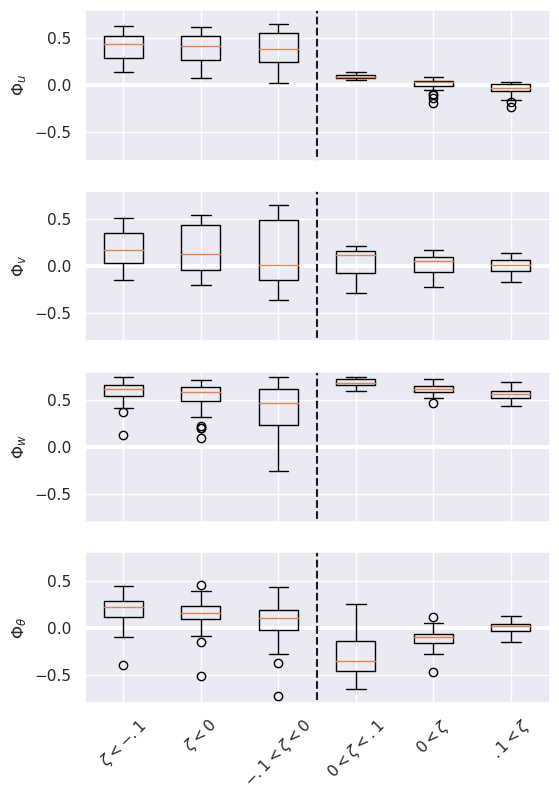

In [154]:
sz=1
j=0
fig,axs=plt.subplots(4,1,figsize=(6*sz,9*sz))
names=[]
names.append(r'$\zeta<-.1$')
names.append(r'$\zeta<0$')
names.append(r'$-.1<\zeta<0$')
names.append(r'$0<\zeta<.1$')
names.append(r'$0<\zeta$')
names.append(r'$.1<\zeta$')

for v in list(d_unst.keys())[0:4]:
    ss=[]
    ss.append(list(d_unst[v]['SShi_s'].values()))
    ss.append(list(d_unst[v]['SS_s'].values()))
    ss.append(list(d_unst[v]['SSlo_s'].values()))
    
    ss.append(list(d_stbl[v]['SSlo_s'].values()))
    ss.append(list(d_stbl[v]['SS_s'].values()))
    ss.append(list(d_stbl[v]['SShi_s'].values()))
    
    ss=np.array(ss)
    axs[j].plot([0,7],[0,0],color='w',linewidth=3)
    axs[j].boxplot(ss.T,labels=names)
    axs[j].plot([3.5,3.5],[-1,1],'k--')
    if j<3:
        axs[j].set_xticks([1,2,3,4,5,6],[])
    axs[j].set_ylabel(ylabels[j])
    axs[j].set_ylim(-.8,.8)
    axs[j].set_xlim(.5,6.5)
    axs[j].tick_params(axis='x',labelrotation=45)
    j=j+1

# SS by Site and Stability Heatmap 

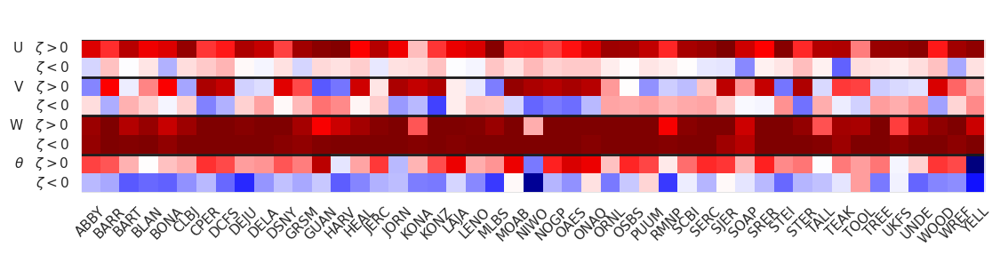

In [176]:
data=np.zeros((47,8))
a=1.01
_, ax = plt.subplots(figsize=(13*a,3.5*a))
sites=list(d_unst[v]['SShi_s'].keys())
sites.sort()
var_=list(d_unst.keys())[0:4]
for i in range(len(sites)):
    site=sites[i]
    for j in range(4):
        v=var_[j]
        data[i,j*2]=d_unst[v]['SS_s'][site]
        data[i,j*2+1]=d_stbl[v]['SS_s'][site]

plt.imshow(data.T,cmap='seismic',vmin=-.6,vmax=.6)
plt.xticks(np.linspace(0,46,47),sites,rotation=45)
plt.yticks([-.5,1.5,3.5,5.5,7.5],['\n\nU   $\zeta>0$\n$\zeta<0$','\n\nV   $\zeta>0$\n$\zeta<0$','\n\nW   $\zeta>0$\n$\zeta<0$','\n\n$θ$   $\zeta>0$\n$\zeta<0$',''])
plt.grid(False,axis='x')
plt.grid(True,axis='y',color='k',linewidth=2)

In [187]:
bounds=[]
clist=[]
names=[]
cck=list(class_colors.keys())
cck.sort()
for i in cck:
    bounds.append(i)
    clist.append(class_colors[i])
    names.append(class_names[i])
bounds.append(100)
cmap = matplotlib.colors.ListedColormap(clist)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

In [188]:
nlcds=[]
for site in sites:
    if site in nlcdd.keys():
        nlcds.append(nlcdd[site])
    else:
        nlcds.append(d_ani_ust[site]['yb']['lo']['lc'])

([], [])

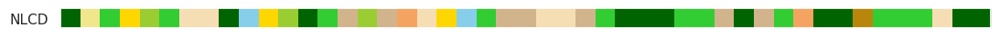

In [194]:
plt.figure(figsize=(13*a,3.5*a),dpi=300)
plt.imshow(np.array(nlcds).reshape(1,47),cmap=cmap,norm=norm)
plt.grid(False)
plt.yticks([0],['NLCD'])
plt.xticks([],[])

In [281]:
nnn=np.unique(nlcd)
clist=[]
names=[]
for i in nnn:
    clist.append(class_colors[i])
    names.append(class_names[i])

In [284]:
names

['Decid.',
 'Everg.',
 'Mix Forest',
 'Dwarf Scrub',
 'Shrub',
 'Grass',
 'AK:Sedge',
 'Pasture',
 'Crops',
 'Wetland']

(0.0, 10.0)

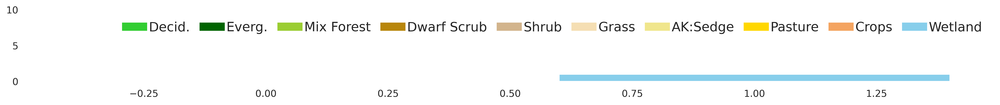

In [291]:
fig=plt.figure(figsize=(20,1.5),dpi=500)
ax = fig.add_subplot(1, 1, 1)
line=[0,1]
for i in clist:
    plt.bar(line,line,color=i)
ax.set_facecolor('white')
plt.legend(names,ncol=10,handletextpad=.1,fontsize=15,framealpha=0,columnspacing=0.7)
plt.grid(False)
plt.ylim(0,10)

# Focus Sites Plot

# Curve Fit Testing

1440

In [128]:
40*10**6/1440/365/47

1.6192234204475533

In [129]:
1.1*10**6/48/365/47

1.3358593218692316

In [597]:
fp=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_U_UVWT.h5','r')

In [587]:

def U_ust(zL,a):
    return a*(1-3*zL)**(1/3)

In [598]:
sigu=np.sqrt(fp['UU'][:])
sigv=np.sqrt(fp['VV'][:])
sigw=np.sqrt(fp['WW'][:])
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]
zL=zzd/lmost
phi=sigu/ustar
fpsites=fp['SITE'][:]

In [306]:
count={}
for site in np.unique(fpsites):
    count[site]=np.sum(fpsites==site)
    

In [590]:
def C_ust(zL,a,c):
    return a*(1-25*zL)**(-1/3)

In [307]:
for site in count.keys():
    print(str(site)+': '+str(count[site]/20000))

b'ABBY': 1.39655
b'BARR': 0.7338
b'BART': 1.73855
b'BLAN': 1.4367
b'BONA': 1.16265
b'CLBJ': 1.54965
b'CPER': 1.4545
b'DCFS': 1.725
b'DEJU': 1.62945
b'DELA': 1.53305
b'DSNY': 1.4316
b'GRSM': 1.07165
b'GUAN': 0.8178
b'HARV': 1.36925
b'HEAL': 0.8532
b'JERC': 1.59575
b'JORN': 1.9142
b'KONA': 1.7814
b'KONZ': 1.5638
b'LAJA': 0.85615
b'LENO': 0.8791
b'MLBS': 1.41925
b'MOAB': 1.4805
b'NIWO': 0.60335
b'NOGP': 1.4634
b'OAES': 1.39175
b'ONAQ': 1.50975
b'ORNL': 1.4323
b'OSBS': 1.14185
b'PUUM': 1.0041
b'RMNP': 1.77165
b'SCBI': 0.9312
b'SERC': 1.2955
b'SJER': 1.54335
b'SOAP': 1.8786
b'SRER': 1.75865
b'STEI': 1.7799
b'STER': 1.49155
b'TALL': 1.304
b'TEAK': 1.5074
b'TOOL': 0.88085
b'TREE': 1.67415
b'UKFS': 1.6584
b'UNDE': 1.7582
b'WOOD': 1.6706
b'WREF': 1.3612
b'YELL': 1.31745


In [308]:
np.mean(list(count.values()))

27882.0

In [70]:
def evenbin(a_,bins=15):
    aa=a_[(a_>=vmn_a)&(a_<=vmx_a)]
    binedge=[]
    for i in range(bins+1):
        binedge.append(np.percentile(aa,i/bins*100))
    return binedge

In [340]:
abin=evenbin(ani,bins=122)

In [601]:
abin=evenbin(ani,bins=100)
abin=np.array(abin)
params=np.ones((len(abin)-1,1))
pvars=np.ones((len(abin)-1,1))
for i in range(len(abin)-1):
    m=(ani>abin[i])&(ani<abin[i+1])
    params[i,:],pcov=sci.optimize.curve_fit(U_ust,zL[m],phi[m])

In [602]:
pcov[0,0]

6.865479064140248e-06

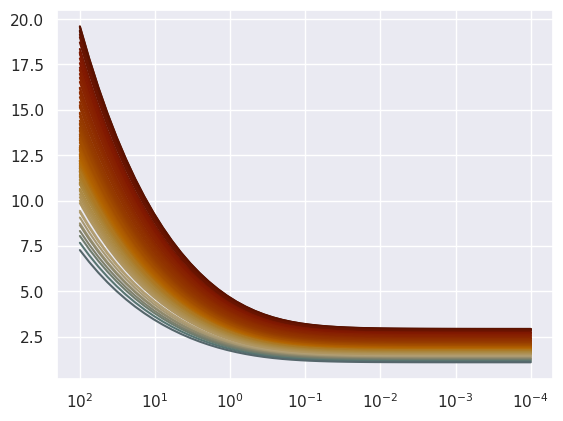

In [592]:
zL_plot=-np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    plt.semilogx(-zL_plot,U_ust(zL_plot,params[i][0]),color=clrs[i])
plt.gca().invert_xaxis()

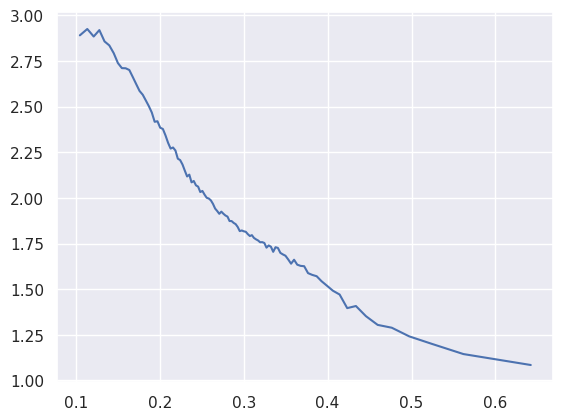

In [594]:
plt.plot((abin[0:-1]+abin[1:])/2,params.reshape(100))

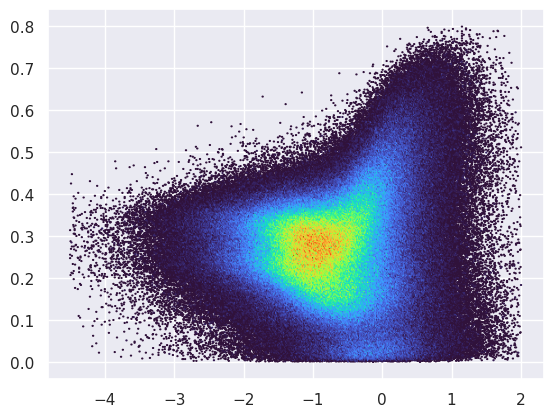

In [322]:
plt.hexbin(np.log10(-zL),ani,mincnt=1,cmap='turbo',gridsize=500,extent=(-4.5,2,0,.8))

In [315]:
fps=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_S_UVWT.h5','r')

In [321]:
ani2=fps['ANI_YB'][:]
zL2=(fps['tow_height'][:]-fps['zd'][:])/fps['L_MOST']

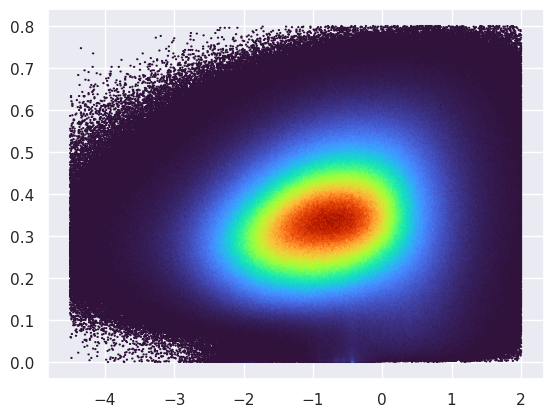

In [323]:
plt.hexbin(np.log10(zL2),ani2,mincnt=1,cmap='turbo',gridsize=500,extent=(-4.5,2,0,.8))


In [324]:
aaa=evenbin(ani2,25)

In [344]:
len(ani2[(ani2>vmn_a)&(ani2<vmx_a)])

40385839

In [336]:
abin

array([0.10000191, 0.11768699, 0.13117275, 0.14256089, 0.15249421,
       0.16154511, 0.16996901, 0.17778847, 0.18522265, 0.19222304,
       0.19886888, 0.20525558, 0.21139393, 0.21723015, 0.22287835,
       0.22846053, 0.23388443, 0.23916833, 0.24441755, 0.24953266,
       0.2546353 , 0.25964594, 0.26467234, 0.26967377, 0.27458184,
       0.27947901, 0.28433702, 0.28921359, 0.29407884, 0.29889201,
       0.30373029, 0.30856519, 0.31339267, 0.3183468 , 0.32334428,
       0.32846717, 0.33379554, 0.33931879, 0.34516578, 0.35139094,
       0.35818982, 0.36574607, 0.37431582, 0.38423952, 0.39582133,
       0.41012589, 0.42820512, 0.45210242, 0.48575174, 0.53934734,
       0.69993216])

In [339]:
len(ani[(ani>vmn_a)&(ani<vmx_a)])/10000

122.3675

In [350]:
fp=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_U_H2O.h5','r')

In [358]:
def C_ust(zL,a,c):
    return a*(1+c*zL)**(-1/3)

In [368]:
def C_ust2(zL,a):
    return a*(1-20*zL)**(-1/3)

In [351]:
molh2o=18.02*10**(-3)
moldry=28.97*10**(-3)
kgdry_m3=fp['RHO'][:]/(fp['H2O'][:]/1000+1)
rr = fp['H2O_SIGMA'][:]*molh2o/moldry
lhv=2500827 - 2360*(fp['T_SONIC'][:]-273)
phi=np.abs(rr/(fp['LE'][:]/lhv/fp['USTAR'][:]))*kgdry_m3/10**3
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]
zL=zzd/lmost

In [380]:
abin=evenbin(ani,bins=110)
abin=np.array(abin)
params=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    m=(ani>abin[i])&(ani<abin[i+1])
    params[i,:],_=sci.optimize.curve_fit(C_ust,zL[m],phi[m],bounds=([-np.inf,-30],[np.inf,-1]))

(0.0, 15.0)

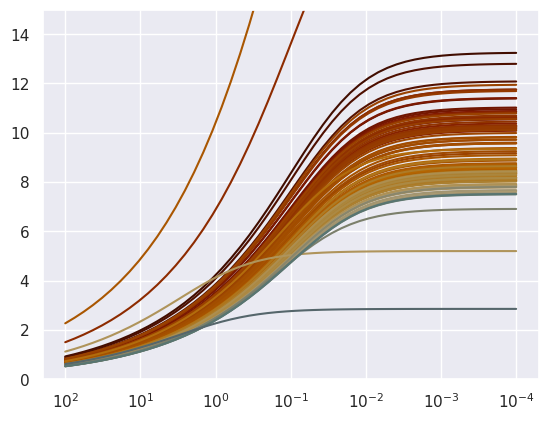

In [383]:
zL_plot=-np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    plt.semilogx(-zL_plot,C_ust(zL_plot,params[i][0],params[i][1]),color=clrs[i])
plt.gca().invert_xaxis()
plt.ylim(0,15)

In [376]:
abin=evenbin(ani,bins=110)
abin=np.array(abin)
params=np.ones((len(abin)-1,1))
for i in range(len(abin)-1):
    m=(ani>abin[i])&(ani<abin[i+1])
    params[i,:],_=sci.optimize.curve_fit(C_ust2,zL[m],phi[m])

(0.0, 15.0)

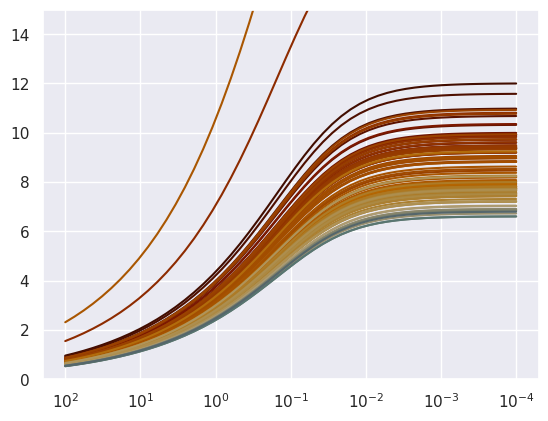

In [379]:
zL_plot=-np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    plt.semilogx(-zL_plot,C_ust2(zL_plot,params[i][0]),color=clrs[i])
plt.gca().invert_xaxis()
plt.ylim(0,15)

In [584]:
fp=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_S_UVWT.h5','r')

In [585]:
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]
zL=zzd/lmost

In [405]:
def U_stb(zL,a,c):
    phi=a*(1+3*zL)**(c)
    return phi
def T_stb(zL,a,b,c,d):
    logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [419]:
phiu=np.sqrt(fp['UU'][:])/ustar
phiv=np.sqrt(fp['VV'][:])/ustar
phiw=np.sqrt(fp['WW'][:])/ustar
phiT=fp['T_SONIC_SIGMA'][:]*fp['USTAR'][:]/fp['WTHETA'][:]

In [407]:
abin=evenbin(ani,bins=110)
abin=np.array(abin)
params=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])
    try:
        params[i,:],_=sci.optimize.curve_fit(U_stb,zL[m],phiu[m],p0=[2,.08])
    except:
        print(abin[i])

..............................................................................................................

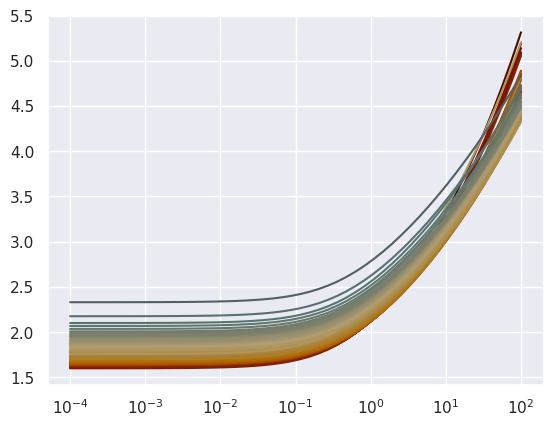

In [408]:
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.semilogx(zL_plot,U_stb(zL_plot,params[i][0],params[i][1]),color=clrs[i])

In [414]:
params=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])
    try:
        params[i,:],_=sci.optimize.curve_fit(U_stb,zL[m],phiv[m],p0=[2,.08])
    except:
        print(abin[i])

..............................................................................................................

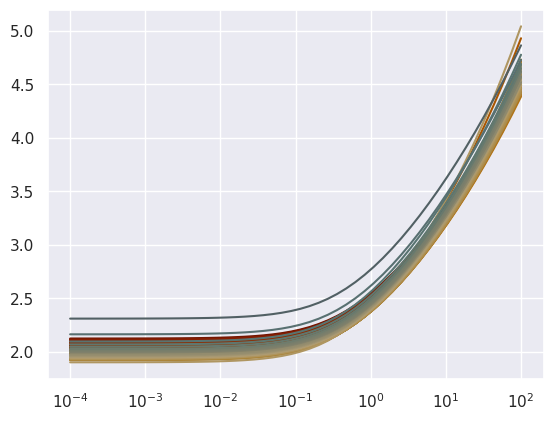

In [415]:
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.semilogx(zL_plot,U_stb(zL_plot,params[i][0],params[i][1]),color=clrs[i])

In [416]:
params2=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])
    try:
        params2[i,:],_=sci.optimize.curve_fit(U_stb,zL[m],phiw[m],p0=[1.4,.03])
    except:
        print(abin[i])

..............................................................................................................

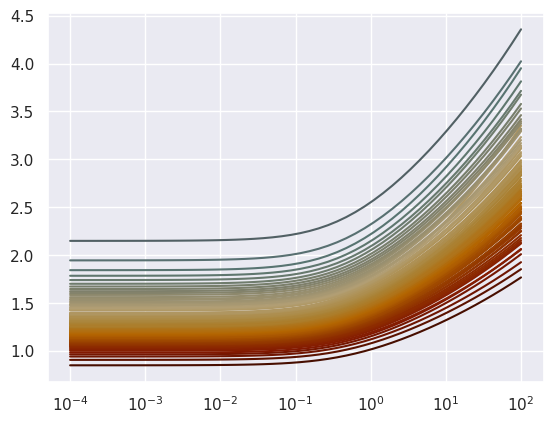

In [417]:
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.semilogx(zL_plot,U_stb(zL_plot,params2[i][0],params2[i][1]),color=clrs[i])

In [425]:
def T_stb(zL,a,b,c,d):
    logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [472]:
def T_stb2(zL,a,d):
    logphi=a+d*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [480]:
def T_stb3(zL,a,b,c):
    #t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
    phi=a*(zL)**(b)+c
    return phi

In [89]:
#1+10**(-.005*np.log10(tt)**3)
def T_stb31(zL,a,b,c):
    #t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
    logphi=a+b*5/6*np.log10(zL)+c*np.log10(zL)**2+b*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [90]:
#1+10**(-.005*np.log10(tt)**3)
def T_stb32(zL,a,b,c):
    #t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
    logphi=a+c*np.log10(zL)-b*5/6*np.log10(zL)**2+b*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [92]:
#1+10**(-.005*np.log10(tt)**3)
def T_stb2(zL,a,b):
    #t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
    logphi=a+b*5/6*np.log10(zL)-5/6*b*np.log10(zL)**2+b*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [66]:
fp=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_S_UVWT.h5','r')

In [ ]:
#abin=evenbin(ani,bins=25)
#abin=np.array(abin)
#params=np.ones((len(abin)-1,4))
#for i in range(len(abin)-1):
#    print('.',end='',flush=True)
#    m=(ani>abin[i])&(ani<abin[i+1])&m2
#    try:
        # [-1,-1,-1,-1],[1,1,1,1]
        # [-.1,-.4,-.2,-.4],[.7,.4,.2,.2]
#        params[i,:],_=sci.optimize.curve_fit(T_stb,zL[m],phiT[m],p0=[.5,-.1,.05,.1],bounds=([-.1,-.4,-.2,-.4],[.7,.4,.2,.2]),loss='cauchy')
#    except Exception as e:
#        print(e)

In [68]:
phiT=np.abs(fp['T_SONIC_SIGMA'][:]*fp['USTAR'][:]/fp['WTHETA'][:])
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]
zL=zzd/lmost
m2=np.zeros((len(ani),))
m2[0:1000000]=1
np.random.shuffle(m2)
m2=m2.astype(bool)

In [95]:
#abin=evenbin(ani,bins=25)
#abin=np.array(abin)
params=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])&m2
    try:
        # [-1,-1,-1,-1],[1,1,1,1]
        # [-.1,-.4,-.2,-.4],[.7,.4,.2,.2]
        params[i,:],_=sci.optimize.curve_fit(T_stb2,zL[m],phiT[m],p0=[.5,-.1],bounds=([-1,-1,],[1,1]),loss='cauchy')
    except Exception as e:
        print(e)

.........Optimal parameters not found: The maximum number of function evaluations is exceeded.
............Optimal parameters not found: The maximum number of function evaluations is exceeded.
.Optimal parameters not found: The maximum number of function evaluations is exceeded.
.Optimal parameters not found: The maximum number of function evaluations is exceeded.
.Optimal parameters not found: The maximum number of function evaluations is exceeded.
.Optimal parameters not found: The maximum number of function evaluations is exceeded.


(0.5, 100)

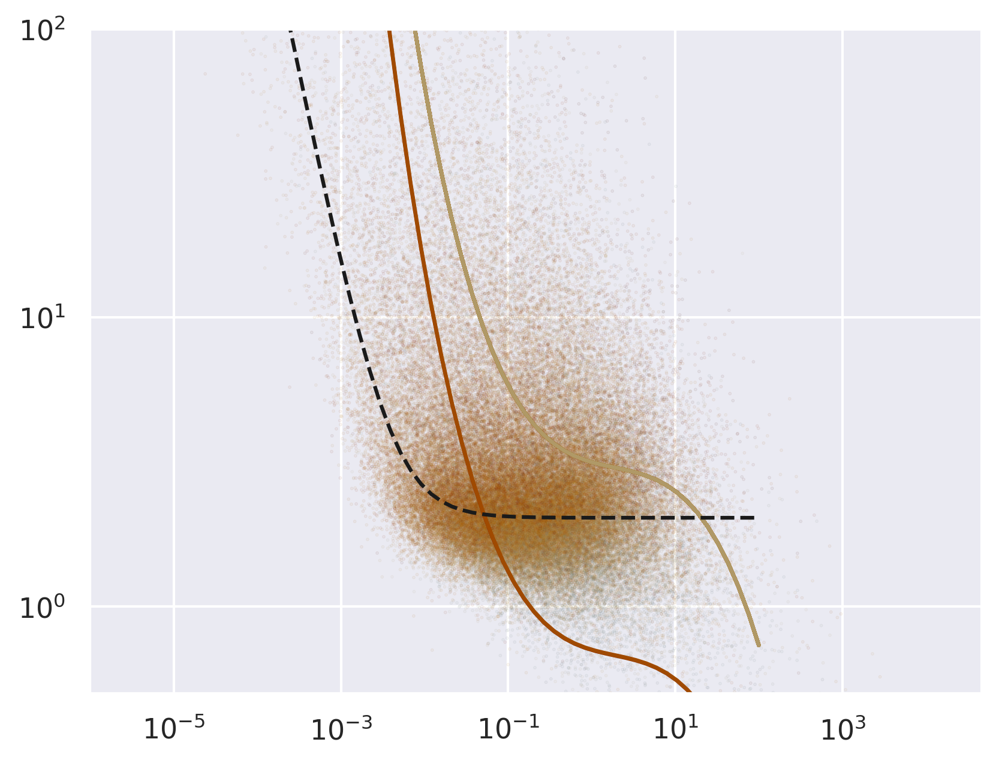

In [97]:
plt.figure(dpi=300)
zL_plot=np.logspace(-4,2)
phi_s=d_stbl['T']['phi']
cc_s=cani_norm(d_stbl['T']['ani'][:])
ss=.1
alph=.1
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
plt.scatter(d_stbl['T']['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.loglog(zL_plot,T_stb2(zL_plot,params[i][0],params[i][1]),color=clrs[i])
    #plt.loglog(zL_plot,T_stb(zL_plot,params[i][0],params[i][1],params[i][2],params[i][3]),color=clrs[i])
t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
plt.semilogx(zL_plot,t_s_old,'k--')
plt.ylim(.5,100)


array([[ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [-0.14267406, -0.1014063 ],
       [ 0.5       , -0.1       ],
       [-0.01345314, -0.10128212],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 1.        ,  1.        ],
       [-0.14406299, -0.10179342],
       [-0.01345283, -0.10136793],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 1.        ,  1.        ],
       [ 1.        ,  1.        ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ],
       [ 0.5       , -0.1       ]])

In [532]:
fp=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_S_H2O.h5','r')
ani=fp['ANI_YB'][:]
ustar=fp['USTAR'][:]
lmost=fp['L_MOST'][:]
zzd=fp['tow_height'][:]-fp['zd'][:]
zL=zzd/lmost
molh2o=18.02*10**(-3)
moldry=28.97*10**(-3)
kgdry_m3=fp['RHO'][:]/(fp['H2O'][:]/1000+1)
rr = fp['H2O_SIGMA'][:]*molh2o/moldry
lhv=2500827 - 2360*(fp['T_SONIC'][:]-273)
phiH=np.abs(rr/(fp['LE'][:]/lhv/fp['USTAR'][:]))*kgdry_m3/10**3
#molh2o=18.02*10**(-3)
#moldry=28.97*10**(-3)
#co2 = fp['CO2_SIGMA'][:]
#co2=co2/10**6
#kgdry_m3=fp['RHO'][:]/(fp['H2O'][:]/1000+1)
#moldry_m3=kgdry_m3/moldry
#phi=np.abs(co2/(fp['CO2FX'][:]/fp['USTAR'][:]))*moldry_m3


In [581]:
def C_stb(zL,a,b,c):
    #logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
    logphi=a+b*np.log10(zL)+c*np.log10(zL)**3
    logphi=a+c*np.log10(zL)**3
    phi=10**(logphi)
    return phi

In [575]:
m2=np.zeros((len(ani),))
m2[0:1000000]=1
np.random.shuffle(m2)
m2=m2.astype(bool)
m2=m2&(~np.isnan(phiH))

In [582]:
#abin=evenbin(ani,bins=25)
#abin=np.array(abin)
params=np.ones((len(abin)-1,3))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])&m2
    try:
        #[-1,-1,-1,-1],[1,1,1,1]
        # [-.1,-.4,-.2,-.4],[.7,.4,.2,.2]
        params[i,:],_=sci.optimize.curve_fit(C_stb,zL[m],phiH[m],p0=[.5,0,0],bounds=([-1,-1,-1],[1,1,1]),loss='cauchy')
    except Exception as e:
        print(e)

.........................

(0.5, 10.0)

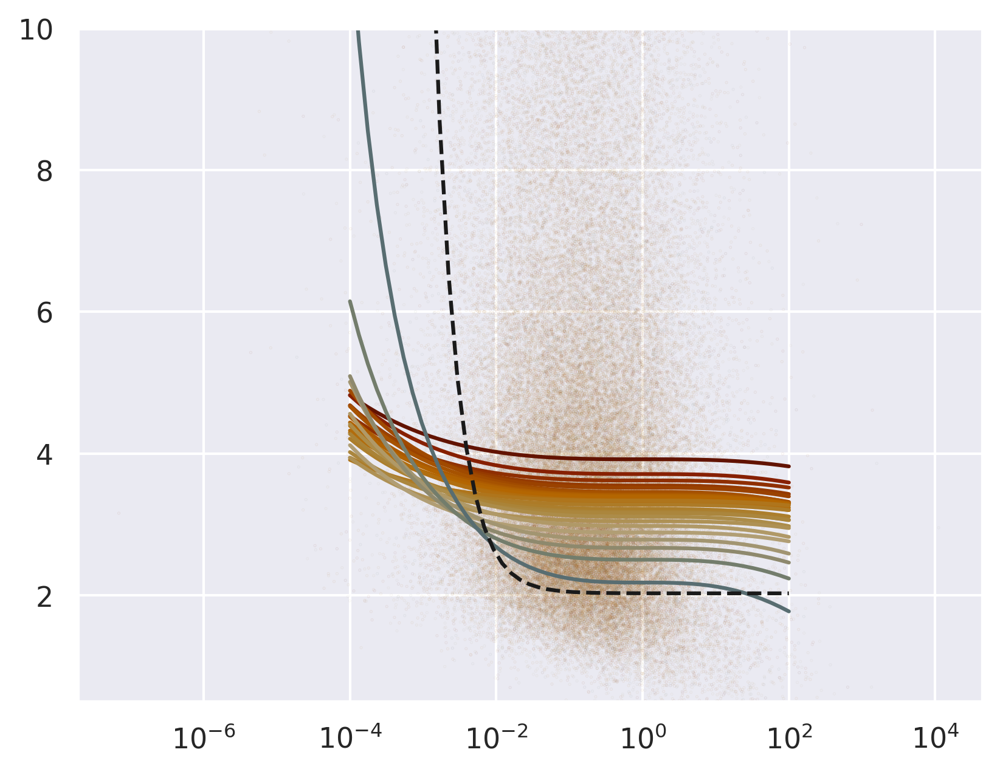

In [583]:
plt.figure(dpi=300)
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
phi_s=d_stbl['H2O']['phi']
cc_s=cani_norm(d_stbl[v]['ani'][:])
plt.scatter(d_stbl['H2O']['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
#params=para0.copy()
#params[:,2]=0
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    #plt.semilogx(zL_plot,T_stb(zL_plot,params[i][0],params[i][1],params[i][2],params[i][3]),color=clrs[i])
    plt.semilogx(zL_plot,C_stb(zL_plot,params[i][0],params[i][1],params[i][2]),color=clrs[i])
t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
plt.semilogx(zL_plot,t_s_old,'k--')
plt.ylim(.5,10)

In [563]:
params

array([[ 5.95034822e-01, -2.73385233e-03, -2.70469385e-03,
        -2.32998794e-03],
       [ 5.70026870e-01, -5.96254559e-03, -3.34870421e-03,
        -2.06045945e-03],
       [ 5.51412619e-01, -6.44770726e-03, -2.18159823e-03,
        -2.46745287e-03],
       [ 5.51210412e-01, -1.91398016e-03, -9.54307028e-05,
        -1.52735499e-03],
       [ 5.41627063e-01, -1.35520048e-03,  1.55310492e-03,
        -1.78779520e-03],
       [ 5.45008565e-01, -4.92375831e-03, -9.75571410e-03,
        -4.96303678e-03],
       [ 5.41284169e-01,  3.38781953e-03, -3.64644695e-03,
        -3.44421476e-03],
       [ 5.34084472e-01, -3.68589803e-03, -5.54885540e-03,
        -3.58260186e-03],
       [ 5.33185259e-01,  1.95077407e-03,  6.54974168e-04,
        -1.78087431e-03],
       [ 5.33099128e-01,  2.30815410e-03, -4.53800561e-03,
        -3.69152980e-03],
       [ 5.23411855e-01, -7.66389725e-03, -7.85772311e-03,
        -3.36676014e-03],
       [ 5.26796644e-01, -7.33194039e-03, -1.23072326e-02,
      

In [546]:
params[params==1]=float('nan')

In [547]:
np.nanmin(params,axis=0)

array([ 0.3391157 , -0.06075942,  0.        , -0.1099993 ])

In [524]:
np.nanmax(params,axis=0)

array([ 0.43703349,  0.16112951,  0.00736774, -0.02799034])

In [492]:
#abin=evenbin(ani,bins=25)
#abin=np.array(abin)
params=np.ones((len(abin)-1,3))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])&m2
    try:
        params[i,:],_=sci.optimize.curve_fit(T_stb3,zL[m],phiT[m],p0=[.00087,-1.4,2],bounds=([0,-2,0],[np.inf,-1,np.inf]))
    except Exception as e:
        print(e)

.........................

(0.5, 100)

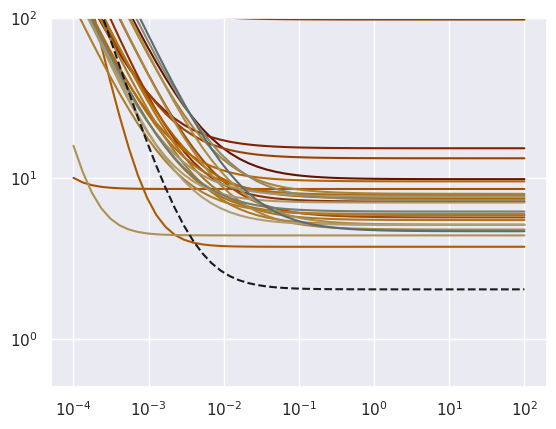

In [502]:
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.loglog(zL_plot,T_stb3(zL_plot,params[i][0],params[i][1],params[i][2]),color=clrs[i])
t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
plt.loglog(zL_plot,t_s_old,'k--')
plt.ylim(.5,100)

In [505]:
#abin=evenbin(ani,bins=25)
#abin=np.array(abin)
params=np.ones((len(abin)-1,2))
for i in range(len(abin)-1):
    print('.',end='',flush=True)
    m=(ani>abin[i])&(ani<abin[i+1])&m2
    try:
        params[i,:],_=sci.optimize.curve_fit(T_stb4,zL[m],phiT[m],p0=[0,-.01],bounds=([0,-2],[np.inf,0]))
    except Exception as e:
        print(e)

.........................

(0.5, 100.0)

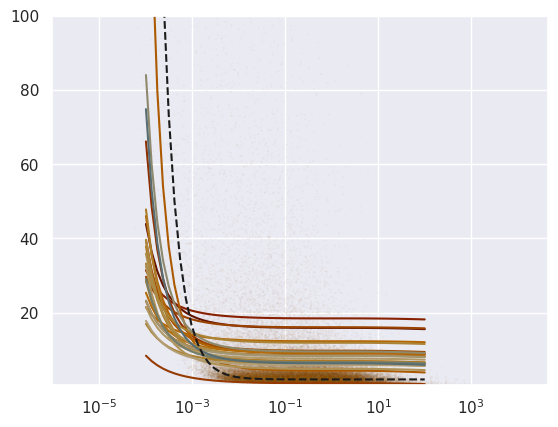

In [511]:
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
phi_s=d_stbl['T']['phi']
cc_s=cani_norm(d_stbl[v]['ani'][:])
plt.scatter(d_stbl['T']['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
for i in range(len(clrs)):
    if params[i][0]==1:
        continue
    plt.plot(zL_plot,T_stb4(zL_plot,params[i][0],params[i][1]),color=clrs[i])
t_s_old=0.00087*(zL_plot)**(-1.4)+2.03
plt.semilogx(zL_plot,t_s_old,'k--')
plt.ylim(.5,100)

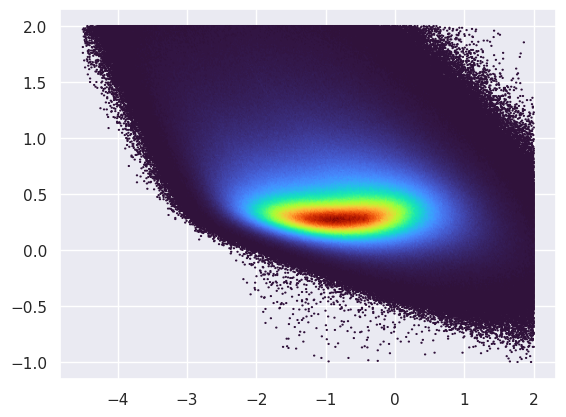

In [477]:
plt.hexbin(np.log10(zL),np.log10(phiT),mincnt=1,cmap='turbo',gridsize=500,extent=(-4.5,2,-1,2))

In [444]:
ani1=np.linspace(0,np.sqrt(3)/2)
a_=[.607,-.754]
b_=[-.353,3.374,-8.544,6.297]
c_=[0.195,-1.857,5.042,-3.874]
d_=[.0763,-1.004,2.836,-2.53]
#d_=[.0763,-.1004,-2.836,-2.53]
a=0
b=0
c=0
d=0
for i in range(2):
    a=a+a_[i]*ani1**i
for i in range(4):
    b=b+b_[i]*ani1**i
    c=c+c_[i]*ani1**i
    d=d+d_[i]*ani1**i

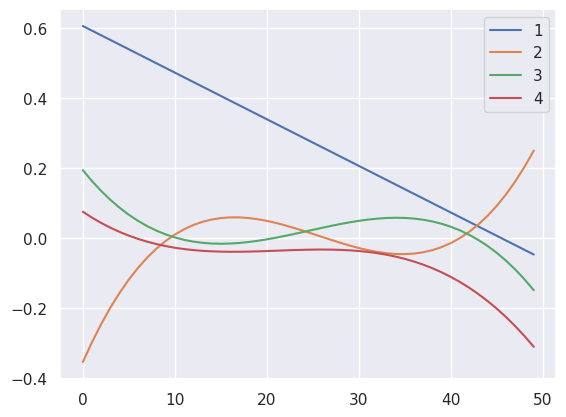

In [450]:
plt.plot(a)
plt.plot(b)
plt.plot(c)
plt.plot(d)
plt.legend(['1','2','3','4'])

In [456]:
tt=np.logspace(-4,2)

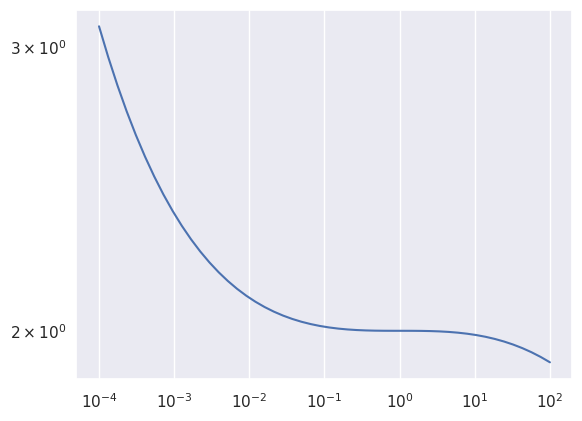

In [503]:
#plt.loglog(tt,T_stb3(tt,.001,-1.5,1))

#plt.loglog(tt,10**(-.05*np.log10(tt)**3))
plt.loglog(tt,1+10**(-.005*np.log10(tt)**3))

In [9]:
def T_stb(zL,a,b,c,d):
    logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
    phi=10**(logphi)
    return phi

def T_ust(zL,a):
    phi=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
    return phi

def U_stb(zL,a,c):
    phi=a*(1+3*zL)**(c)
    return phi

def U_ust(zL,a):
    return a*(1-3*zL)**(1/3)

def W_stb(zL,a,c):
    return U_stb(zL,a,c)

def W_ust(zL,a):
    return U_ust(zL,a)

def C_stb(zL,a,b,c,d):
    logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
    phi=10**(logphi)
    return phi

def C_ust(zL,a):
    #return a*(1+b*zL)**(-1/3)
    return a*(1-25*zL)**(-1/3)


In [259]:
d_fit=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_v1.p','rb'))
#dftc=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_CO2_v0.p','rb'))
#d_fit['CO2s']=dftc['CO2s']

In [13]:
d_fit['Uu'].keys()

dict_keys(['equation', 'param', 'param_var', 'SS', 'SSlo', 'SShi', 'anibins'])

In [ ]:
d_fit=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_v1.p','rb'))

def C_ust(zL,a):
    #return a*(1+b*zL)**(-1/3)
    return a*(1-25*zL)**(-1/3)

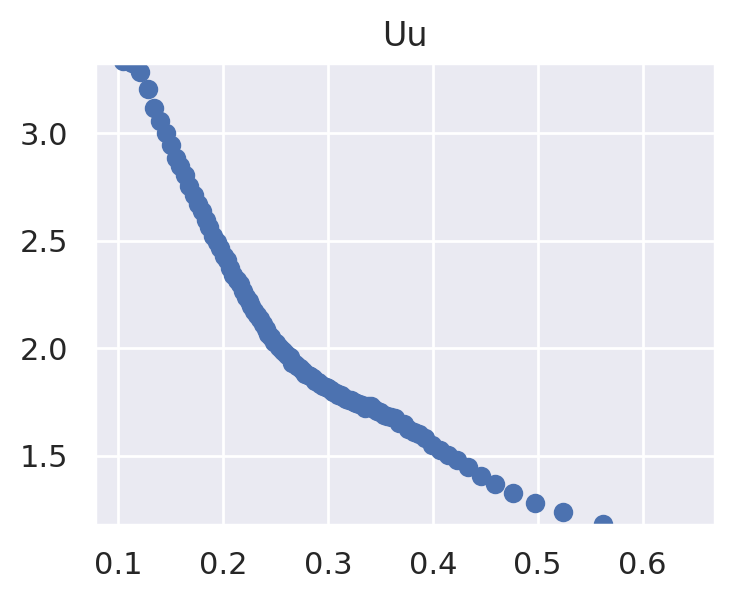

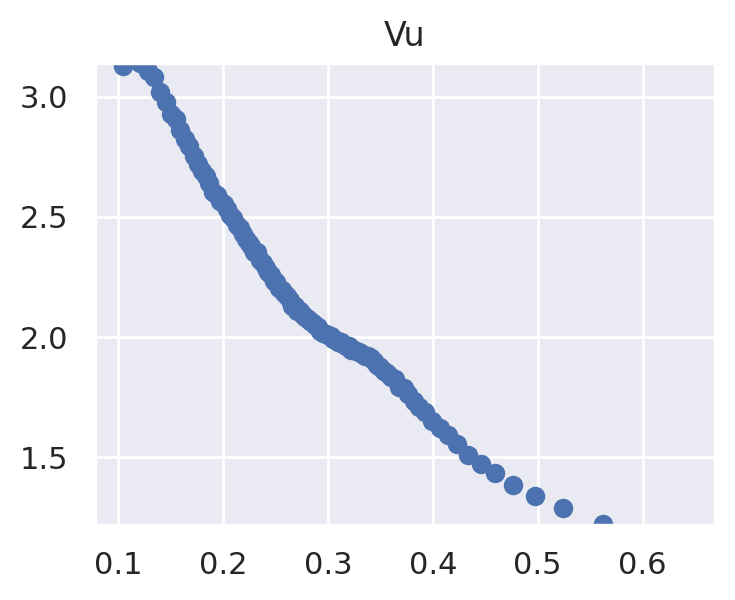

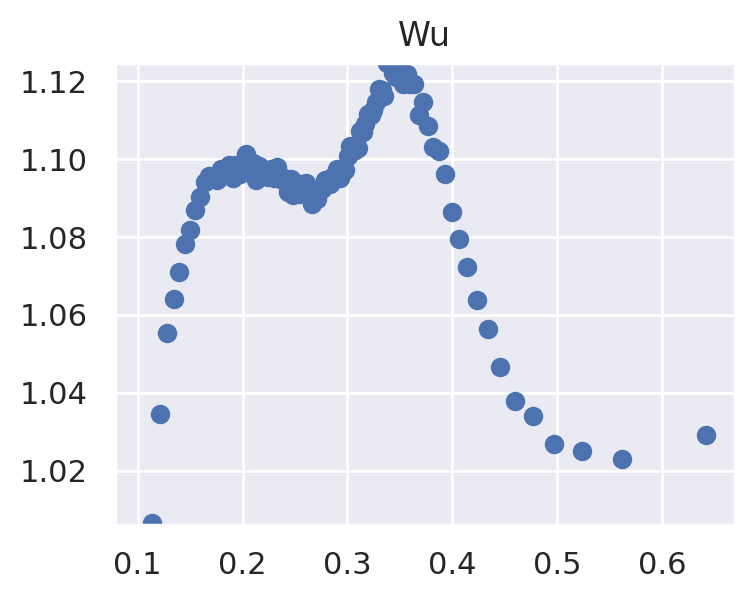

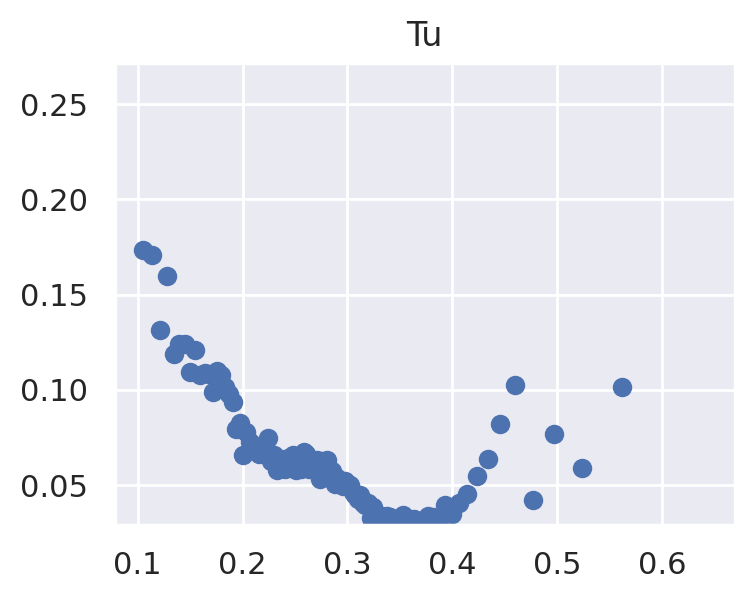

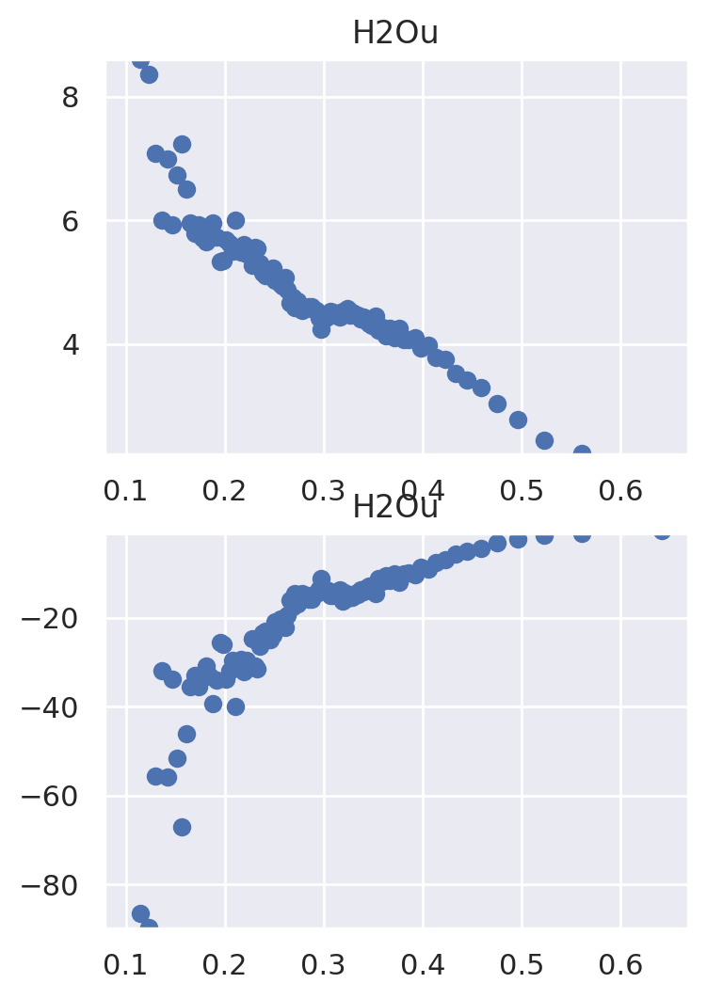

...

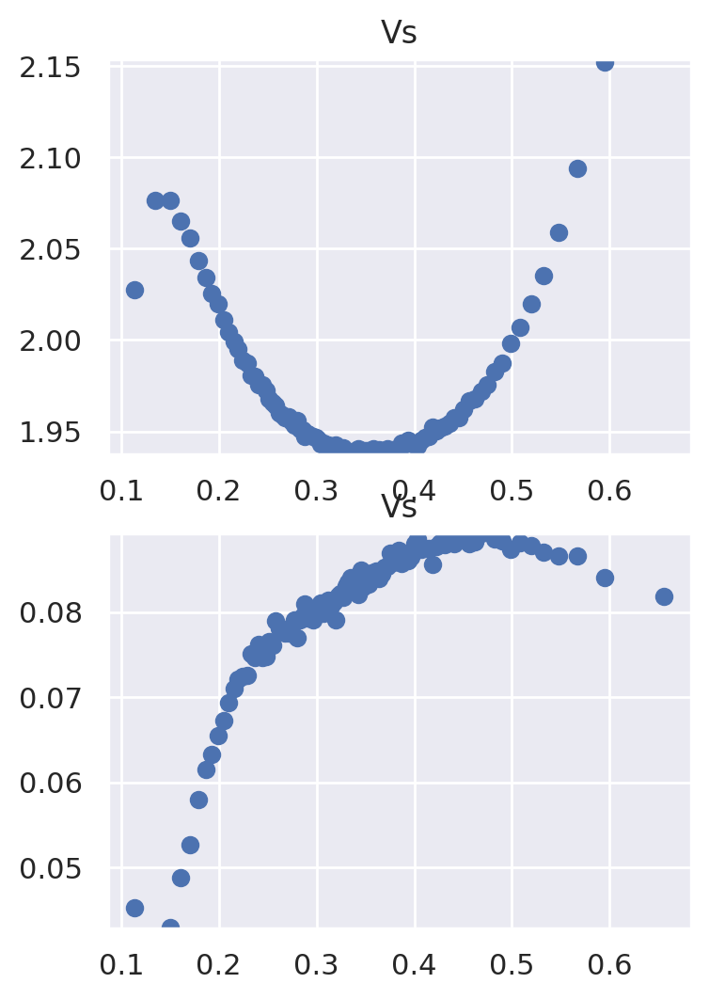

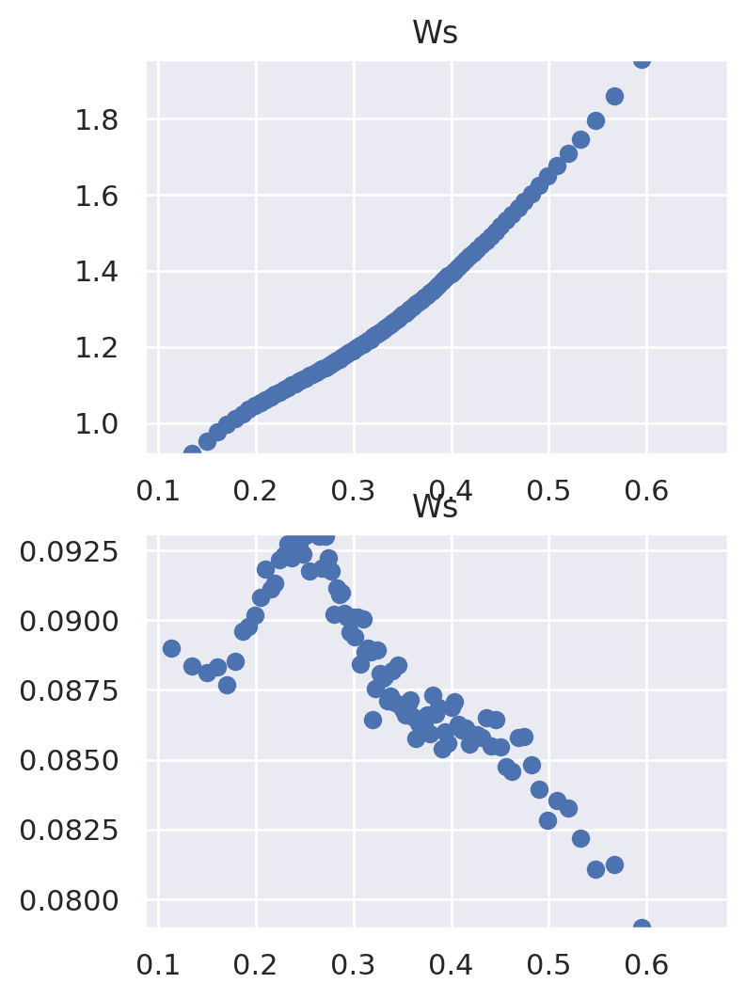

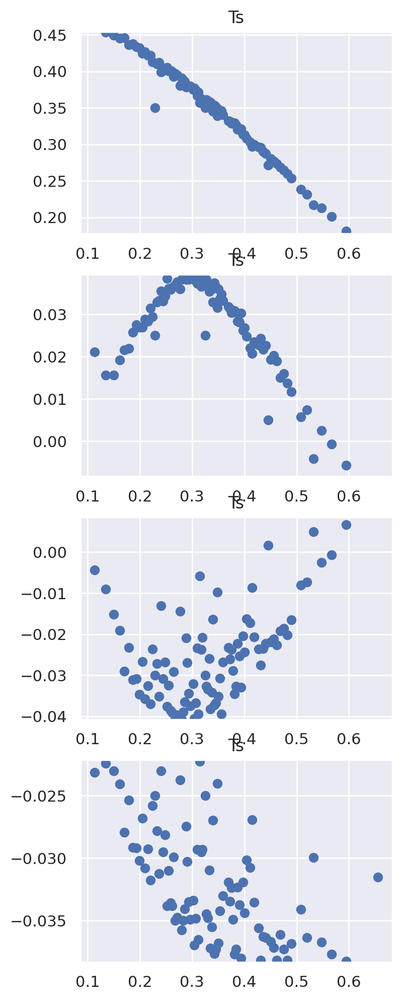

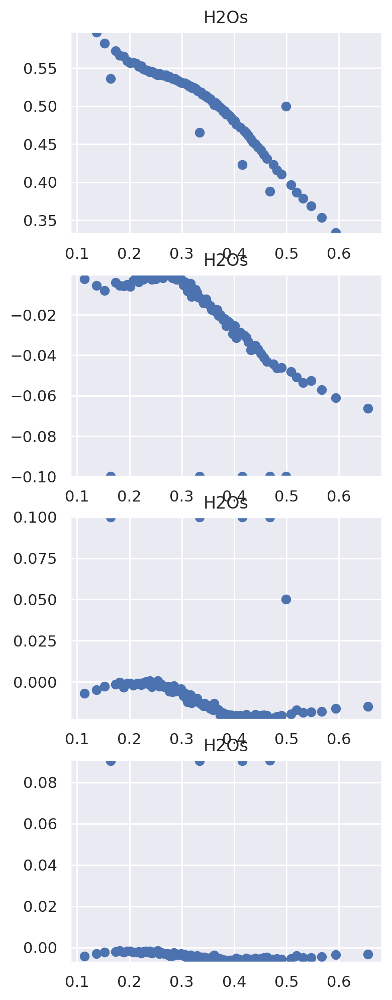

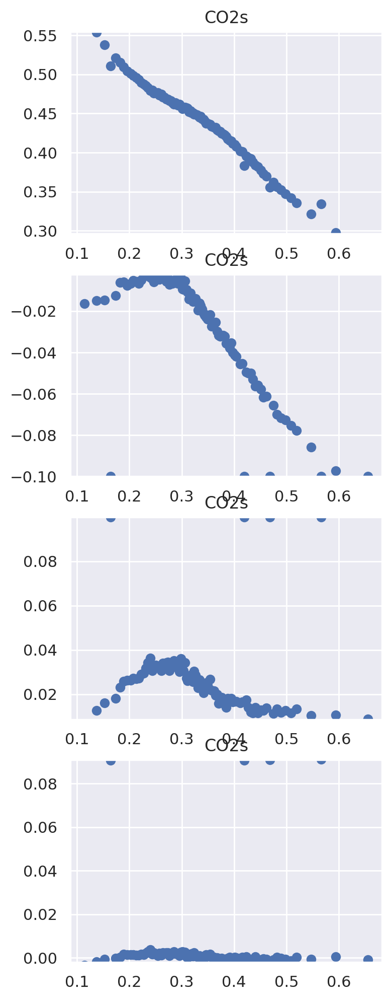

In [260]:
for k in d_fit.keys():
    param=d_fit[k]['param']
    anibins=d_fit[k]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    for i in range(len(pall)):
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls,param[:,i])
        plt.ylim(np.nanpercentile(param[:,i],1),np.nanpercentile(param[:,i],99))
        plt.title(k)


In [18]:
param=d_fit['Ts']['param']

(array([ 2.,  0.,  2.,  1.,  2.,  1.,  0.,  3.,  7.,  5.,  8.,  8., 10.,
        11.,  5.,  1.,  2.,  3.,  1.,  1.]),
 array([0.11664006, 0.13580805, 0.15497605, 0.17414405, 0.19331205,
        0.21248004, 0.23164804, 0.25081604, 0.26998403, 0.28915203,
        0.30832003, 0.32748803, 0.34665602, 0.36582402, 0.38499202,
        0.40416001, 0.42332801, 0.44249601, 0.46166401, 0.480832  ,
        0.5       ]),
 <BarContainer object of 20 artists>)

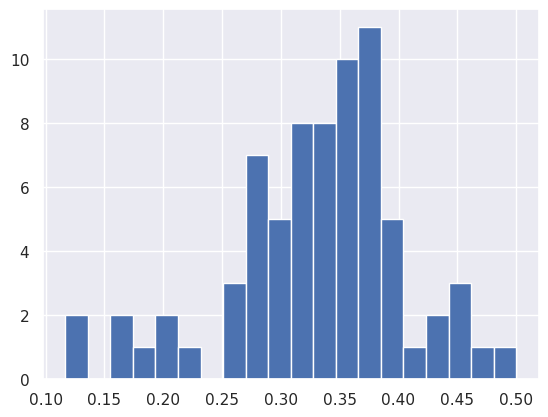

In [25]:
plt.hist(param[:,0],bins=20)

In [ ]:
plt.subplot(len(pall),1,i+1)
plt.scatter(anilvls,param[:,i])
plt.ylim(np.nanpercentile(param[:,i],1),np.nanpercentile(param[:,i],99))
plt.title(k)

In [118]:
k='Ts'
param=d_fit[k]['param']
anibins=d_fit[k]['anibins']
anilvls=(anibins[1:]+anibins[0:-1])/2

In [119]:
m=(~np.isnan(param[:,3]))&(param[:,3]<0)

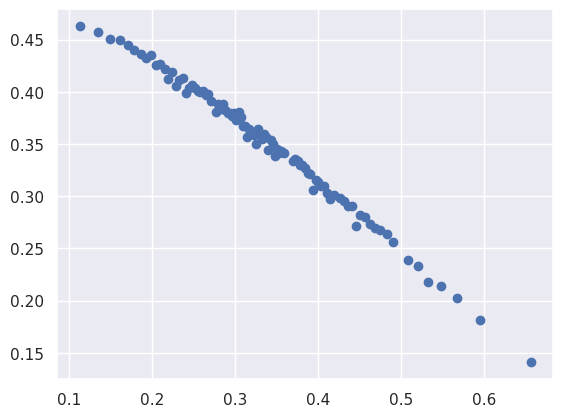

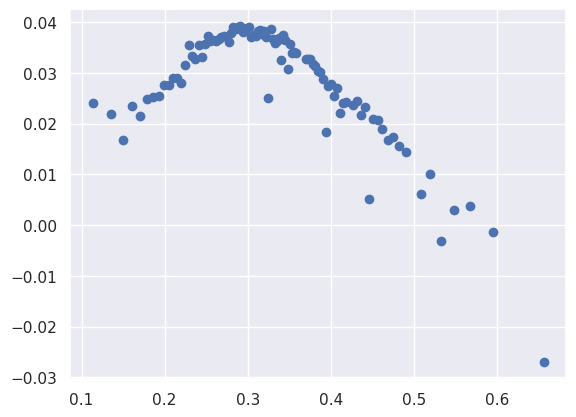

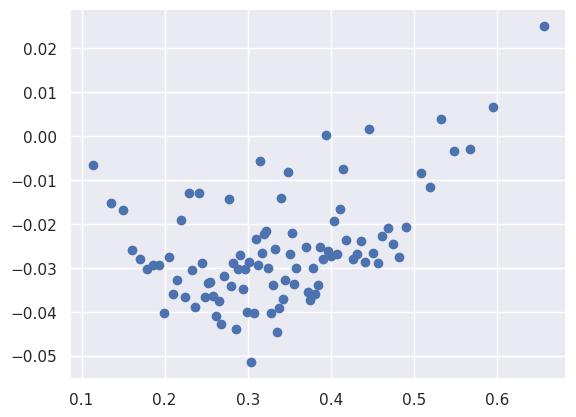

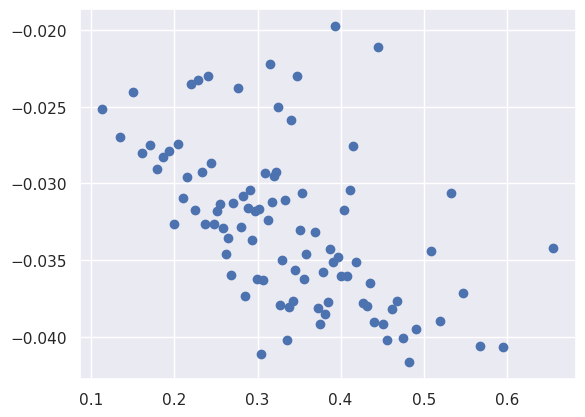

In [120]:
for i in range(4):
    plt.figure()
    plt.scatter(anilvls[m],param[:,i][m])

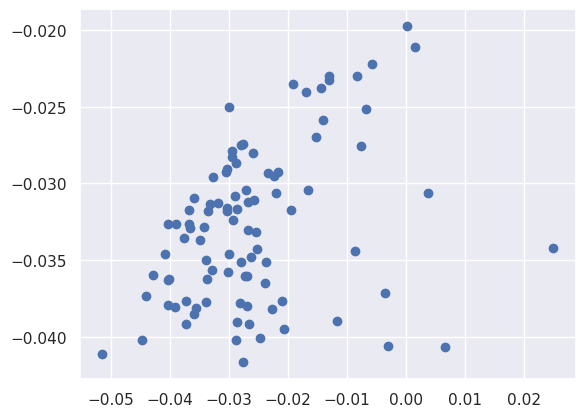

In [121]:
plt.scatter(param[:,2][m],param[:,3][m])

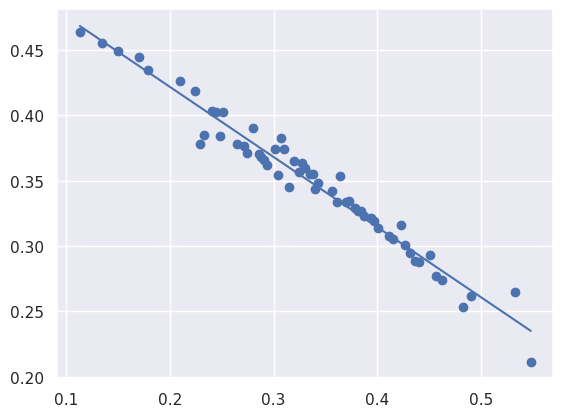

In [38]:
from numpy.polynomial import polynomial as P
deg=1
x=anilvls[m]
y=param[:,0][m]
c, stats = P.polyfit(x,y,deg,full=True)
plt.scatter(x,y)
y2=c[0]+c[1]*x
if deg>1:
    y2=y2+c[2]*x**2
if deg>2:
    y2=y2+c[3]*x**3
plt.plot(x,y2)

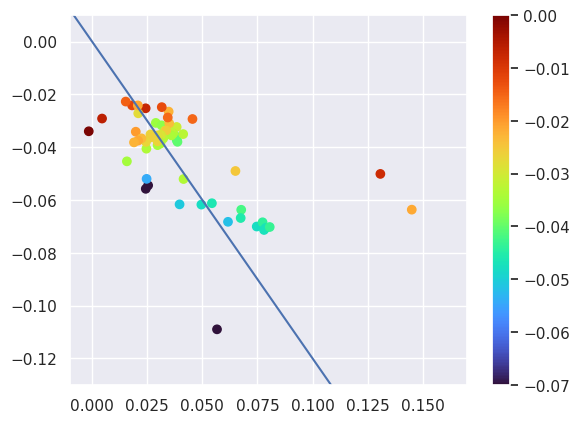

In [62]:
plt.scatter(param[:,1],param[:,3],c=param[:,2],cmap='turbo',vmax=0,vmin=-.07)
xx=np.linspace(-1,1)
plt.plot(xx,-xx*1.2)
plt.ylim(-.13,.01)
plt.xlim(-.01,.17)
plt.colorbar()

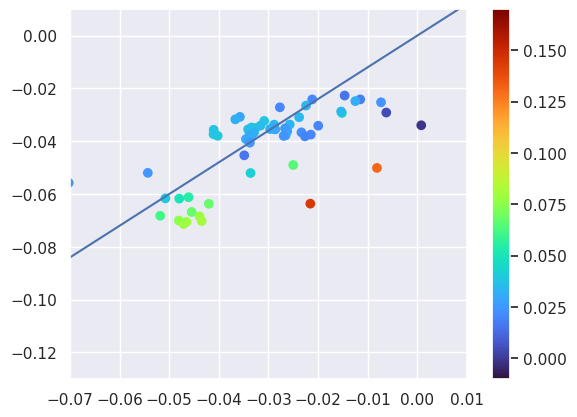

In [63]:
plt.scatter(param[:,2],param[:,3],c=param[:,1],cmap='turbo',vmin=-.01,vmax=.17)
xx=np.linspace(-1,1)
plt.plot(xx,xx*1.2)
plt.xlim(-.07,.01)
plt.ylim(-.13,.01)
plt.colorbar()

In [99]:
stats

[array([0.00570785]),
 2,
 array([1.40061618, 0.19563822]),
 1.3322676295501878e-14]

In [264]:
degs={'Uu':[2],'Vu':[2],'Wu':[3],'Tu':[2],'H2Ou':[2,2],'CO2u':[2,3],
      'Us':[2,2],'Vs':[2,3],'Ws':[2,3],'Ts':[1,3,3,2],'H2Os':[1,3,3,3],'CO2s':[1,3,3,3]}
mins={}
maxs={'Tu':[.75],'H2Ou':[14],'CO2u':[40],'Ts':[100,100,100,10],'H2Os':[100,100,.025,.02],'CO2s':[100,100,125,.02]}

'Uu':{'a':[4.3761815131090005,-11.761147930663759,11.094653118471262]},
'Vu':{'a':[4.036769646958779,-8.6952237574292,6.665209781616562]},
'Wu':{'a':[0.8517984087611057,2.154908933846703,-5.54701329434943,4.025729817911758]},
'Tu':{'a':[0.27814402332658494,-1.3300825904354217,1.8360360499380333]},
'H2Ou':{'a':[9.336791932370632,-20.243541684043578,14.864411809777001],'b':[-104.67772012815348,434.50291604779085,-459.0293962836742]},
'CO2u':{'a':[4.698799888376895,9.245870476056641,-25.09592763359702],'b':[187.29848099740425,-2361.702744171403,6979.400654664802,-5928.322081386223]},
'Us':{'a':[1.4717151872327583,0.012072368555451676,1.899822307024067],'b':[0.19323057864318993,-0.30596741646111014,0.20047175184453506]},
'Vs':{'a':[2.3403371987864494,-2.3209024377836824,3.327691452120783],'b':[-0.015725591952585882,0.5966752364174301,-1.1158220609457767,0.6679697765221119]},
'Ws':{'a':[0.8614591430983672,0.37304223945564274,2.419204148353563],'b':[0.0785398588770194,0.12596738442976788,-0.

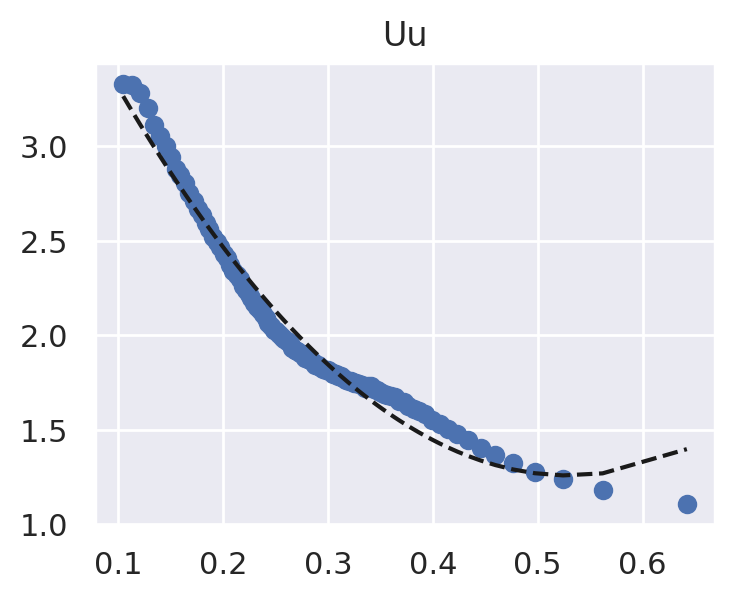

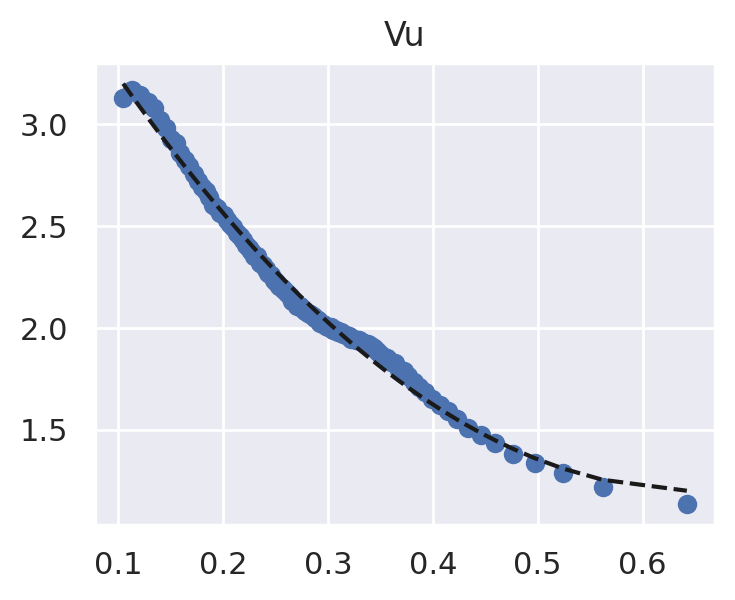

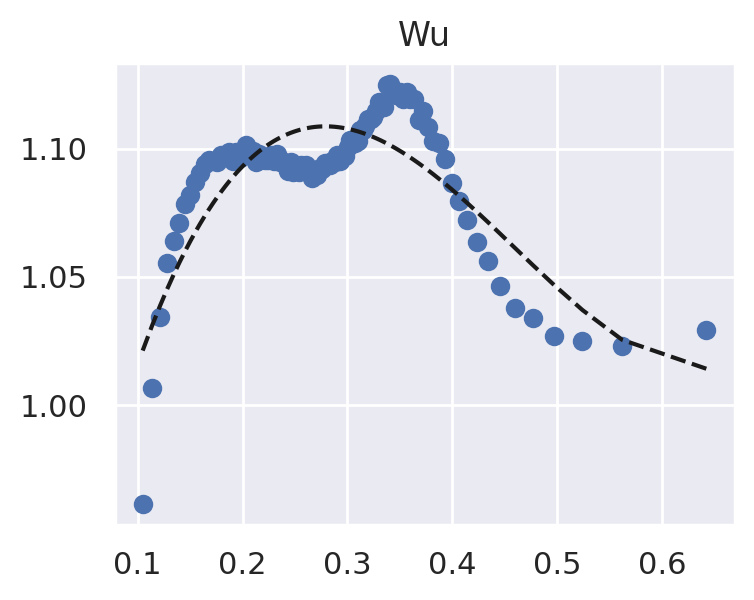

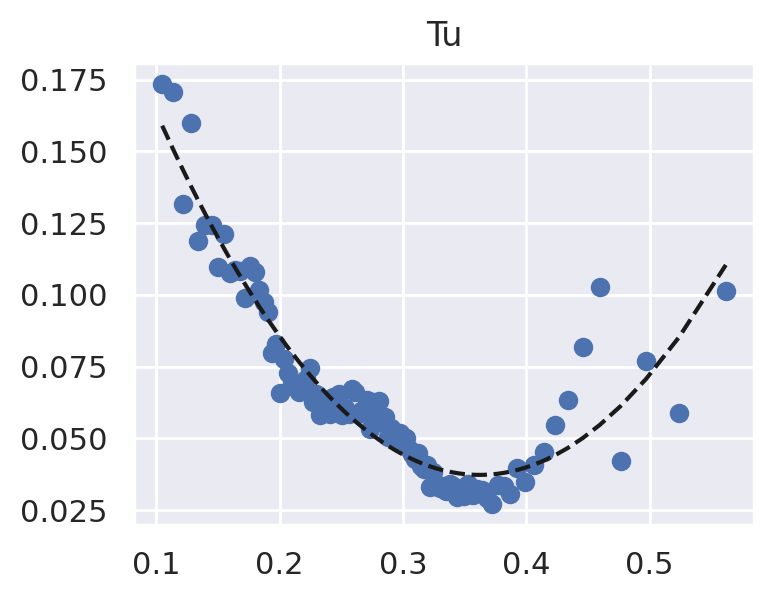

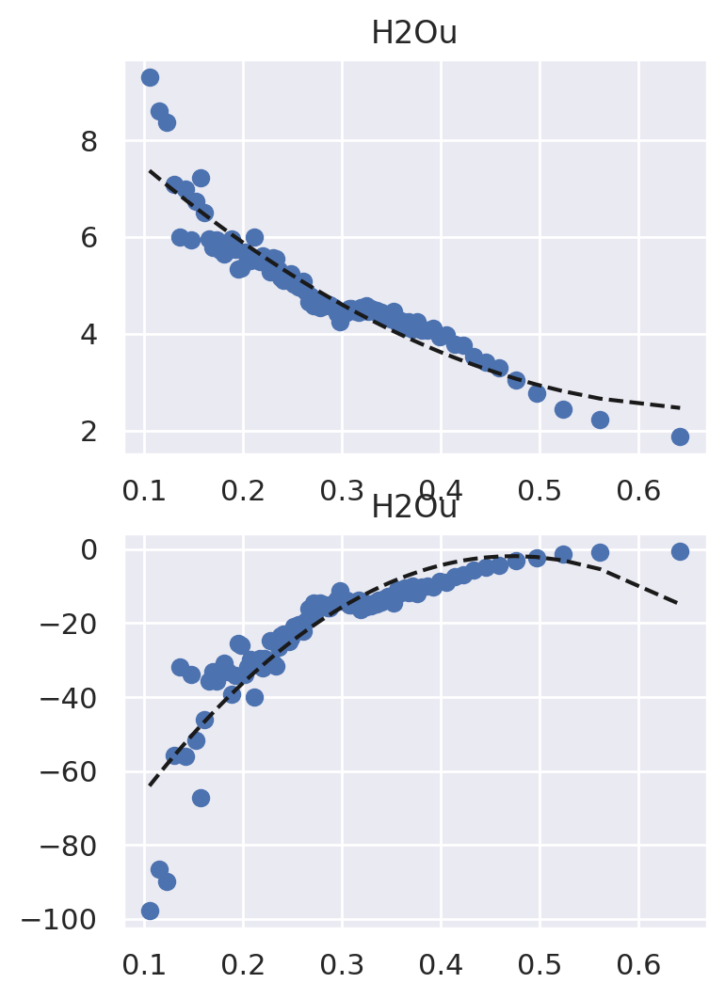

...

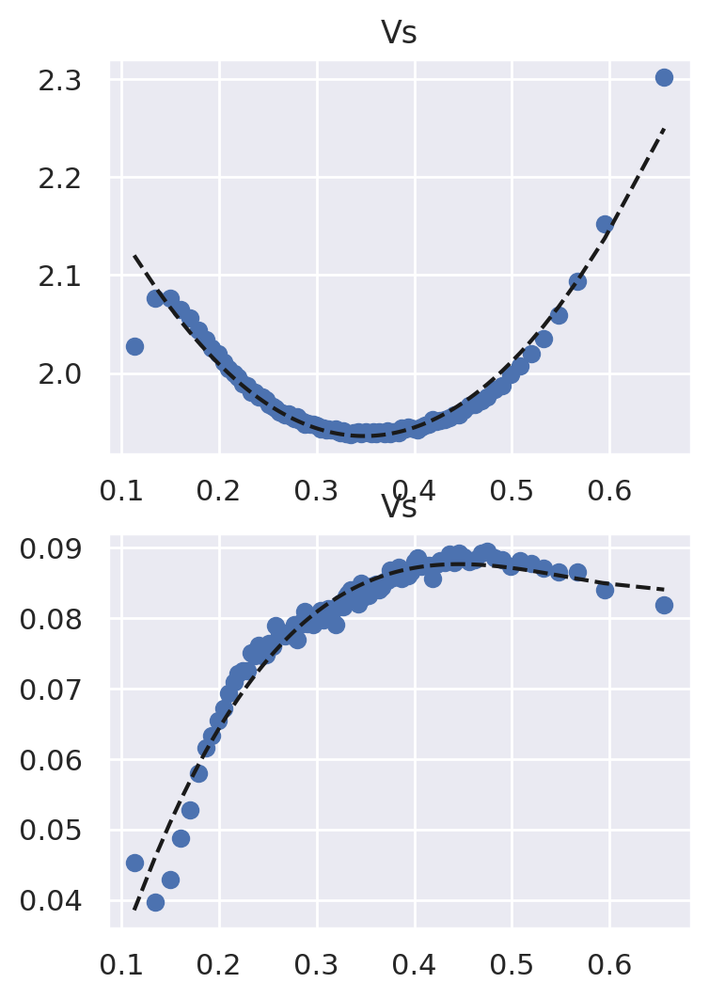

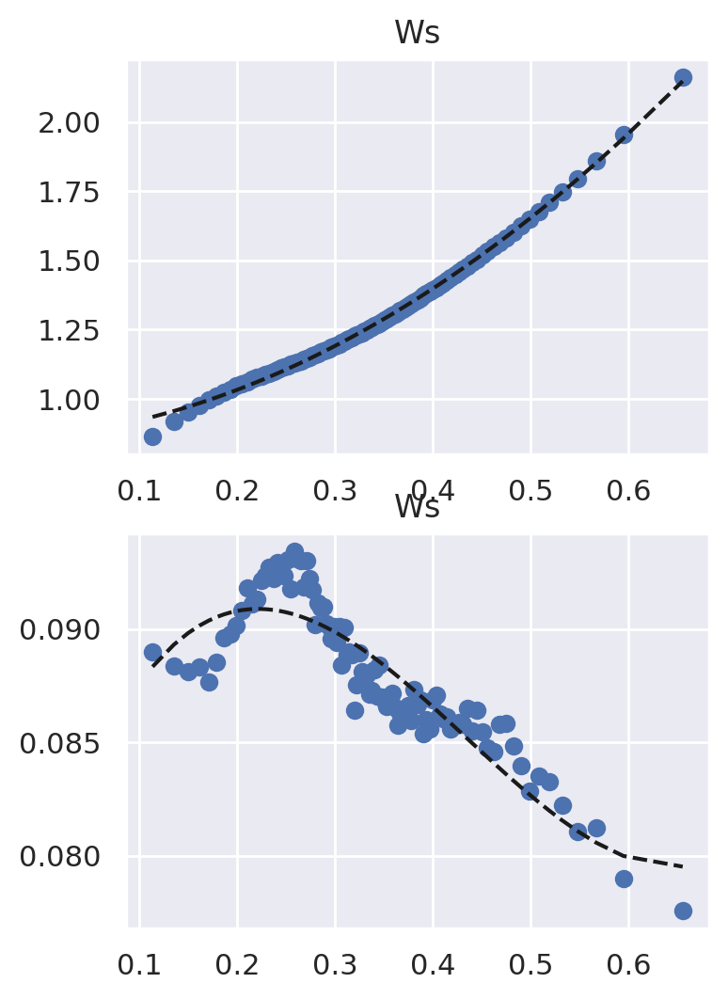

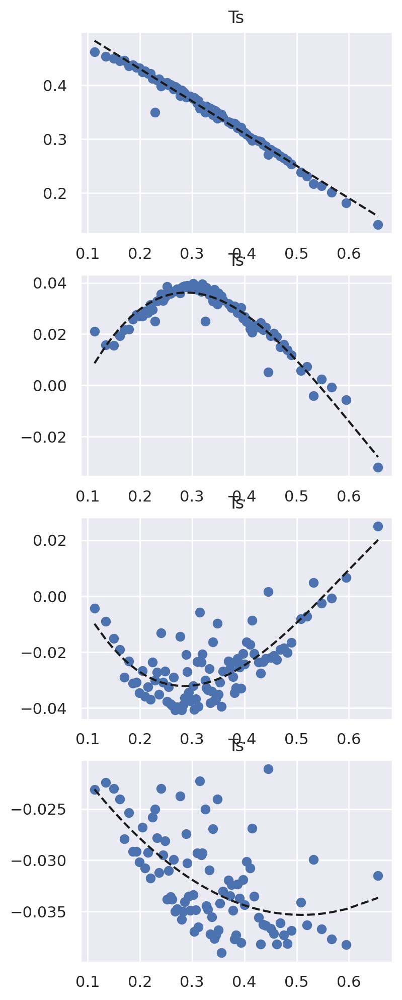

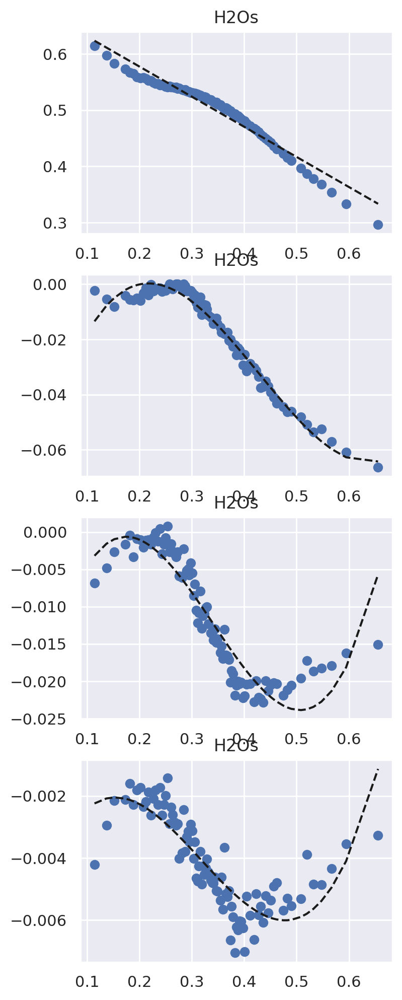

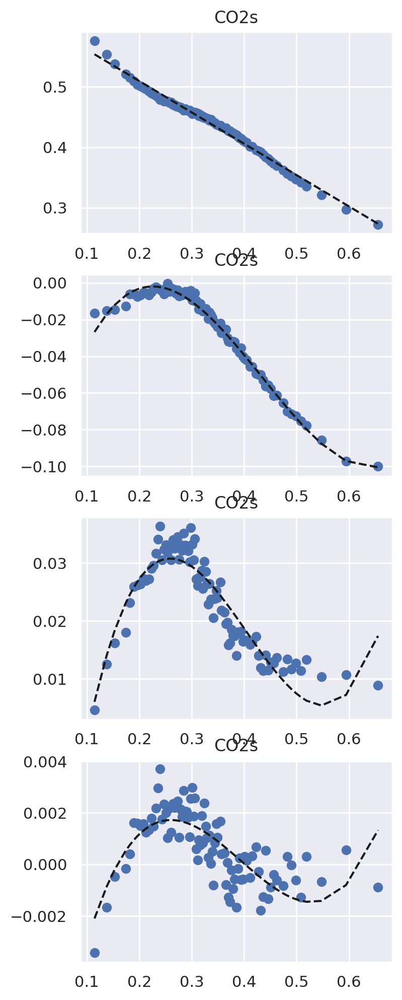

In [267]:
letters=['a','b','c','d']
for var in degs.keys():
    param=d_fit[var]['param']
    anibins=d_fit[var]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    m=~np.isnan(param[:,0])
    if var in maxs.keys():
        for mx in range(len(maxs[var])):
            m=m&(param[:,mx]<maxs[var][mx])
    x=anilvls[m]
    absz=anibins[1:]-anibins[0:-1]
    absz=absz[m]
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    print("'"+str(var)+"':{",end='')
    for i in range(len(pall)):
        y=param[:,i][m]
        c = P.polyfit(x,y,degs[var][i])
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls[m],param[:,i][m])
        if i>0:
            print(',',end='')
        print("'"+letters[i]+"':[",end='')
        for j in range(len(c)):
            print(str(c[j]),end='')
            if j<(len(c)-1):
                print(',',end='')
            else:
                print(']',end='')
        y2=c[0]+c[1]*x
        if degs[var][i]>1:
            y2=y2+c[2]*x**2
        if degs[var][i]>2:
            y2=y2+c[3]*x**3
        plt.plot(x,y2,'k--')
        #plt.ylim(np.nanpercentile(param[:,i],1)*.9,np.nanpercentile(param[:,i],99))
        plt.title(var)
    print('},')

(-0.01, 0.0)

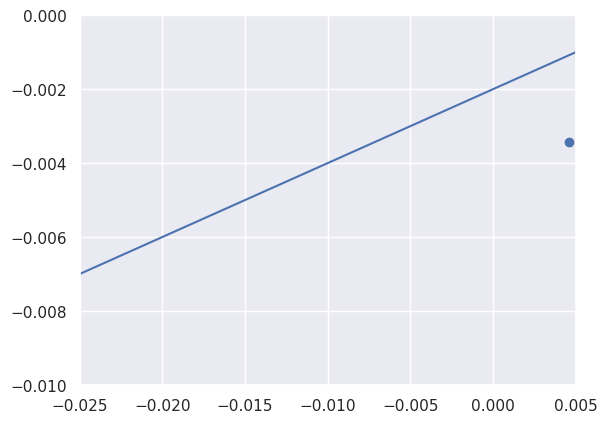

In [263]:
plt.scatter(param[:,2],param[:,3])
xx=np.linspace(-.025,.025)
plt.plot(xx,xx*.2-.002)
plt.xlim(-.025,.005)
plt.ylim(-.01,0)

(-0.025, 0.005)

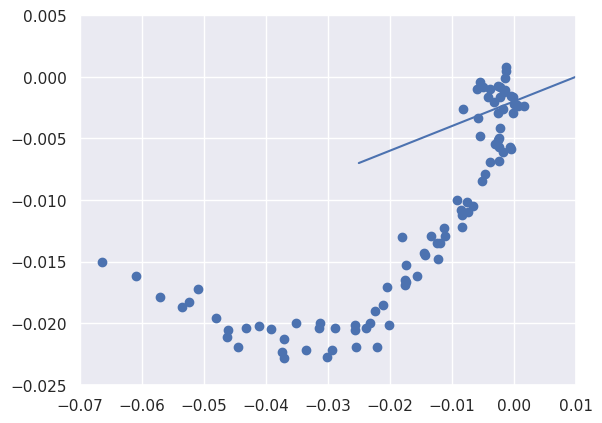

In [142]:
plt.scatter(param[:,1],param[:,2])
xx=np.linspace(-.025,.025)
plt.plot(xx,xx*.2-.002)
plt.xlim(-.07,.01)
plt.ylim(-.025,.005)

In [171]:
def C_ust(zL,a):
    #return a*(1+b*zL)**(-1/3)
    return a*(1-25*zL)**(-1/3)


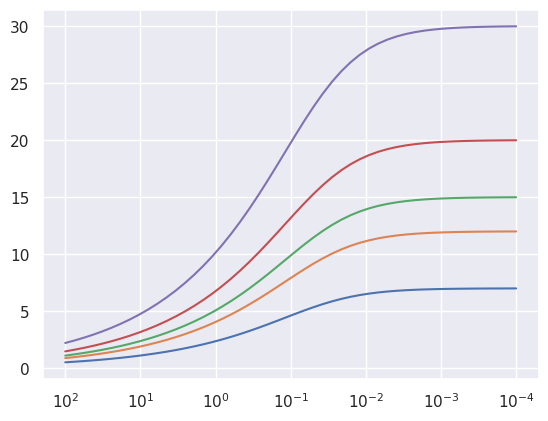

In [174]:
zll=-np.logspace(-4,2)
plt.semilogx(-zll,C_ust(zll,7))
plt.semilogx(-zll,C_ust(zll,12))
plt.semilogx(-zll,C_ust(zll,15))
plt.semilogx(-zll,C_ust(zll,20))
plt.semilogx(-zll,C_ust(zll,30))
plt.gca().invert_xaxis()

In [178]:
len(d_fit.keys())

12

# DSM/DTM/CHM

In [181]:
dsm_dir='/home/tsw35/soteria/data/NEON/dsm/_tifs/'
dtm_dir='/home/tsw35/soteria/data/NEON/dtm/_tifs/'

In [190]:
os.listdir(dtm_dir)

['GRSM_dtm.tif',
 'BARR_dtm.tif',
 'CPER_dtm.tif',
 'YELL_dtm.tif',
 'SOAP_dtm.tif',
 'KONA_dtm.tif',
 'UNDE_dtm.tif',
 'DEJU_dtm.tif',
 'SJER_dtm.tif',
 'DCFS_dtm.tif',
 'ORNL_dtm.tif',
 'ABBY_dtm.tif',
 'DSNY_dtm.tif',
 'DELA_dtm.tif',
 'MOAB_dtm.tif',
 'GUAN_dtm.tif',
 'WREF_dtm.tif',
 'STEI_dtm.tif',
 'TREE_dtm.tif',
 'UKFS_dtm.tif',
 'BONA_dtm.tif',
 'OSBS_dtm.tif',
 'TOOL_dtm.tif']

In [191]:
os.listdir(dsm_dir)

['YELL_dsm.tif',
 'SOAP_dsm.tif',
 'GRSM_dsm.tif',
 'CPER_dsm.tif',
 'BARR_dsm.tif',
 'DEJU_dsm.tif',
 'UNDE_dsm.tif',
 'KONA_dsm.tif',
 'DCFS_dsm.tif',
 'ORNL_dsm.tif',
 'SJER_dsm.tif',
 'DSNY_dsm.tif',
 'DELA_dsm.tif',
 'MOAB_dsm.tif',
 'ABBY_dsm.tif',
 'SERC_dsm.tif',
 'NOGP_dsm.tif',
 'BONA_dsm.tif',
 'OSBS_dsm.tif',
 'WREF_dsm.tif',
 'GUAN_dsm.tif',
 'STEI_dsm.tif',
 'TREE_dsm.tif',
 'UKFS_dsm.tif']

In [242]:
fp=h5py.File(indir+'NEON_TW_U_UVWT.h5','r')
fp.keys()

<KeysViewHDF5 ['ANI_XB', 'ANI_YB', 'CO2', 'CO2FX', 'CO2_SIGMA', 'DAY', 'G', 'H', 'H2O', 'H2O_SIGMA', 'LE', 'LW_IN', 'LW_OUT', 'L_MOST', 'NETRAD', 'P', 'PA', 'RH', 'RHO', 'SITE', 'SW_IN', 'SW_OUT', 'TA', 'TIME', 'T_SONIC', 'T_SONIC_SIGMA', 'U', 'USTAR', 'UU', 'UV', 'UW', 'U_SIGMA', 'Ustr', 'V', 'VPD', 'VPT', 'VV', 'VW', 'V_SIGMA', 'Vstr', 'W', 'WS', 'WTHETA', 'WW', 'W_SIGMA', 'Wstr', 'canopy_height', 'elevation', 'lat', 'lon', 'nlcd11', 'nlcd12', 'nlcd21', 'nlcd22', 'nlcd23', 'nlcd24', 'nlcd31', 'nlcd41', 'nlcd42', 'nlcd43', 'nlcd51', 'nlcd52', 'nlcd71', 'nlcd72', 'nlcd73', 'nlcd74', 'nlcd81', 'nlcd82', 'nlcd90', 'nlcd95', 'nlcd_dom', 'tow_height', 'utc_off', 'zd']>

In [245]:
sites=np.unique(fp['SITE'][:])
lats={}
lons={}
tows={}
for site0 in sites:
    site=str(site0)[2:-1]
    m=fp['SITE'][:]==site0
    lats[site]=fp['lat'][m][0]
    lons[site]=fp['lon'][m][0]
    tows[site]=fp['tow_height'][m][0]

In [189]:
import rasterio

In [192]:
idx=np.where(sites=='ABBY')

In [202]:
site='ABBY'
idx=np.where(sites==site.encode('UTF-8'))[0][0]
fp=rasterio.open('/home/tsw35/soteria/data/NEON/dsm/_tifs/'+site+'_dsm.tif')
data=fp.read(1)
xx,yy=fp.index(lons[idx],lats[idx])
data[data<0]=float('nan')
dsm=data[xx-2000:xx+2000,yy-2000:yy+2000]
fp=rasterio.open('/home/tsw35/soteria/data/NEON/dtm/_tifs/'+site+'_dtm.tif')
data=fp.read(1)
xx,yy=fp.index(lons[idx],lats[idx])
data[data<0]=float('nan')
dtm=data[xx-2000:xx+2000,yy-2000:yy+2000]
chm=dsm-dtm
print(np.std(dsm))
print(np.std(dtm))
print(np.std(chm))

68.810265
67.50519
13.358141


In [212]:
sig_dsm={}
sig_dtm={}
sig_chm={}
ani_u={}
ani_s={}
sites_in=[]
#ss_u={}
#ss_s={}
for site0 in sites:
    site=str(site0)[2:-1]
    print(site,end=',')
    ani_u[site]=d_ani_ust[site]['yb']['full']['median']
    ani_s[site]=d_ani_stb[site]['yb']['full']['median']
    sites_in.append(site)
    fp=rasterio.open('/home/tsw35/soteria/data/NEON/dsm/_tifs/'+site+'_dsm.tif')
    data=fp.read(1)
    xx,yy=fp.index(lons[site],lats[site])
    data[data<0]=float('nan')
    dsm=data[xx-2000:xx+2000,yy-2000:yy+2000]
    fp=rasterio.open('/home/tsw35/soteria/data/NEON/dtm/_tifs/'+site+'_dtm.tif')
    data=fp.read(1)
    xx,yy=fp.index(lons[site],lats[site])
    data[data<0]=float('nan')
    dtm=data[xx-2000:xx+2000,yy-2000:yy+2000]
    chm=dsm-dtm
    sig_dsm[site]=np.nanstd(dsm)
    sig_dtm[site]=np.nanstd(dtm)
    sig_chm[site]=np.nanstd(chm)

ABBY,BARR,BART,BLAN,BONA,CLBJ,CPER,DCFS,DEJU,DELA,DSNY,GRSM,GUAN,HARV,HEAL,JERC,JORN,KONA,KONZ,LAJA,LENO,MLBS,MOAB,NIWO,NOGP,OAES,ONAQ,ORNL,OSBS,PUUM,RMNP,SCBI,SERC,SJER,SOAP,SRER,STEI,

/stor/soteria/hydro/private/tsw35/software/miniconda/envs/jenv/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


STER,TALL,TEAK,TOOL,TREE,UKFS,UNDE,WOOD,WREF,YELL,

In [213]:
print(sig_dsm)
print()
print(sig_dtm)
print()
print(sig_chm)

{'ABBY': 68.810265, 'BARR': 1.9357907, 'BART': 93.49701, 'BLAN': 9.830146, 'BONA': 125.8275, 'CLBJ': 12.345337, 'CPER': 9.308821, 'DCFS': 20.139002, 'DEJU': 28.84339, 'DELA': 9.64386, 'DSNY': 5.154887, 'GRSM': 110.06048, 'GUAN': 61.176243, 'HARV': 27.139366, 'HEAL': 75.396286, 'JERC': 8.731858, 'JORN': 4.723422, 'KONA': 26.386044, 'KONZ': 26.856789, 'LAJA': 6.9870534, 'LENO': 12.000937, 'MLBS': 80.65106, 'MOAB': 33.593365, 'NIWO': 114.98512, 'NOGP': 11.918743, 'OAES': 13.990836, 'ONAQ': 28.982918, 'ORNL': 31.701296, 'OSBS': 10.324455, 'PUUM': 89.462364, 'RMNP': 114.17059, 'SCBI': 78.13488, 'SERC': 15.168535, 'SJER': 44.64709, 'SOAP': 114.08914, 'SRER': 29.227484, 'STEI': nan, 'STER': 5.638673, 'TALL': 23.096083, 'TEAK': 128.07854, 'TOOL': 34.194275, 'TREE': 14.203682, 'UKFS': 23.62557, 'UNDE': 13.276412, 'WOOD': 9.882522, 'WREF': 112.56092, 'YELL': 77.05183}

{'ABBY': 67.50519, 'BARR': 1.9327592, 'BART': 91.40004, 'BLAN': 7.50107, 'BONA': 124.365974, 'CLBJ': 11.6895485, 'CPER': 9.30903

In [74]:
def nlcd_plot2(sites,sortr,colr,txtr):
    # sites is list, sortr,colr,txtr are dictionaries
    d_r={}
    for site in sites:
        d_r[sortr[site]]=site
    
    r_str=list(d_r.keys())
    r_str.sort()
    r_sit=[]
    r_clr=[]
    r_txt=[]
    for i in r_str:
        site=d_r[i]
        r_sit.append(site)
        r_clr.append(colr[site])
        r_txt.append(txtr[site])
    
    return r_sit,r_str,r_clr,r_txt
    

In [77]:
sig_dsm={'ABBY': 68.810265, 'BARR': 1.9357907, 'BART': 93.49701, 'BLAN': 9.830146, 'BONA': 125.8275, 'CLBJ': 12.345337, 'CPER': 9.308821, 'DCFS': 20.139002, 'DEJU': 28.84339, 'DELA': 9.64386, 'DSNY': 5.154887, 'GRSM': 110.06048, 'GUAN': 61.176243, 'HARV': 27.139366, 'HEAL': 75.396286, 'JERC': 8.731858, 'JORN': 4.723422, 'KONA': 26.386044, 'KONZ': 26.856789, 'LAJA': 6.9870534, 'LENO': 12.000937, 'MLBS': 80.65106, 'MOAB': 33.593365, 'NIWO': 114.98512, 'NOGP': 11.918743, 'OAES': 13.990836, 'ONAQ': 28.982918, 'ORNL': 31.701296, 'OSBS': 10.324455, 'PUUM': 89.462364, 'RMNP': 114.17059, 'SCBI': 78.13488, 'SERC': 15.168535, 'SJER': 44.64709, 'SOAP': 114.08914, 'SRER': 29.227484, 'STEI': float('nan'), 'STER': 5.638673, 'TALL': 23.096083, 'TEAK': 128.07854, 'TOOL': 34.194275, 'TREE': 14.203682, 'UKFS': 23.62557, 'UNDE': 13.276412, 'WOOD': 9.882522, 'WREF': 112.56092, 'YELL': 77.05183}

In [79]:
for site in sig_dsm.keys():
    print(site+': '+str(sig_dsm[site]))

ABBY: 68.810265
BARR: 1.9357907
BART: 93.49701
BLAN: 9.830146
BONA: 125.8275
CLBJ: 12.345337
CPER: 9.308821
DCFS: 20.139002
DEJU: 28.84339
DELA: 9.64386
DSNY: 5.154887
GRSM: 110.06048
GUAN: 61.176243
HARV: 27.139366
HEAL: 75.396286
JERC: 8.731858
JORN: 4.723422
KONA: 26.386044
KONZ: 26.856789
LAJA: 6.9870534
LENO: 12.000937
MLBS: 80.65106
MOAB: 33.593365
NIWO: 114.98512
NOGP: 11.918743
OAES: 13.990836
ONAQ: 28.982918
ORNL: 31.701296
OSBS: 10.324455
PUUM: 89.462364
RMNP: 114.17059
SCBI: 78.13488
SERC: 15.168535
SJER: 44.64709
SOAP: 114.08914
SRER: 29.227484
STEI: nan
STER: 5.638673
TALL: 23.096083
TEAK: 128.07854
TOOL: 34.194275
TREE: 14.203682
UKFS: 23.62557
UNDE: 13.276412
WOOD: 9.882522
WREF: 112.56092
YELL: 77.05183


In [75]:
st,an,sg,_=nlcd_plot2(sites_in,ani_s,sig_dsm,sig_chm)

NameError: name 'sites_in' is not defined

In [239]:
cmap=plt.get_cmap('bone')

(0.25, 0.38)

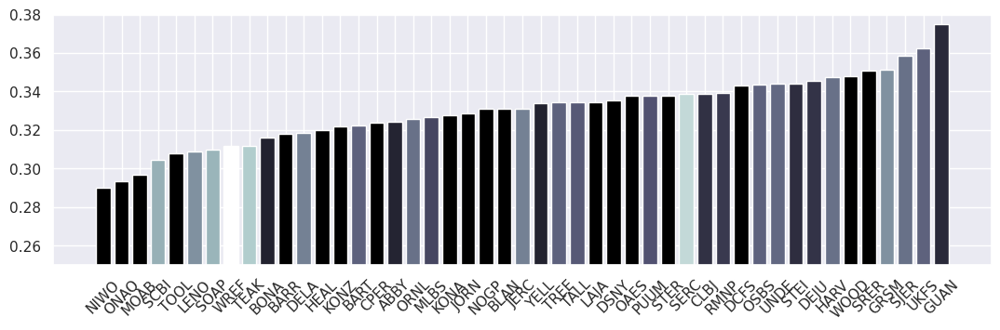

In [247]:
a=1
_, ax = plt.subplots(figsize=(13*a,3.5*a))
sgnorm=sg-np.nanmin(sg)
sgnorm=sgnorm/np.nanmax(sgnorm)
plt.bar(st,an,color=cmap(sgnorm))
ax.set_xticks(np.linspace(0,46,47),st)
ax.tick_params(axis='x',labelrotation=45)
plt.ylim(.25,.38)

In [64]:
d_fit=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_HCuv1.p','rb'))

In [71]:
degs={'H2Ou':[3],'CO2u':[3]}
mins={}
maxs={}
#maxs={'Tu':[.75],'H2Ou':[14],'CO2u':[40],'Ts':[100,100,100,10],'H2Os':[100,100,.025,.02],'CO2s':[100,100,125,.02]}

'H2Ou':{'a':[7.383821157007216,-16.816367865048143,36.85379157148182,-22.552696633480064]},
'CO2u':{'a':[11.627039011171679,-55.75662476948497,132.1688475947626,-91.53182129882329]},


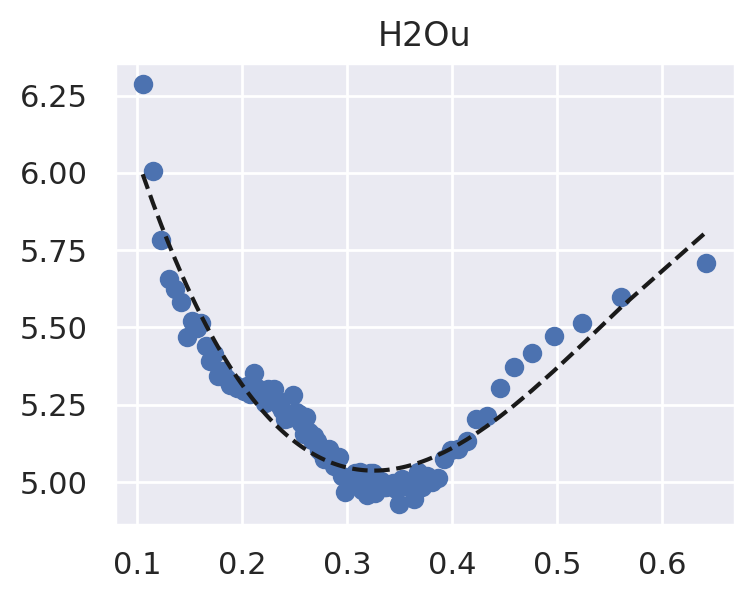

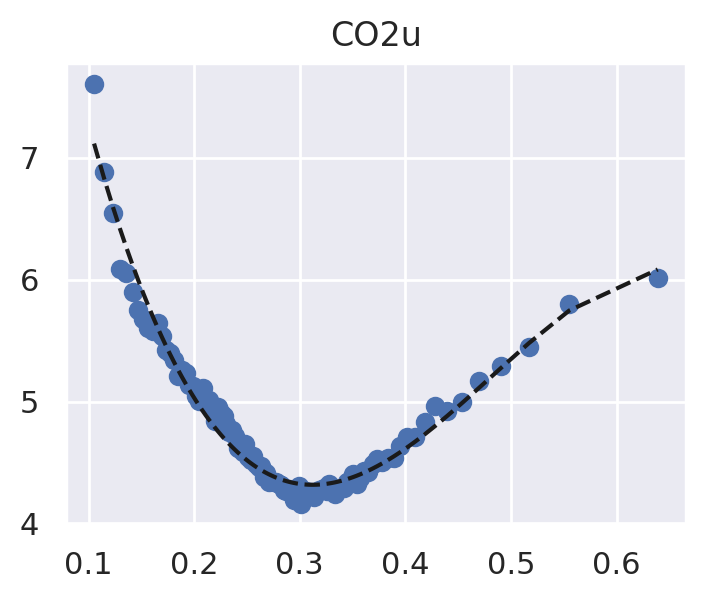

In [72]:
letters=['a','b','c','d']
for var in degs.keys():
    param=d_fit[var]['param']
    anibins=d_fit[var]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    m=~np.isnan(param[:,0])
    if var in maxs.keys():
        for mx in range(len(maxs[var])):
            m=m&(param[:,mx]<maxs[var][mx])
    x=anilvls[m]
    absz=anibins[1:]-anibins[0:-1]
    absz=absz[m]
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    print("'"+str(var)+"':{",end='')
    for i in range(len(pall)):
        y=param[:,i][m]
        c = P.polyfit(x,y,degs[var][i])
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls[m],param[:,i][m])
        if i>0:
            print(',',end='')
        print("'"+letters[i]+"':[",end='')
        for j in range(len(c)):
            print(str(c[j]),end='')
            if j<(len(c)-1):
                print(',',end='')
            else:
                print(']',end='')
        y2=c[0]+c[1]*x
        if degs[var][i]>1:
            y2=y2+c[2]*x**2
        if degs[var][i]>2:
            y2=y2+c[3]*x**3
        plt.plot(x,y2,'k--')
        #plt.ylim(np.nanpercentile(param[:,i],1)*.9,np.nanpercentile(param[:,i],99))
        plt.title(var)
    print('},')

In [53]:
np.nanmedian(param[:,2])

-0.6699999999979602

In [58]:
np.nanmedian(d_fit['H2Ou']['param'][:,1])

-1.4440274340202688

In [201]:
d_ss=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_stbl_site_v0.p','rb'))
d_us=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_unst_site_v0.p','rb'))

In [8]:
d_us['U'].keys()

dict_keys(['p_phi', 'p_zL', 'p_cnt', 'p_ani'])

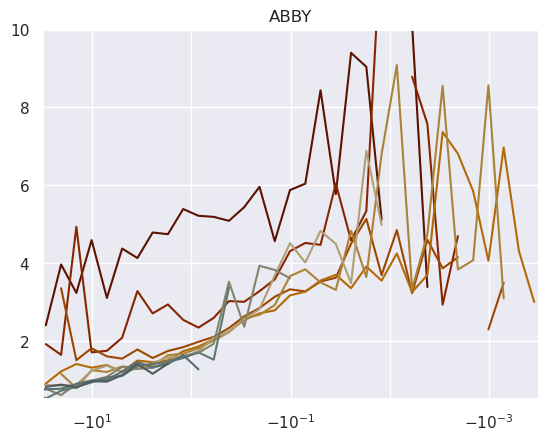

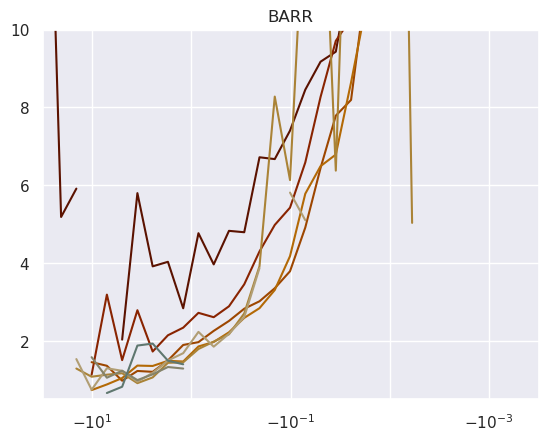

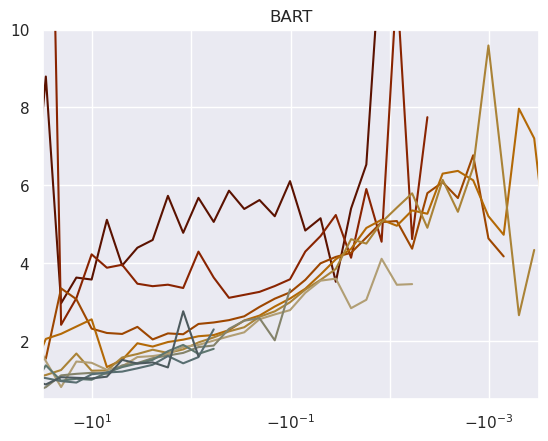

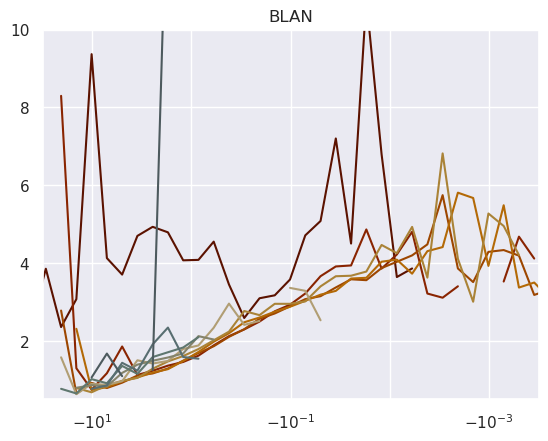

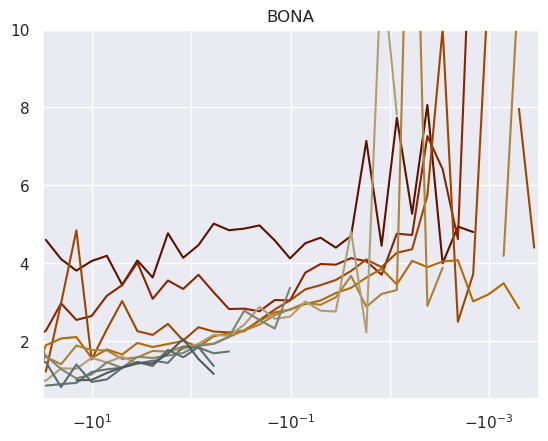

...

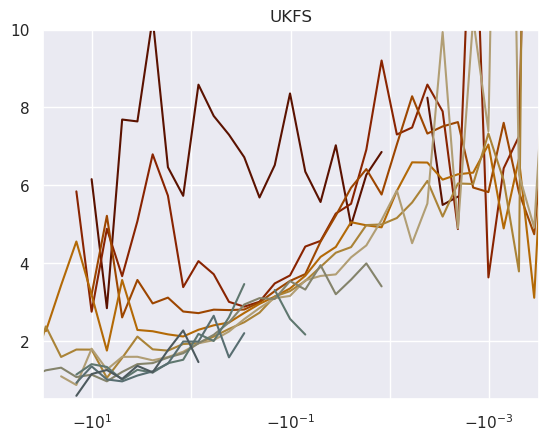

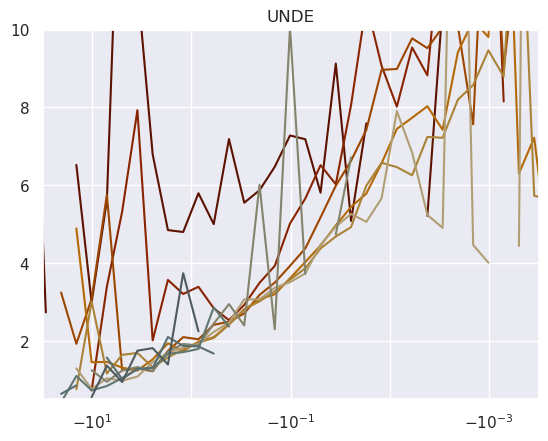

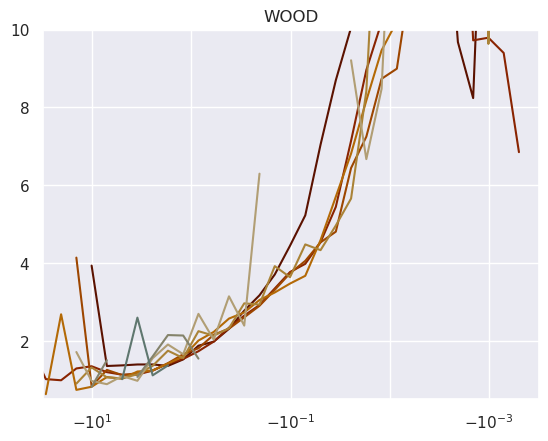

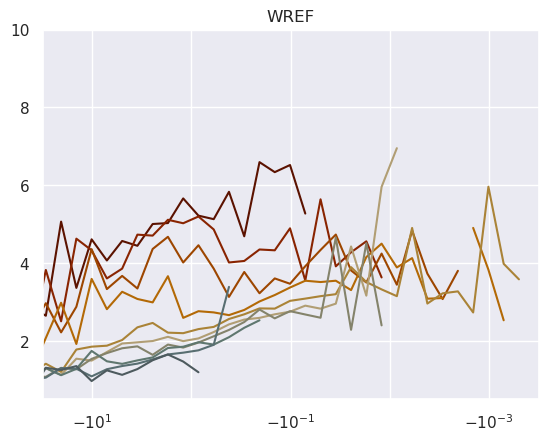

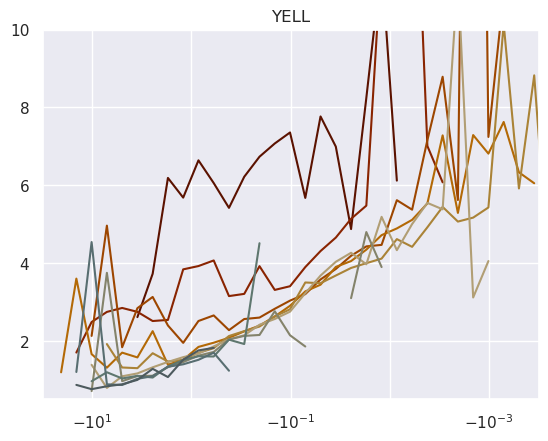

In [207]:
v='H2O'
n=0
for site in d_us[v]['p_ani'].keys():
    plt.figure()
    cc=cani_norm(d_us[v]['p_ani'][site])
    xx=d_us[v]['p_zL'][site][:]
    yy=d_us[v]['p_phi'][site][:]
    for i in range(len(cc)):
        #plt.loglog(-xx,yy[i,:],color=cc[i,:])
        plt.semilogx(-xx,yy[i,:],color=cc[i,:])
    plt.title(site)
    plt.xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
    plt.xlim(10**(-3.5),10**(1.5))
    plt.ylim(.5,10)
    plt.gca().invert_xaxis()
    

-7.506233768229831

In [41]:
yy.shape

(10, 38)

In [50]:
yy[i,:].shape

(38,)

In [52]:
xx

array([-8.50851914e+01, -5.97046046e+01, -4.18949496e+01, -2.93978466e+01,
       -2.06285815e+01, -1.44751546e+01, -1.01572714e+01, -7.12739624e+00,
       -5.00132123e+00, -3.50944625e+00, -2.46259187e+00, -1.72801015e+00,
       -1.21255134e+00, -8.50851914e-01, -5.97046046e-01, -4.18949496e-01,
       -2.93978466e-01, -2.06285815e-01, -1.44751546e-01, -1.01572714e-01,
       -7.12739624e-02, -5.00132123e-02, -3.50944625e-02, -2.46259187e-02,
       -1.72801015e-02, -1.21255134e-02, -8.50851914e-03, -5.97046046e-03,
       -4.18949496e-03, -2.93978466e-03, -2.06285815e-03, -1.44751546e-03,
       -1.01572714e-03, -7.12739624e-04, -5.00132123e-04, -3.50944625e-04,
       -2.46259187e-04, -1.72801015e-04])

In [167]:
d_log=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_scalarlog.p','rb'))
d_C=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_scalarC.p','rb'))

In [168]:
d_fit=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_fit_scalar2.p','rb'))

In [169]:
d_fit['CO27']=d_log['CO27']
d_fit['H2O7']=d_log['H2O7']
d_fit['CO24']=d_C['CO24']
d_fit['CO26']=d_C['CO26']

In [174]:
degs={'T2':[2,1],'T3':[3,3],'T4':[2,1],'T5':[3,3,3],'T6':[3,1],'T7':[3,3],\
      'H2O2':[1,2],'H2O3':[3,3,3],'H2O4':[2,2],'H2O5':[3,3],'H2O6':[3,2],'H2O7':[3,3],\
      'CO22':[1,3],'CO23':[3,3,3],'CO24':[2,1],'CO25':[2,1],'CO26':[2,1],'CO27':[3,3]}
mins={}
maxs={}

'T2':{'a':[0.0016086400426415747,-0.009046112626421346,0.01674919857041958],'b':[3.1069569610314867,-2.721337687613489]},
'T3':{'a':[3.817709220055608,-7.473760573874225,10.68634838019546,-7.025544971110323],'b':[0.02447044229928632,-0.14745178845621343,0.42535783717801423,-0.3239796865035902]},
'T4':{'a':[0.014058713018066155,-0.06846731062292509,0.13165525017433005],'b':[3.04131851476864,-2.719792181824897]},
'T5':{'a':[0.0027252543145951896,0.007027843331210413,-0.09196590181888623,0.2007361171500964],'b':[-1.1780935040635225,-0.08447995241669148,0.5614236224538129,-0.037235841944141534],'c':[3.4996684250079277,-6.108768265650669,8.098673174827468,-5.931630938506805]},
'T6':{'a':[0.4976992048433562,-2.928653210710675,6.925549603692723,-4.14831462620025],'b':[2.9179364060632915,-2.94339427218065]},
'T7':{'a':[3.839115631186413,-7.649826422085375,11.027420453875179,-7.042463168602552],'b':[0.14869411390544263,-1.1222215055483538,3.0368093230353854,-2.089468545484071]},
'H2O2':{'a':[4.

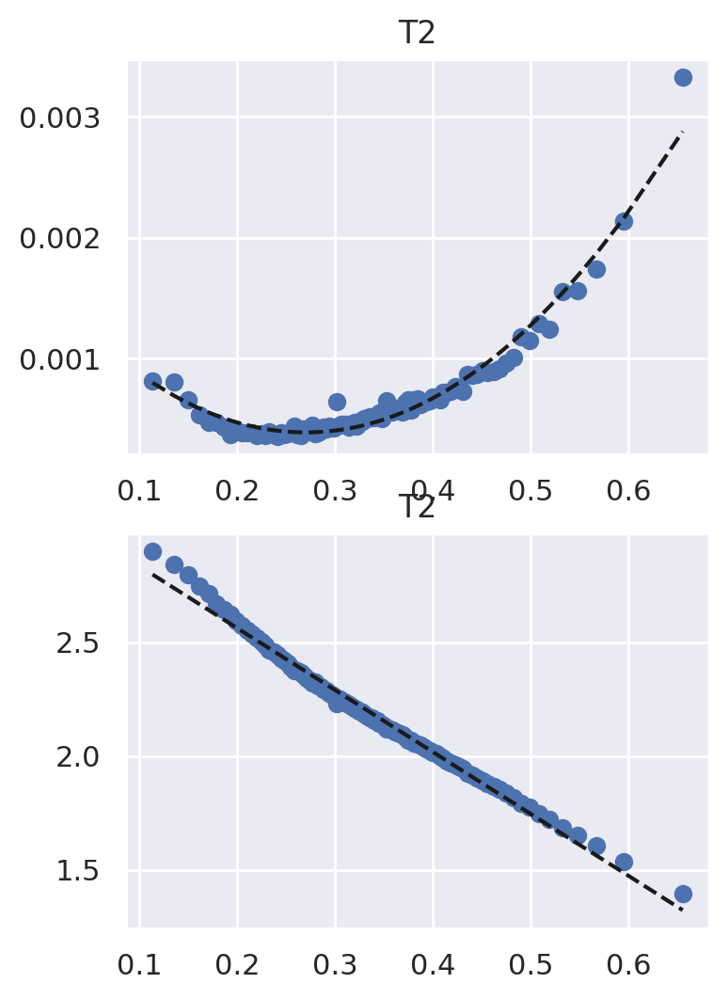

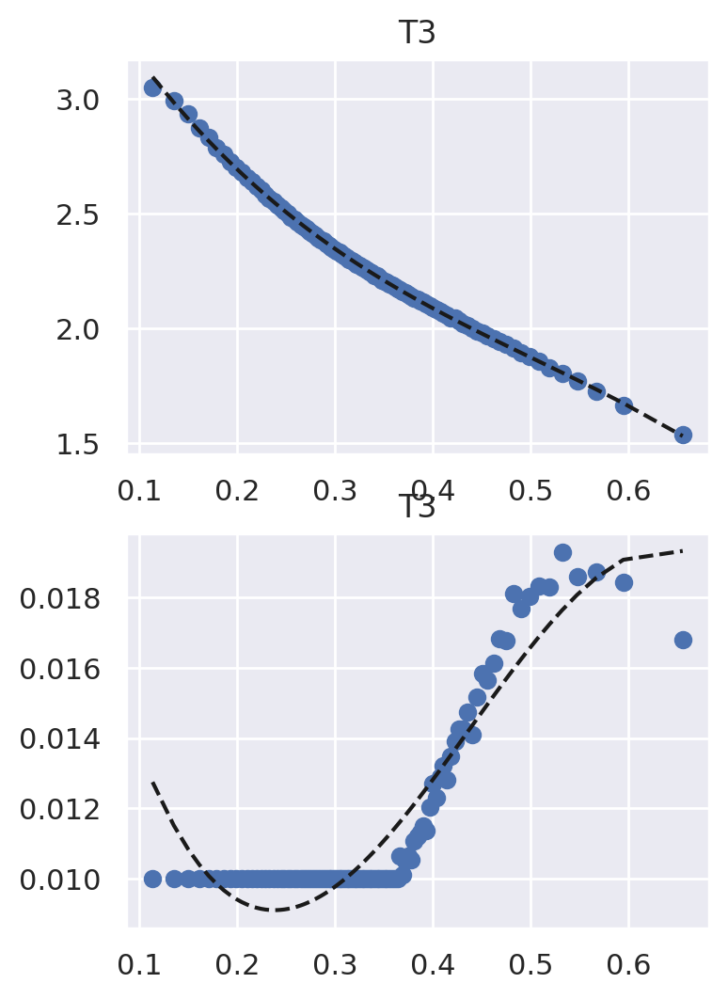

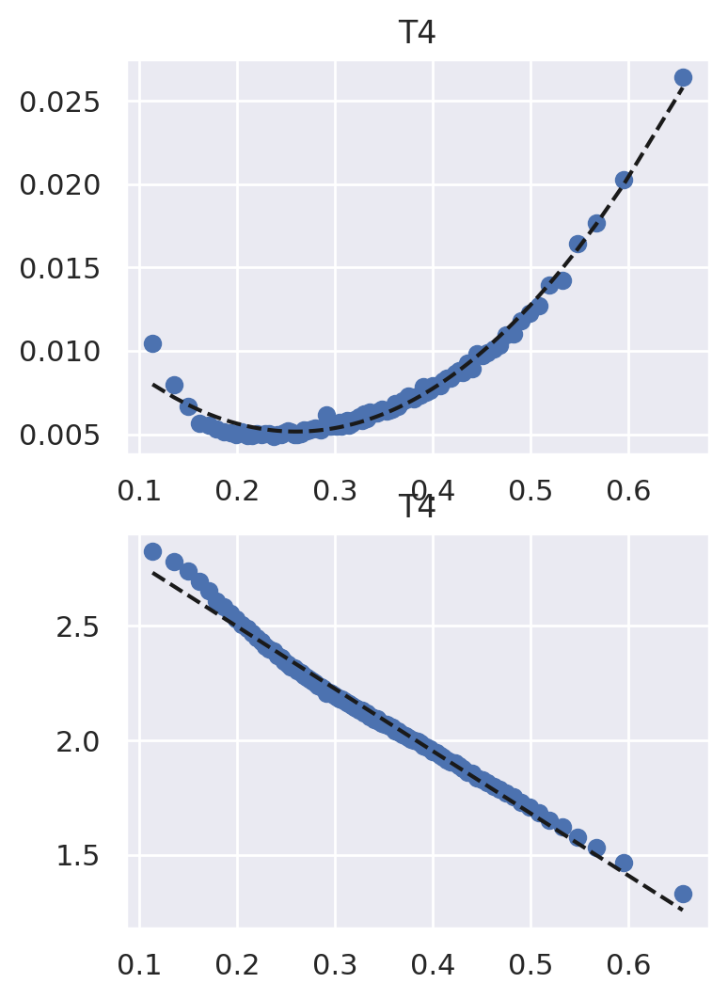

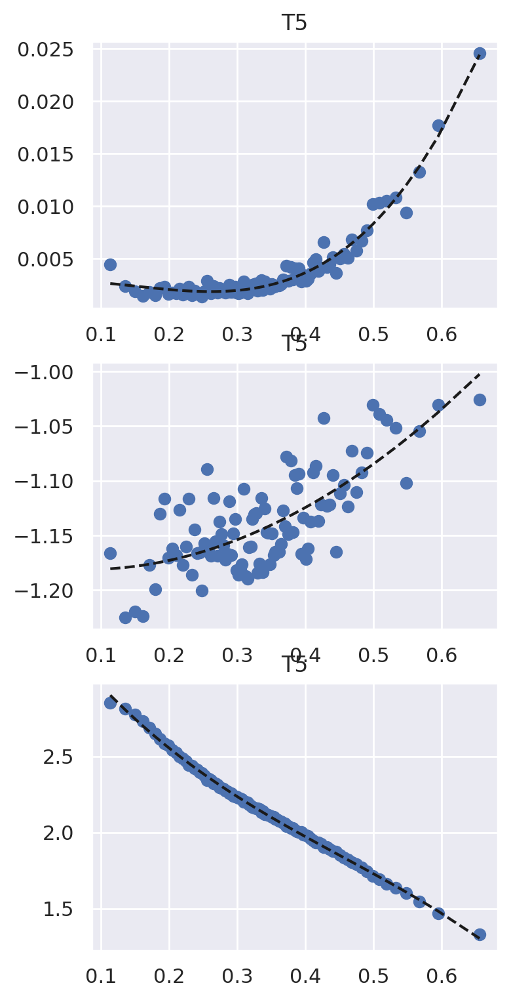

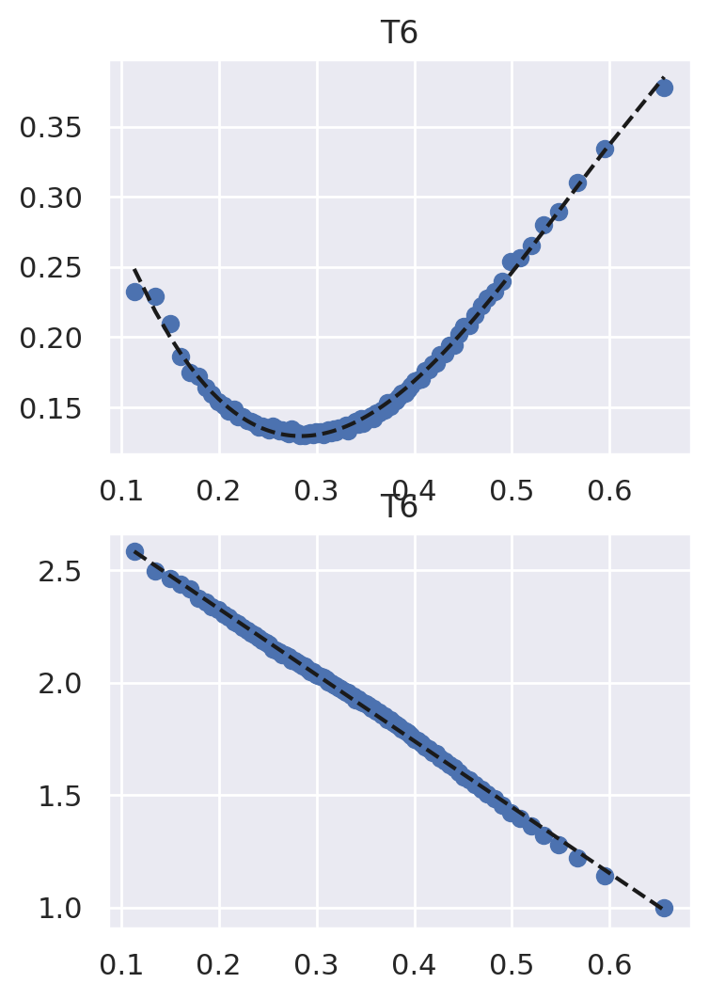

...

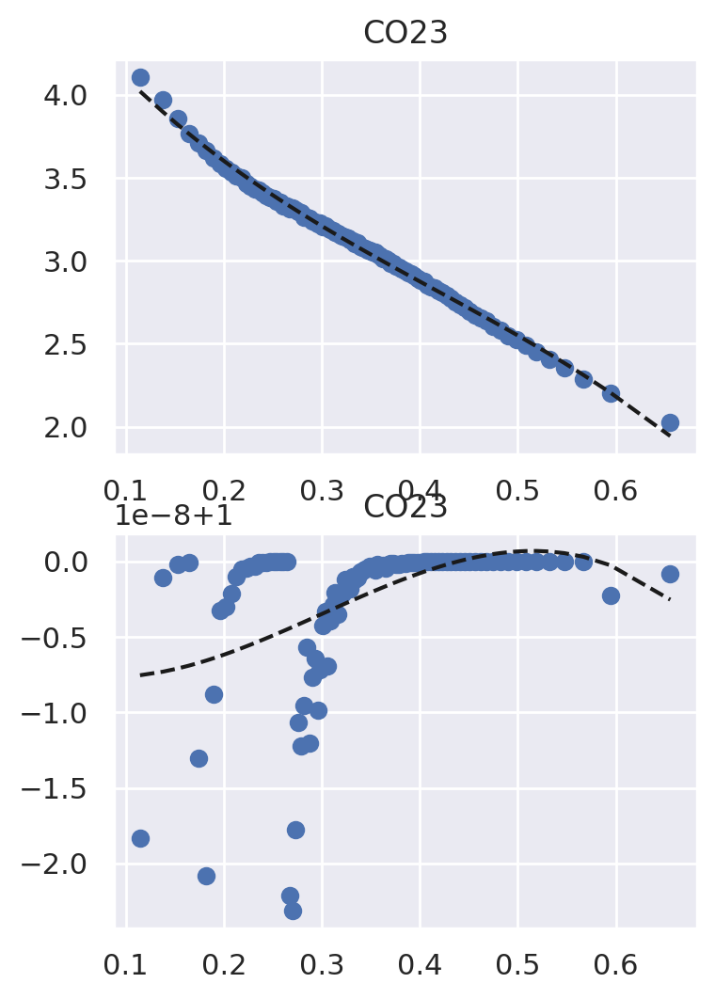

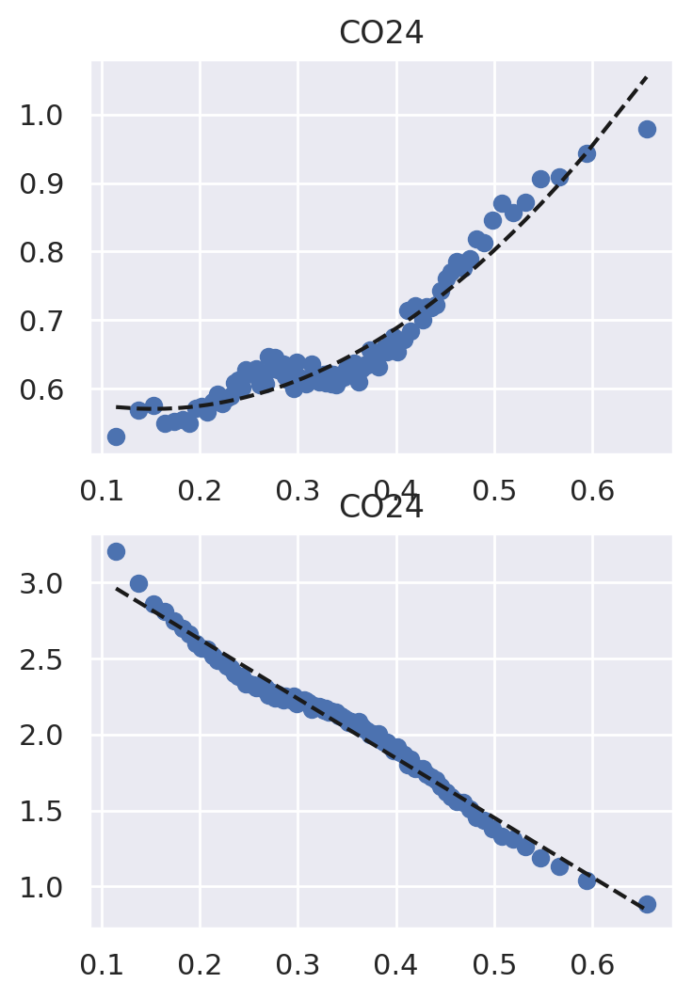

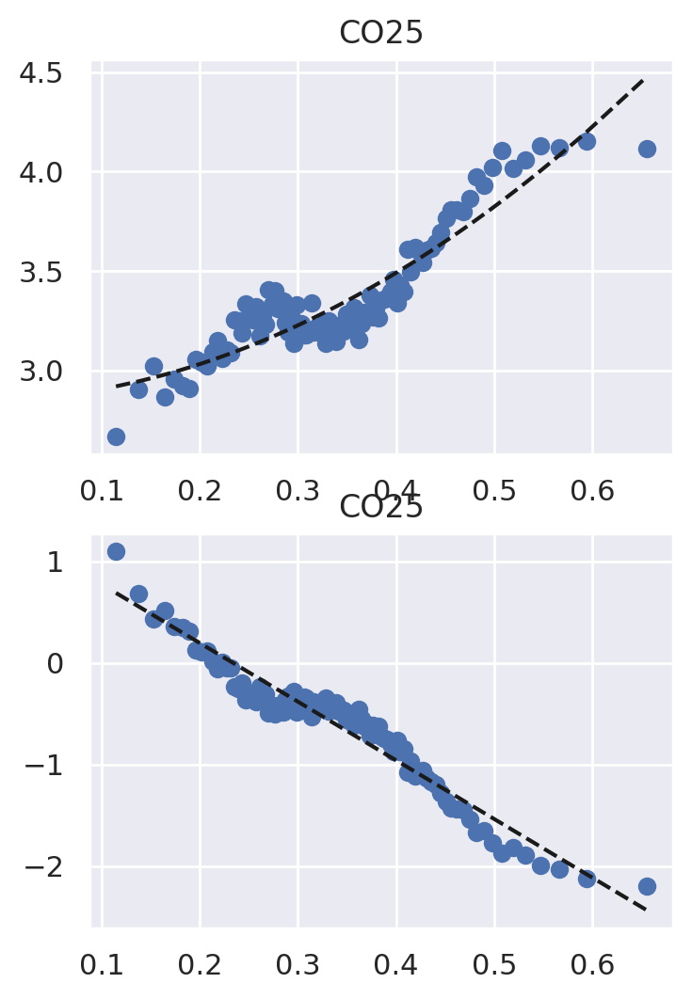

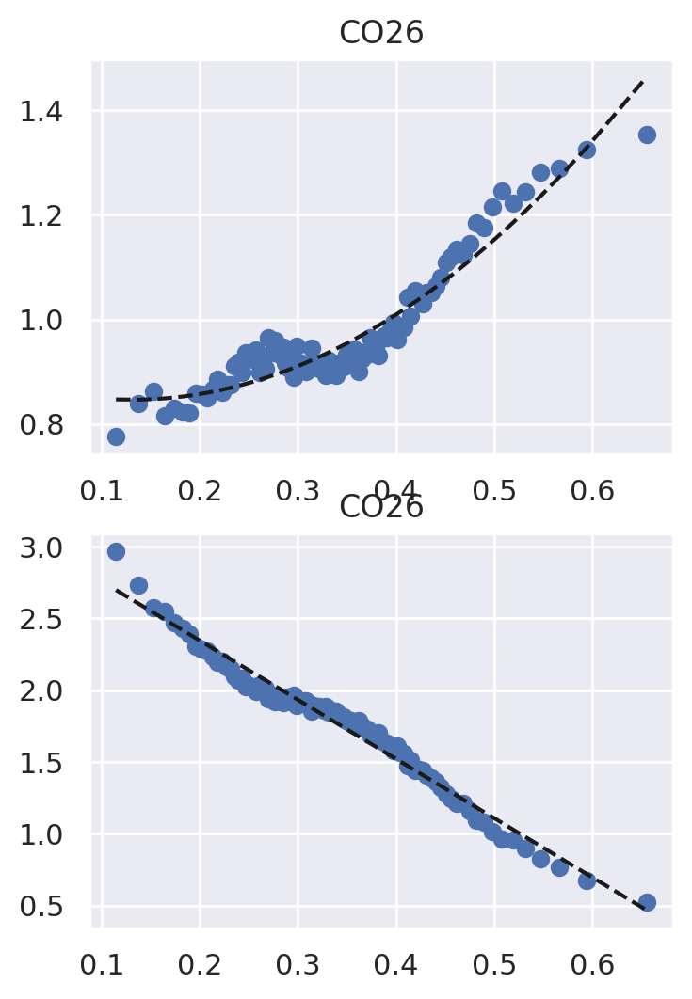

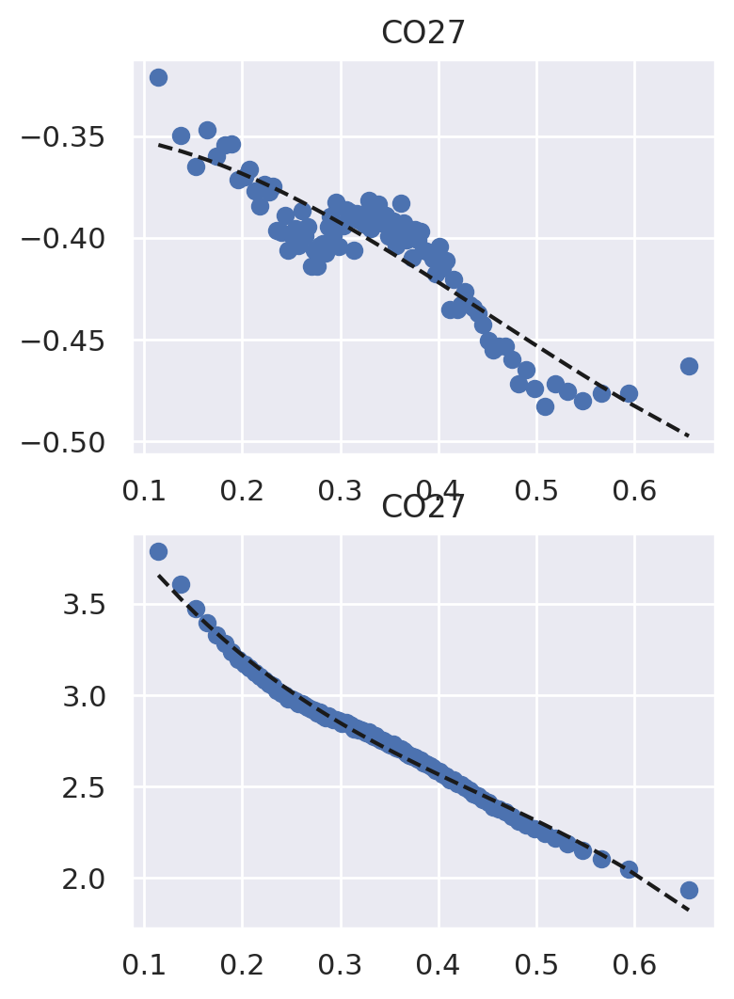

In [175]:
letters=['a','b','c','d']
for var in degs.keys():
    param=d_fit[var]['param']
    anibins=d_fit[var]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    m=~np.isnan(param[:,0])
    if var in maxs.keys():
        for mx in range(len(maxs[var])):
            m=m&(param[:,mx]<maxs[var][mx])
    x=anilvls[m]
    absz=anibins[1:]-anibins[0:-1]
    absz=absz[m]
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    print("'"+str(var)+"':{",end='')
    for i in range(len(pall)):
        y=param[:,i][m]
        c = P.polyfit(x,y,degs[var][i])
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls[m],param[:,i][m])
        if i>0:
            print(',',end='')
        print("'"+letters[i]+"':[",end='')
        for j in range(len(c)):
            print(str(c[j]),end='')
            if j<(len(c)-1):
                print(',',end='')
            else:
                print(']',end='')
        y2=c[0]+c[1]*x
        if degs[var][i]>1:
            y2=y2+c[2]*x**2
        if degs[var][i]>2:
            y2=y2+c[3]*x**3
        if degs[var][i]>3:
            y2=y2+c[4]*x**4
        plt.plot(x,y2,'k--')
        #plt.ylim(np.nanpercentile(param[:,i],1)*.9,np.nanpercentile(param[:,i],99))
        plt.title(var)
    print('},')

In [176]:
prms={'T2':{'a':[0.0016086400426415747,-0.009046112626421346,0.01674919857041958],'b':[3.1069569610314867,-2.721337687613489]},
'T3':{'a':[3.817709220055608,-7.473760573874225,10.68634838019546,-7.025544971110323],'b':[0.02447044229928632,-0.14745178845621343,0.42535783717801423,-0.3239796865035902]},
'T4':{'a':[0.014058713018066155,-0.06846731062292509,0.13165525017433005],'b':[3.04131851476864,-2.719792181824897]},
'T5':{'a':[0.0027252543145951896,0.007027843331210413,-0.09196590181888623,0.2007361171500964],'b':[-1.1780935040635225,-0.08447995241669148,0.5614236224538129,-0.037235841944141534],'c':[3.4996684250079277,-6.108768265650669,8.098673174827468,-5.931630938506805]},
'T6':{'a':[0.4976992048433562,-2.928653210710675,6.925549603692723,-4.14831462620025],'b':[2.9179364060632915,-2.94339427218065]},
'T7':{'a':[3.839115631186413,-7.649826422085375,11.027420453875179,-7.042463168602552],'b':[0.14869411390544263,-1.1222215055483538,3.0368093230353854,-2.089468545484071]},
'H2O2':{'a':[4.449311924864436,-3.3938685113439004],'b':[-0.004799144374535944,0.013445137767661895,0.42770933832593444]},
'H2O3':{'a':[4.516964373063404,-4.678113366682572,5.568586331475535,-6.724319316848667],'b':[1.939228279791965,-20.013030457028464,65.73647069042104,-57.93802424528405]},
'H2O4':{'a':[0.17164376117746769,-0.959576303167761,1.7094510064278852],'b':[3.8863009623656986,-0.38722338061937195,-4.991252724918581]},
'H2O5':{'a':[3.5838553759472704,-25.592585974821585,63.95066854368746,-39.75572561544258],'b':[0.42382342649041355,24.70142140535896,-68.94899093260442,41.594606950484305]},
'H2O6':{'a':[0.35374232006278505,-2.193667390301957,4.621210678138279,-1.5999742874276064],'b':[3.759576715945993,0.22519297180658115,-6.101208969383122]},
'H2O7':{'a':[-0.4670570378346629,3.4401437730645763,-8.872475673971953,5.8987360354368406],'b':[4.006581533986369,-0.8088944763047118,-5.408152462596361,2.341242489018091]},
'CO22':{'a':[4.151638501380521,-3.0218430389529396],'b':[0.29741981059947653,-3.099397858364962,10.872794546556168,-9.24653064441252]},
'CO23':{'a':[4.76121840576042,-7.531477900201103,10.344768180144898,-8.257197014885465],'b':[0.9999999934394734,-2.7413746281936976e-08,1.8825029827145572e-07,-2.0912782735169094e-07]},
'CO24':{'a':[0.6144831470128158,-0.5816213540763281,1.9126834735747011],'b':[3.4110851117407783,-3.9160561695026623]},
'CO25':{'a':[2.8485080017971396,0.23174295182456373,3.435543197123571],'b':[1.3502468207333613,-5.775976388063307]},
'CO26':{'a':[0.8845657789177256,-0.5835075212388595,2.237996599356271],'b':[3.1701608838942703,-4.123288804470784]},
'CO27':{'a':[-0.34844121229497904,0.025891502693535007,-0.7386773911350409,0.5377195462781004],'b':[4.487121702528974,-8.712771635114335,13.986857651209343,-10.518618476354495]}}

In [187]:
fxns_={'T2':T_stb2,'T4':T_stb4,'T6':T_stb6,\
       'H2O2':C_stb2,'H2O3':C_stb3,'H2O4':C_stb4,'H2O5':C_stb5,'H2O6':C_stb6,'H2O7':C_stb7,\
       'CO22':C_stb2,'CO23':C_stb3,'CO24':C_stb4,'CO25':C_stb5,'CO26':C_stb6,'CO27':C_stb7}

In [30]:
abin=np.linspace(.1,.7,11)

In [186]:
def C_stb7(zL,a,b):
    return a*np.log10(zL)+b

def C_stb2(zL,a,b): # ramana 2004
    return a*(1+b*zL)**(-.33)

def C_stb3(zL,a,b): # ramana 2004 another degree of freedom
    return a*(1+b*zL)**(-.05)


def C_stb4(zL,a,b):
    return a*(zL)**(-.2)+b

def C_stb5(zL,a,b):
    return a*(zL)**(-.05)+b #Pahlow 2001

def C_stb6(zL,a,b):
    return a*(zL)**(-.15)+b #Pahlow 2001



def T_stb2(zL,a,b):
    return a*(zL)**(-1.4)+b #sfyri reference

def T_stb4(zL,a,b):
    return a*(zL)**(-1)+b #Pahlow 2001

def T_stb6(zL,a,b):
    return a*(zL)**(-1/3)+b # Quan and Hu 2009


(0.00031622776601683794, 100)

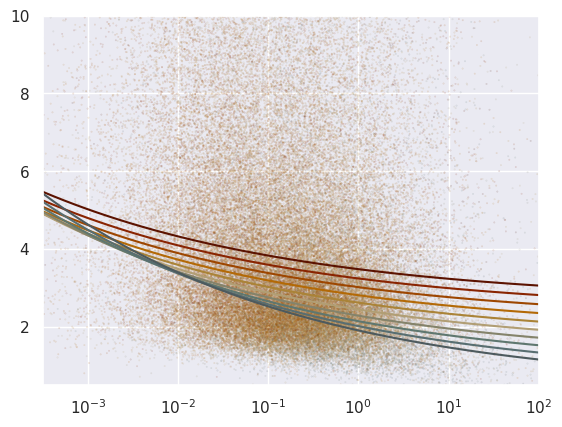

In [192]:
ss=.1
alph=.2
v='CO2'
num='6'
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
phi_s=d_stbl[v]['phi']
cc_s=cani_norm(d_stbl[v]['ani'][:])
plt.scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)

letters=['a','b','c','d']

vn=v+num
an=np.array((abin[0:-1]+abin[1:])/2)
for i in range(len(clrs)):
    pm=[]
    for x in range(len(degs[vn])):
        d=degs[vn][x]
        pp=0
        for j in range(d+1):
            pj=prms[vn][letters[x]][j]
            pp=pp+pj*an[i]**j
        pm.append(pp)
    if len(pm)==1:
        phi_plot=fxns_[vn](zL_plot,pm[0])
    elif len(pm)==2:
        phi_plot=fxns_[vn](zL_plot,pm[0],pm[1])
    elif len(pm)==3:
        phi_plot=fxns_[vn](zL_plot,pm[0],pm[1],pm[2])
    plt.semilogx(zL_plot,phi_plot,color=clrs[i])
plt.ylim(.5,10)
plt.xlim(10**-3.5,10**2)

(0.0001, 100)

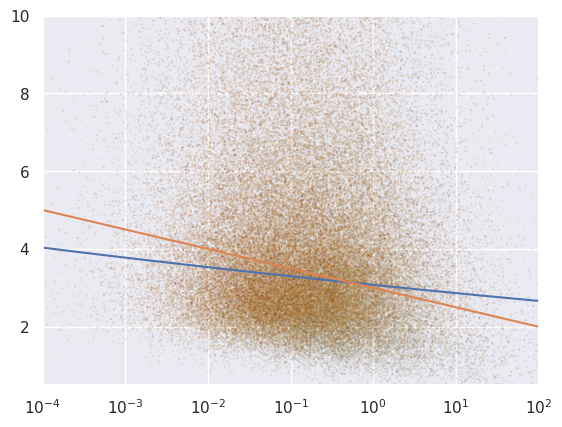

In [127]:
ss=.1
alph=.2
v='H2O'
num='3'
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
phi_s=d_stbl[v]['phi']
cc_s=cani_norm(d_stbl[v]['ani'][:])
plt.scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)

letters=['a','b','c','d']

vn=v+num
an=np.array((abin[0:-1]+abin[1:])/2)
plt.semilogx(zL_plot,Ctest(zL_plot,param[0],param[1],param[2]))
plt.semilogx(zL_plot,np.log10(zL_plot)*-.5+3)
#plt.semilogx(zL_plot,Ctest(zL_plot,3.5,-.1)-1)
#plt.semilogx(zL_plot,Ctest(zL_plot,3,-.1))
#plt.semilogx(zL_plot,Ctest(zL_plot,2.5,-.1)+1)
plt.ylim(.5,10)
plt.xlim(10**-4,10**2)

In [63]:
np.log10(.01)

-2.0

In [124]:
def Ctest(zL,a,b,c):
    return a*zL**b+c
    
p0=[2,-1/3,0]
bounds=([.01,-1,-5],[10,-.01,5])
m=(~np.isnan(phi_s))
phi_s=phi_s[m]
zL2=d_stbl[v]['zL'][m]

In [107]:
from scipy import optimize

In [125]:
param,pcov=optimize.curve_fit(Ctest,zL2,phi_s,p0,bounds=bounds,loss='cauchy')

In [126]:
param

array([ 4.30255103, -0.02183771, -1.22686968])

In [128]:
list(range(2,8))

[2, 3, 4, 5, 6, 7]

'H2O5':{'a':[-1.5543523880884509,43.16620958655561,-250.69778274067278,552.1368018570441,-390.2005743437812],'b':[7.3055971055254645,-67.38953544703286,352.47021390257044,-751.146870902566,522.6086926376627]},


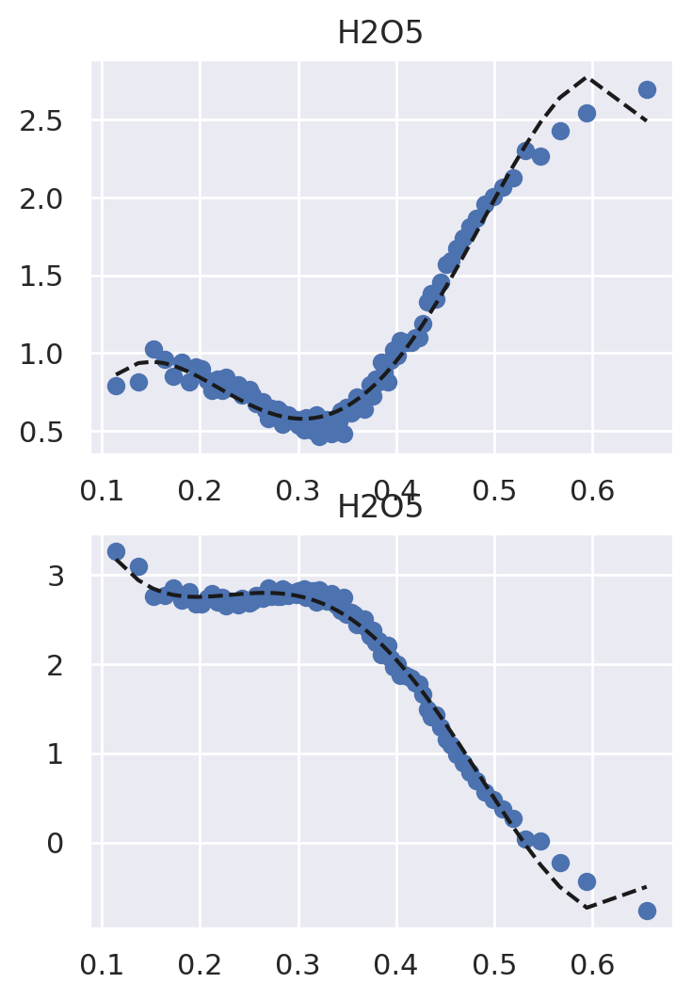

In [158]:
degs={'H2O5':[4,4]}

letters=['a','b','c','d']
for var in ['H2O5']:
    param=d_fit[var]['param']
    anibins=d_fit[var]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    m=~np.isnan(param[:,0])
    if var in maxs.keys():
        for mx in range(len(maxs[var])):
            m=m&(param[:,mx]<maxs[var][mx])
    x=anilvls[m]
    absz=anibins[1:]-anibins[0:-1]
    absz=absz[m]
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    print("'"+str(var)+"':{",end='')
    for i in range(len(pall)):
        y=param[:,i][m]
        c = P.polyfit(x,y,degs[var][i])
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls[m],param[:,i][m])
        if i>0:
            print(',',end='')
        print("'"+letters[i]+"':[",end='')
        for j in range(len(c)):
            print(str(c[j]),end='')
            if j<(len(c)-1):
                print(',',end='')
            else:
                print(']',end='')
        y2=c[0]+c[1]*x
        if degs[var][i]>1:
            y2=y2+c[2]*x**2
        if degs[var][i]>2:
            y2=y2+c[3]*x**3
        if degs[var][i]>3:
            y2=y2+c[4]*x**4
        plt.plot(x,y2,'k--')
        #plt.ylim(np.nanpercentile(param[:,i],1)*.9,np.nanpercentile(param[:,i],99))
        plt.title(var)
    print('},')

In [160]:
prms={'H2O5':{'a':[-1.5543523880884509,43.16620958655561,-250.69778274067278,552.1368018570441,-390.2005743437812],'b':[7.3055971055254645,-67.38953544703286,352.47021390257044,-751.146870902566,522.6086926376627]}}

(0.0001, 100)

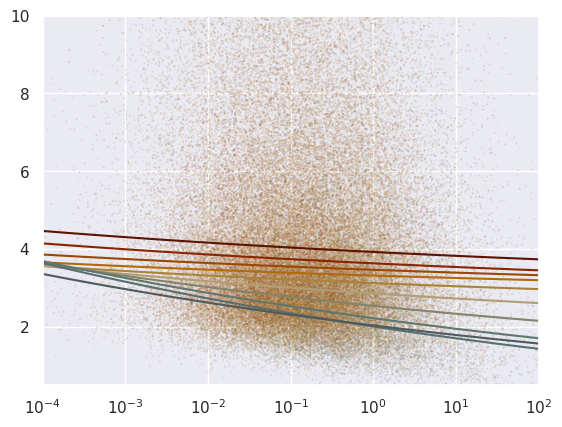

In [161]:
ss=.1
alph=.2
v='H2O'
num='5'
zL_plot=np.logspace(-4,2)
clrs=cani_norm(np.array((abin[0:-1]+abin[1:])/2))
phi_s=d_stbl[v]['phi']
cc_s=cani_norm(d_stbl[v]['ani'][:])
plt.scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)

letters=['a','b','c','d']

vn=v+num
an=np.array((abin[0:-1]+abin[1:])/2)
for i in range(len(clrs)):
    pm=[]
    for x in range(len(degs[vn])):
        d=degs[vn][x]
        pp=0
        for j in range(d+1):
            pj=prms[vn][letters[x]][j]
            pp=pp+pj*an[i]**j
        pm.append(pp)
    if len(pm)==1:
        phi_plot=fxns_[vn](zL_plot,pm[0])
    elif len(pm)==2:
        phi_plot=fxns_[vn](zL_plot,pm[0],pm[1])
    elif len(pm)==3:
        phi_plot=fxns_[vn](zL_plot,pm[0],pm[1],pm[2])
    elif len(pm)==4:
        phi_plot=fxns_[vn](zL_plot,pm[0],pm[1],pm[2],pm[3])
    plt.semilogx(zL_plot,phi_plot,color=clrs[i])
plt.ylim(.5,10)
plt.xlim(10**-4,10**2)

'T2':{'a':[0.0016086400426415747,-0.009046112626421346,0.01674919857041958],'b':[3.1069569610314867,-2.721337687613489]},


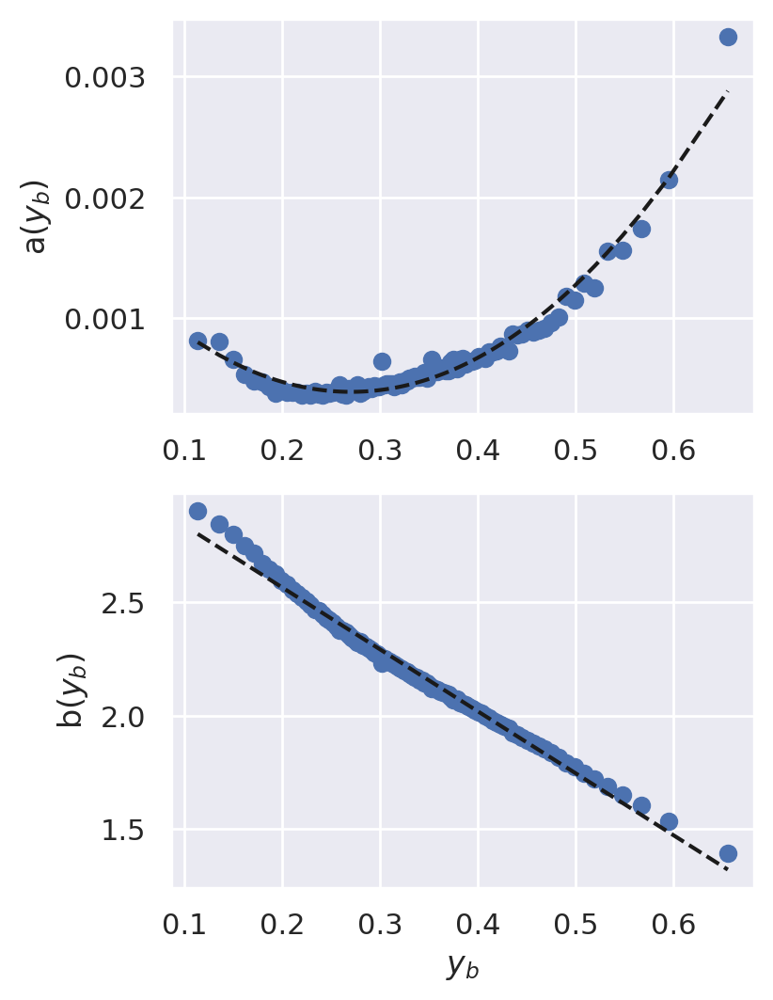

In [196]:
letters=['a','b','c','d']
for var in ['T2']:
    param=d_fit[var]['param']
    anibins=d_fit[var]['anibins']
    anilvls=(anibins[1:]+anibins[0:-1])/2
    pall=np.nanmean(param,axis=0)
    m=~np.isnan(param[:,0])
    if var in maxs.keys():
        for mx in range(len(maxs[var])):
            m=m&(param[:,mx]<maxs[var][mx])
    x=anilvls[m]
    absz=anibins[1:]-anibins[0:-1]
    absz=absz[m]
    plt.figure(figsize=(4,3*len(pall)),dpi=200)
    print("'"+str(var)+"':{",end='')
    for i in range(len(pall)):
        y=param[:,i][m]
        c = P.polyfit(x,y,degs[var][i])
        plt.subplot(len(pall),1,i+1)
        plt.scatter(anilvls[m],param[:,i][m])
        if i>0:
            print(',',end='')
        print("'"+letters[i]+"':[",end='')
        for j in range(len(c)):
            print(str(c[j]),end='')
            if j<(len(c)-1):
                print(',',end='')
            else:
                print(']',end='')
        y2=c[0]+c[1]*x
        if degs[var][i]>1:
            y2=y2+c[2]*x**2
        if degs[var][i]>2:
            y2=y2+c[3]*x**3
        if degs[var][i]>3:
            y2=y2+c[4]*x**4
        plt.plot(x,y2,'k--')
        #plt.ylim(np.nanpercentile(param[:,i],1)*.9,np.nanpercentile(param[:,i],99))
        plt.ylabel(letters[i]+'($y_b$)')
        if i>0:
            plt.xlabel(r'$y_b$')
    plt.subplots_adjust(hspace=.2)
    print('},')

In [ ]:
'T2':{'a':[0.0016086400426415747,-0.009046112626421346,0.01674919857041958],'b':[3.1069569610314867,-2.721337687613489]},
'T3':{'a':[3.817709220055608,-7.473760573874225,10.68634838019546,-7.025544971110323],'b':[0.02447044229928632,-0.14745178845621343,0.42535783717801423,-0.3239796865035902]},
'T4':{'a':[0.014058713018066155,-0.06846731062292509,0.13165525017433005],'b':[3.04131851476864,-2.719792181824897]},
'T5':{'a':[0.0027252543145951896,0.007027843331210413,-0.09196590181888623,0.2007361171500964],'b':[-1.1780935040635225,-0.08447995241669148,0.5614236224538129,-0.037235841944141534],'c':[3.4996684250079277,-6.108768265650669,8.098673174827468,-5.931630938506805]},
'T6':{'a':[0.4976992048433562,-2.928653210710675,6.925549603692723,-4.14831462620025],'b':[2.9179364060632915,-2.94339427218065]},
'T7':{'a':[3.839115631186413,-7.649826422085375,11.027420453875179,-7.042463168602552],'b':[0.14869411390544263,-1.1222215055483538,3.0368093230353854,-2.089468545484071]},
'H2O2':{'a':[4.4715024138701205,-3.4837301794203026],'b':[0.01210089094033287,-0.07568044147521406,0.0885267494534989,0.7224095404252947,-1.0115298405833557]},
'H2O3':{'a':[4.509159591557627,-4.479272837210766,4.3511657156262,-4.693451722618339],'b':[0.37607677898539743,-3.4948560497532375,9.039634622417152,-5.128947074865075],'c':[1.2454812247221345,-18.348719604746194,52.49222280913729,-42.87422835362976]},
'H2O4':{'a':[4.510474177607806,-3.690333539066831]},
'H2O5':{'a':[-0.00018239280292816124,0.0027092262789102694,-0.010668487858307155,0.012755102659479184],'b':[4.356751745391893,-3.2495297068255544,1.411483975413329,-3.467998055015781]},
'CO22':{'a':[99.99999999999969,1.6746580498899245e-12,-4.110478577267167e-12,3.2741920424242564e-12],'b':[-9.668563987548445e-17,1.1028994146142744e-15,-3.089846771928226e-15,2.534331913632339e-15]},
'CO23':{'a':[499.99999999997897,9.925372144008048e-12,2.40303102281431e-11,-1.789650747790153e-11],'b':[-1.6415000891271577e-11,2.3687957866166365e-10,-7.154648526084222e-10,6.094206788292886e-10],'c':[-0.19999999499298377,-9.590326479948412e-08,2.7704461474536396e-07,-2.2113624335238422e-07]},
'CO24':{'a':[9.999999992114589,9.662101866828152e-09,-6.524216014450997e-09,5.711342806758071e-09]},
'CO25':{'a':[11.60784036359944,-33.839482594753946,92.0482873145598,-75.00714126429136],'b':[111.4434376801427,-422.96713148124434,1113.6463690757507,-875.6118725211406]},